In [1]:
%load_ext autoreload
%autoreload 2
%matplotlib inline
%config InlineBackend.figure_format='retina'

In [2]:
import numpy as np
import pandas as pd
import time
import itertools
from datetime import datetime
from pymongo import MongoClient

from src.config_tickets import ticket_lst
from src.scraping import WebScraping
from src.settings import HOST
from src.query_data import QueryData
from src.utilities import run_model_with_parameters, run_model_without_parameters

import sys

if not sys.warnoptions:
    import warnings
    warnings.simplefilter("ignore")

Using TensorFlow backend.


In [3]:
import statsmodels.api as sm
import statsmodels.formula.api as smf
import statsmodels.tsa.api as smt
from statsmodels.tsa.arima_model import ARIMA
from statsmodels.tsa.stattools import adfuller
from sklearn.metrics import mean_squared_error, mean_absolute_error

# Display and Plotting
import matplotlib.pylab as plt
import seaborn as sns

from ipywidgets import interactive, widgets, RadioButtons, ToggleButton, Select, FloatSlider, FloatRangeSlider, IntSlider, fixed

pd.set_option('display.float_format', lambda x: '%.5f' % x) # pandas
np.set_printoptions(precision=5, suppress=True) # numpy

pd.set_option('display.max_columns', 100)
pd.set_option('display.max_rows', 100)

# seaborn plotting style
sns.set(style='ticks', context='poster')

In [4]:
def connect_2_dbServer():
    mongoClient = MongoClient(HOST)
    return mongoClient
client = connect_2_dbServer()
query = QueryData(client)

In [5]:
def gen_order(p, d, q):
    return list(itertools.product(p, d, q))

def gen_ann(lags, hl):
    hl1 = hl
    hl2 = [int(i / 2) for i in hl]
    return list(itertools.product(lags, hl1, hl2))

def mean_absolute_percentage_error(y_true, y_pred):
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100


def root_mean_squared_error(y_true, y_pred):
    return np.sqrt(np.mean((y_true - y_pred) ** 2))

def evaluation(validation):
    mse = mean_squared_error(validation['y'], validation['yhat'])
    rmse = root_mean_squared_error(validation['y'], validation['yhat'])
    mae = mean_absolute_error(validation['y'], validation['yhat'])
    mape = mean_absolute_percentage_error(validation['y'], validation['yhat'])
    result = {
        'mse': mse,
        'rmse': rmse,
        'mae': mae,
        'mape': mape,
    }
    return result

In [6]:
start = datetime(2015,1,1)
end = datetime(2019,1,1)

lst_ticket = query.get_list_ticket(index='VN 30 (VNI30)')
print(len(lst_ticket))
df = query.get_historical_data(lst_ticket, start=start)
lst_company = []
for ticket in lst_ticket:
    df_ticket = df[df.name == ticket]
    symbol = df_ticket['ticket'].drop_duplicates().values[0]
    name = df_ticket['name'].drop_duplicates().values[0]
    lst_company.append({'symbol': symbol, 'name': name})
df_company = pd.DataFrame(lst_company)
df_company = df_company.set_index('name')
df_company

30


,symbol
name,
Cotec Construction JSC,CTD
DHG Pharmaceutical JSC,DHG
Faros Construction Corp,ROS
FPT Corp,FPT
Gemadept Corp,GMD
Ho Chi Minh City Infrastructure Investment JSC,CII
Ho Chi Minh City Development Joint Stock Commercial Bank,HDB
Hoa Phat Group JSC,HPG
Masan Group Corp,MSN


In [61]:
df_mae = pd.read_csv('mae.csv')
df_mse = pd.read_csv('mse.csv')
df_mape = pd.read_csv('mape.csv')
df_rmse = pd.read_csv('rmse.csv')
df_mae

,name,hybrid_order,hybrid_lags,hybrid_hl,hybrid,arima_order,arima,ann_lags,ann_hl,ann,lstm_gbm,gbm
0,Cotec Construction JSC,"(1, 0, 0)",2,"(5, 2)",1539.87592,"(1, 0, 0)",1566.10771,1,"(7, 3)",2189.91708,1993.15358,2083.47789
1,DHG Pharmaceutical JSC,"(1, 0, 0)",1,"(4, 2)",828.83069,"(1, 0, 0)",842.90478,1,"(6, 3)",826.61465,1247.94095,1131.67465
2,Faros Construction Corp,"(1, 0, 0)",2,"(3, 2)",554.81158,"(1, 0, 0)",487.39248,1,"(4, 3)",495.38750,548.41992,566.43586
3,FPT Corp,"(2, 1, 3)",1,"(5, 1)",372.12604,"(2, 1, 3)",374.88086,2,"(7, 3)",491.98339,495.30598,509.06203
4,Gemadept Corp,"(3, 0, 1)",1,"(4, 3)",257.47524,"(3, 0, 1)",213.70672,2,"(5, 1)",235.37330,255.01121,264.59097
5,Ho Chi Minh City Infrastructure Investment JSC,"(3, 1, 1)",2,"(6, 1)",272.13356,"(3, 1, 1)",264.89355,2,"(7, 3)",238.76999,298.99088,378.03052
6,Ho Chi Minh City Development Joint Stock Comme...,"(3, 0, 3)",1,"(6, 1)",336.94210,"(3, 0, 3)",323.15049,1,"(6, 3)",318.13141,399.57171,448.07781
7,Hoa Phat Group JSC,"(2, 0, 3)",1,"(7, 1)",313.74105,"(2, 0, 3)",306.05785,2,"(5, 1)",336.75635,446.04473,369.64341
8,Masan Group Corp,"(1, 1, 0)",2,"(6, 1)",939.04766,"(1, 1, 0)",799.79158,1,"(6, 3)",797.28407,955.48928,1103.74238
9,Military Commercial Joint Stock Bank,"(1, 0, 0)",3,"(7, 1)",176.12078,"(1, 0, 0)",171.18171,1,"(7, 3)",180.78613,270.60099,225.45073


In [62]:
lst_model = ['name', 'hybrid', 'arima', 'ann', 'lstm_gbm', 'gbm']
df_short_mape = df_mape[lst_model].round(3)
df_short_mse = df_mse[lst_model].round(3)
df_short_mae = df_mae[lst_model].round(3)
df_short_rmse = df_rmse[lst_model].round(3)

df_short_rmse = df_short_rmse.set_index('name')
df_short_mse = df_short_mse.set_index('name')
df_short_mae = df_short_mae.set_index('name')
df_short_mape = df_short_mape.set_index('name')

df_short_mape['symbol'] = df_company['symbol']
df_short_mse['symbol'] = df_company['symbol']
df_short_mae['symbol'] = df_company['symbol']
df_short_rmse['symbol'] = df_company['symbol']

df_short_rmse = df_short_rmse.reset_index()
df_short_mse = df_short_mse.reset_index()
df_short_mae = df_short_mae.reset_index()
df_short_mape = df_short_mape.reset_index()

df_short_rmse = df_short_rmse.drop('name', axis=1)
df_short_mse = df_short_mse.drop('name', axis=1)
df_short_mae = df_short_mae.drop('name', axis=1)
df_short_mape = df_short_mape.drop('name', axis=1)
                                          
df_short_rmse = df_short_rmse.set_index('symbol')
df_short_mse = df_short_mse.set_index('symbol')
df_short_mae = df_short_mae.set_index('symbol')
df_short_mape = df_short_mape.set_index('symbol')

In [63]:
df_short_mape.to_csv('short_mape.csv', index=True)
df_short_mse.to_csv('short_mse.csv', index=True)
df_short_mae.to_csv('short_mae.csv', index=True)
df_short_rmse.to_csv('short_rmse.csv', index=True)

In [7]:
start_train = 0.8
end_train = 0.95

In [8]:
def plot_acf_pacf(time_series, name):    
    fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(15, 8))
    fig = sm.graphics.tsa.plot_acf(time_series, lags=30, ax=ax)
    ax.xaxis.set_ticks_position('bottom')
    plt.title(name)
    fig.tight_layout();
    
    fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(15, 8))
    fig = sm.graphics.tsa.plot_pacf(time_series, lags=30, ax=ax)
    ax.xaxis.set_ticks_position('bottom')
    plt.title(name)
    fig.tight_layout();

Cotec Construction JSC
adf: -1.258276
p-value: 0.648038
usedlag: 0.000000
nobs: 162.000000
critical values: 
 {'1%': -3.471374345647024, '5%': -2.8795521079291966, '10%': -2.5763733302850174}
adf: -11.275090
p-value: 0.000000
usedlag: 0.000000
nobs: 162.000000
critical values: 
 {'1%': -3.471374345647024, '5%': -2.8795521079291966, '10%': -2.5763733302850174}
DHG Pharmaceutical JSC
adf: -1.491635
p-value: 0.537645
usedlag: 7.000000
nobs: 156.000000
critical values: 
 {'1%': -3.4729792729247793, '5%': -2.8802520918255534, '10%': -2.5767469641683105}
adf: -2.437278
p-value: 0.131490
usedlag: 6.000000
nobs: 156.000000
critical values: 
 {'1%': -3.4729792729247793, '5%': -2.8802520918255534, '10%': -2.5767469641683105}
Faros Construction Corp
adf: -2.232476
p-value: 0.194670
usedlag: 1.000000
nobs: 100.000000
critical values: 
 {'1%': -3.497501033, '5%': -2.89090644, '10%': -2.5824349}
adf: -8.375441
p-value: 0.000000
usedlag: 0.000000
nobs: 101.000000
critical values: 
 {'1%': -3.49681816

adf: -1.181963
p-value: 0.681306
usedlag: 0.000000
nobs: 163.000000
critical values: 
 {'1%': -3.471118535474365, '5%': -2.8794405060097024, '10%': -2.576313761526591}
adf: -12.424058
p-value: 0.000000
usedlag: 0.000000
nobs: 162.000000
critical values: 
 {'1%': -3.471374345647024, '5%': -2.8795521079291966, '10%': -2.5763733302850174}
Vietnam Prosperity Joint Stock Commercial Bank
adf: -1.728871
p-value: 0.416302
usedlag: 0.000000
nobs: 65.000000
critical values: 
 {'1%': -3.5352168748293127, '5%': -2.9071540828402367, '10%': -2.5911025443786984}
adf: -9.325860
p-value: 0.000000
usedlag: 0.000000
nobs: 65.000000
critical values: 
 {'1%': -3.5352168748293127, '5%': -2.9071540828402367, '10%': -2.5911025443786984}
Vietnam Dairy Products JSC
adf: -2.706415
p-value: 0.072935
usedlag: 5.000000
nobs: 158.000000
critical values: 
 {'1%': -3.4724305215713156, '5%': -2.8800127935315465, '10%': -2.576619230892485}
adf: -4.265972
p-value: 0.000509
usedlag: 5.000000
nobs: 157.000000
critical valu

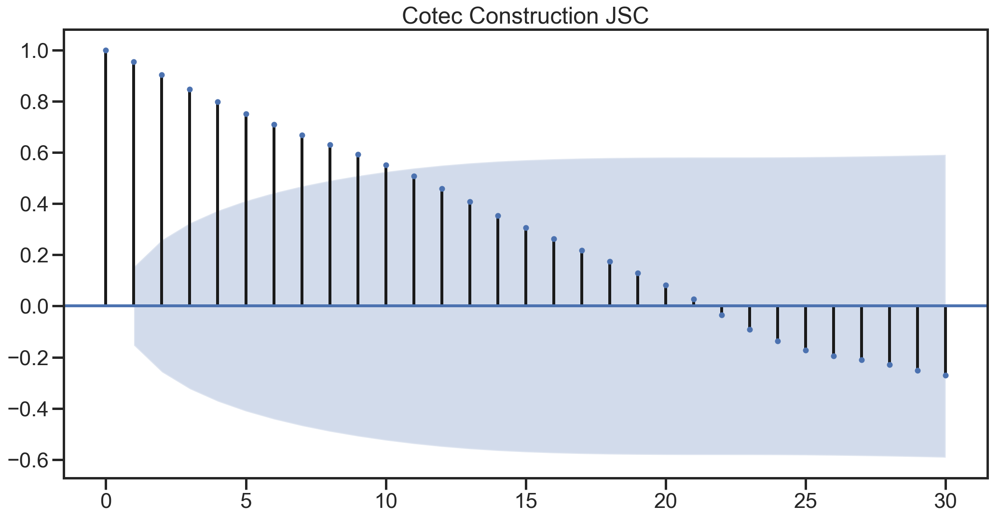

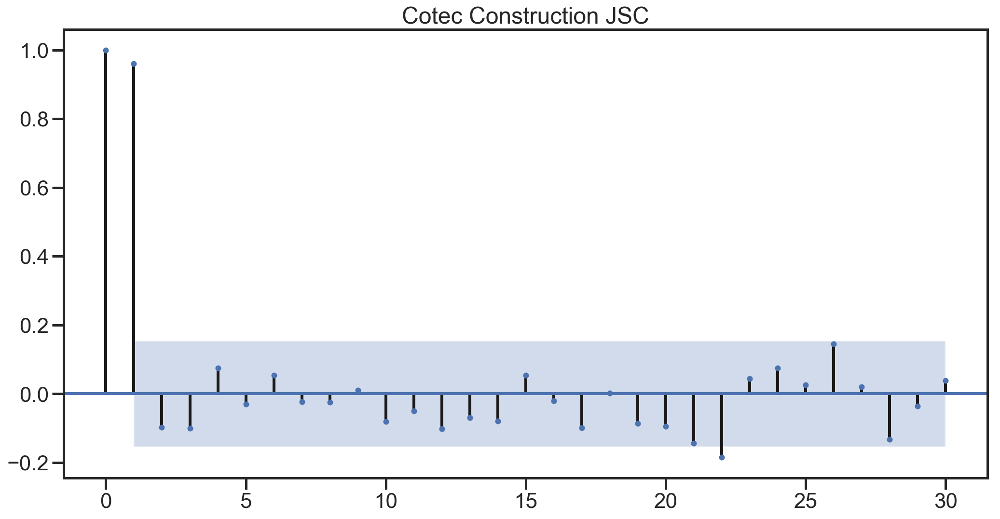

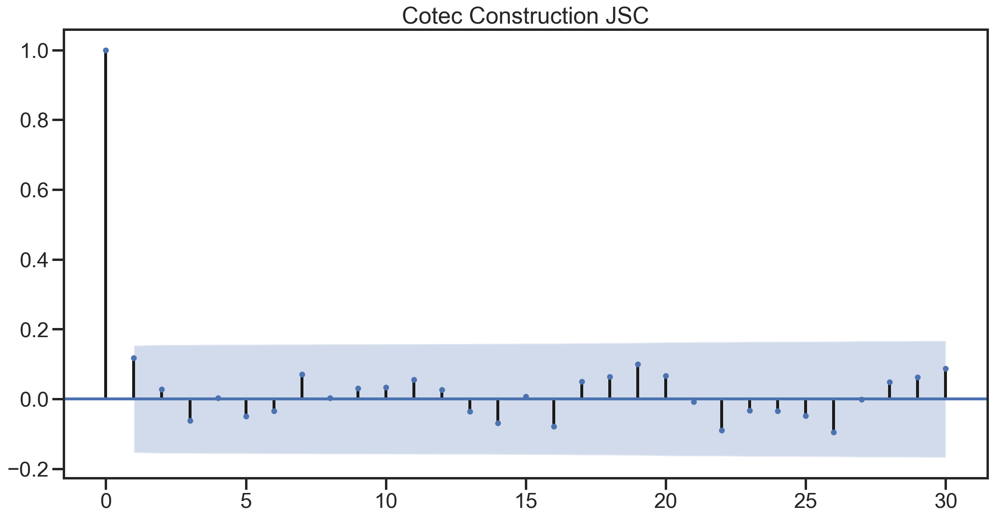

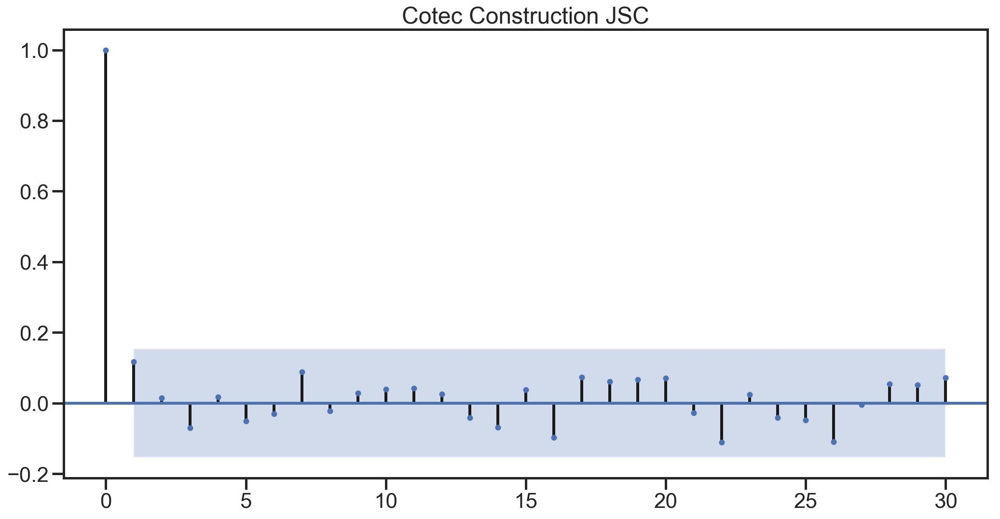

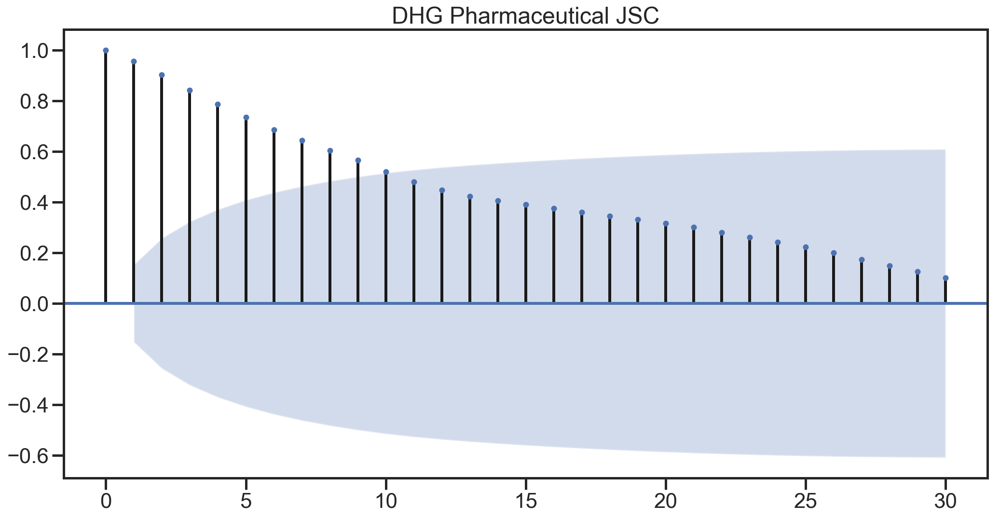

...

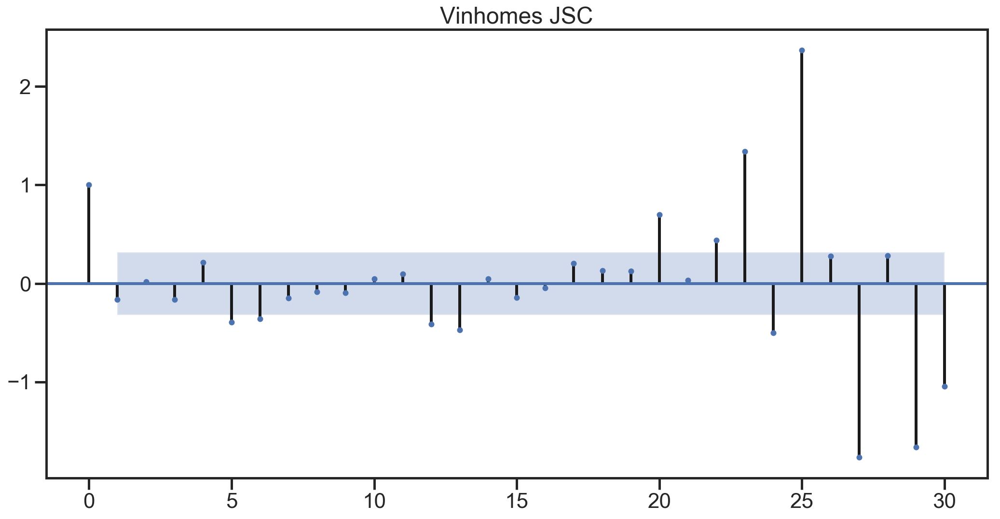

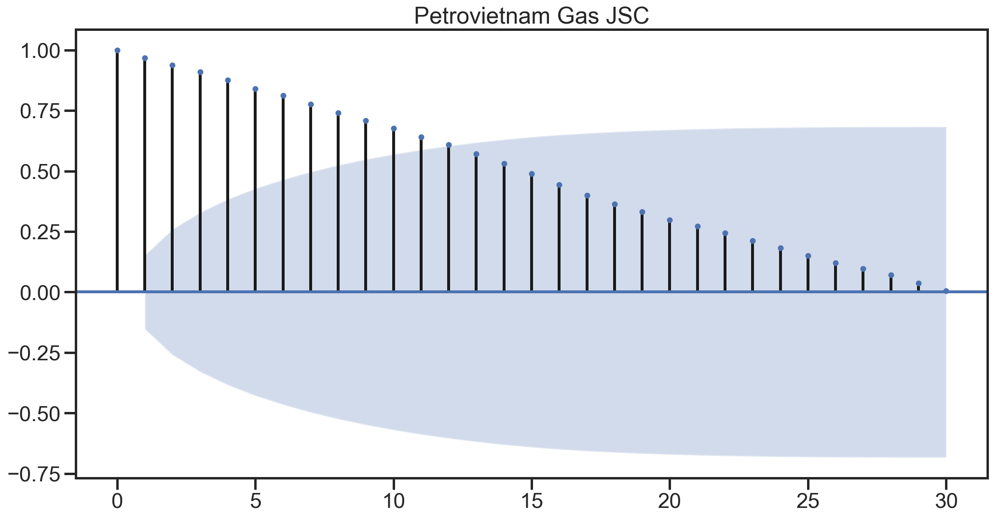

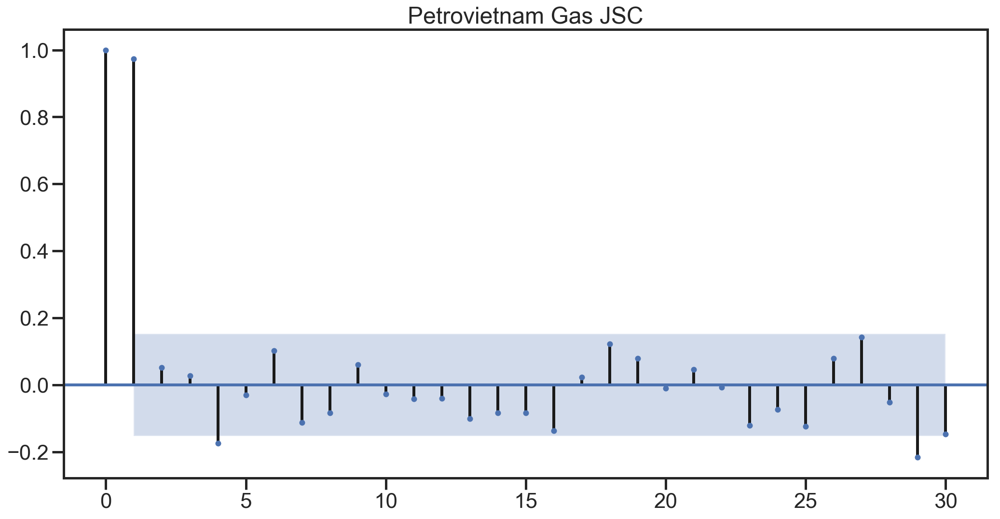

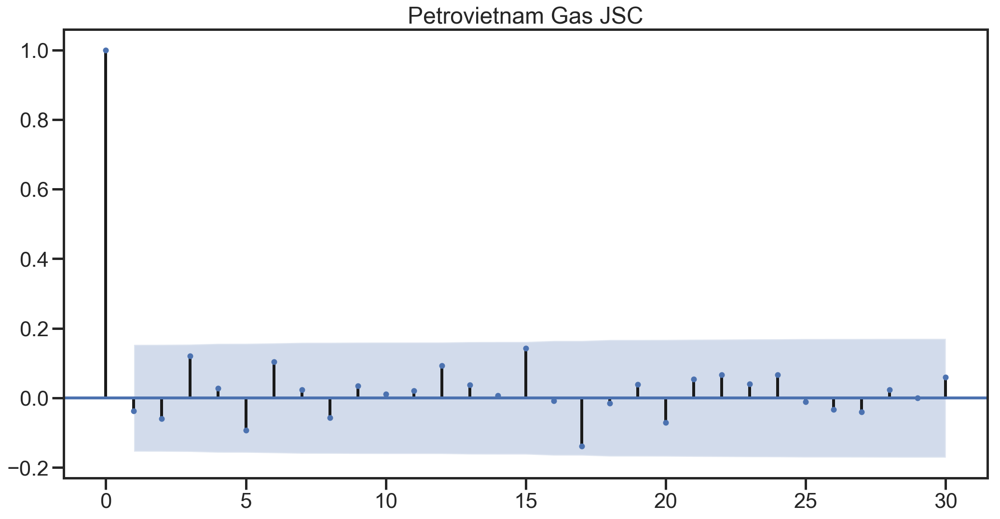

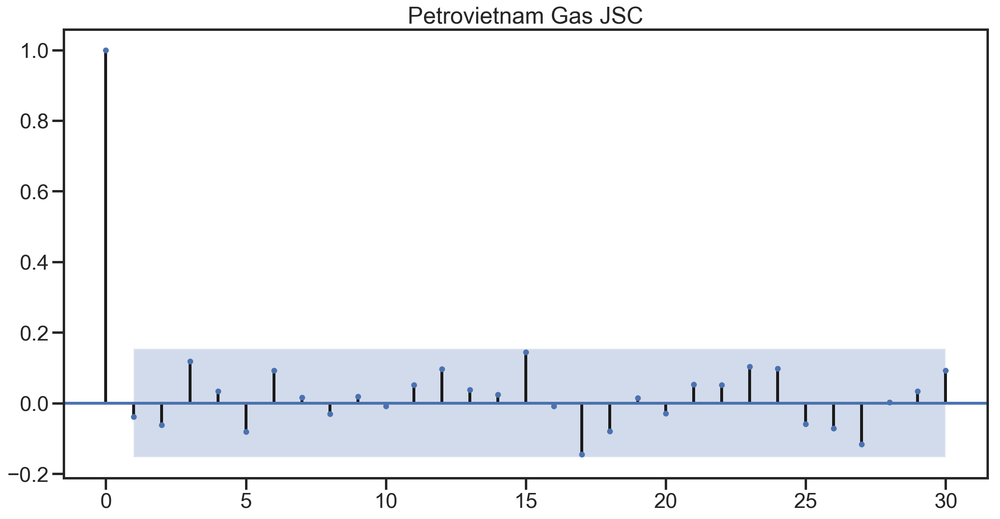

In [12]:
# split data
for ticket in df_company.symbol:
    series = df[df.ticket == ticket]['close']

    series_log_diff = np.log(series).diff()[1:]
    name = df[df.ticket == ticket].name[0]
    print(name)

    series = series.sort_index()
    size = len(series)
    train_start = int(start_train * size)
    train_end = int(end_train * size)
    train, test = series[train_start:train_end], series[train_end:]

    plot_acf_pacf(train, name)
    
    result = adfuller(train.values)
    print('adf: %f' % result[0])
    print('p-value: %f' % result[1])
    print('usedlag: %f' % result[2])
    print('nobs: %f' % result[3])
    print('critical values: \n',result[4])

    # split data
    series_log_diff = series_log_diff.sort_index()
    size = len(series_log_diff)
    train_start = int(start_train * size)
    train_end = int(end_train * size)
    train_log_diff, test_log_diff = series_log_diff[train_start:train_end], series_log_diff[train_end:]

    plot_acf_pacf(train_log_diff, name)
    
    result = adfuller(train_log_diff.values)
    print('adf: %f' % result[0])
    print('p-value: %f' % result[1])
    print('usedlag: %f' % result[2])
    print('nobs: %f' % result[3])
    print('critical values: \n',result[4])

In [9]:
def _plot_acf_pacf(time_series):    
    fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(15, 8))
    fig = sm.graphics.tsa.plot_acf(time_series, lags=30, ax=ax)
    ax.xaxis.set_ticks_position('bottom')
    fig.tight_layout();
    
    fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(15, 8))
    fig = sm.graphics.tsa.plot_pacf(time_series, lags=30, ax=ax)
    ax.xaxis.set_ticks_position('bottom')
    fig.tight_layout();

PetroVietnam Fertilizer and Chemicals Corp
adf: -1.622830
p-value: 0.471246
usedlag: 0.000000
nobs: 163.000000
critical values: 
 {'1%': -3.471118535474365, '5%': -2.8794405060097024, '10%': -2.576313761526591}
adf: -14.008185
p-value: 0.000000
usedlag: 0.000000
nobs: 162.000000
critical values: 
 {'1%': -3.471374345647024, '5%': -2.8795521079291966, '10%': -2.5763733302850174}


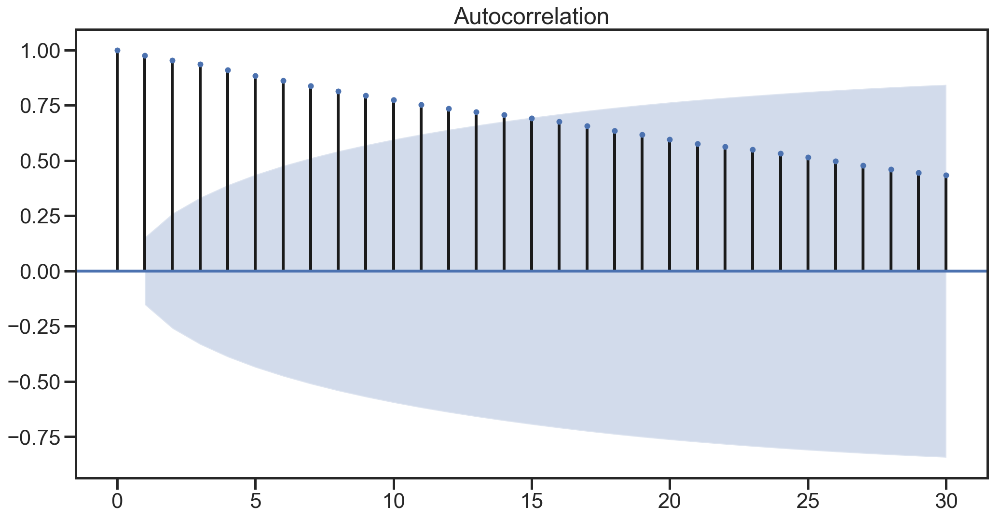

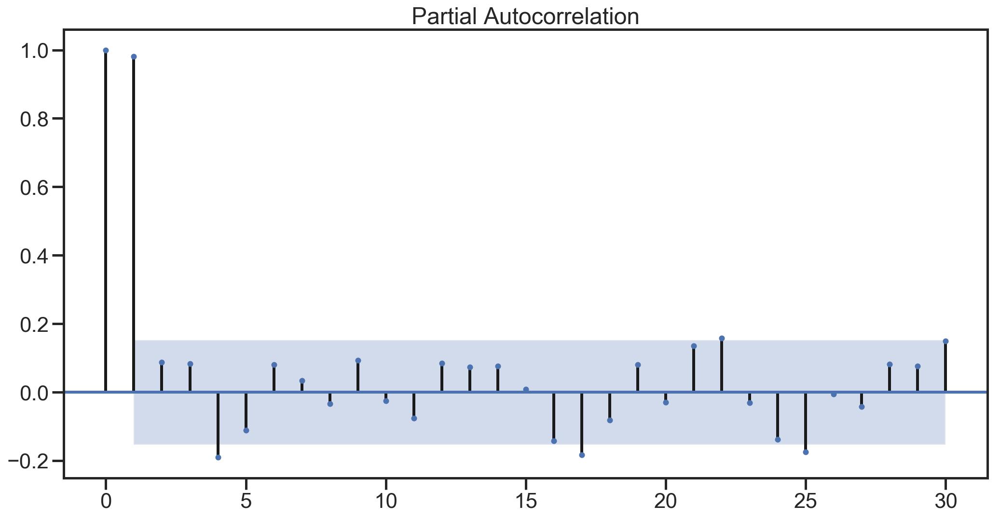

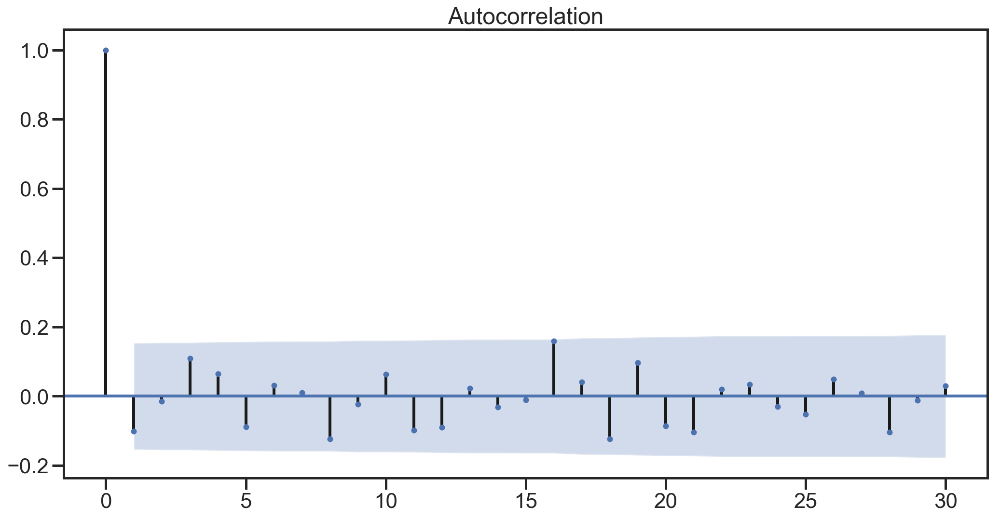

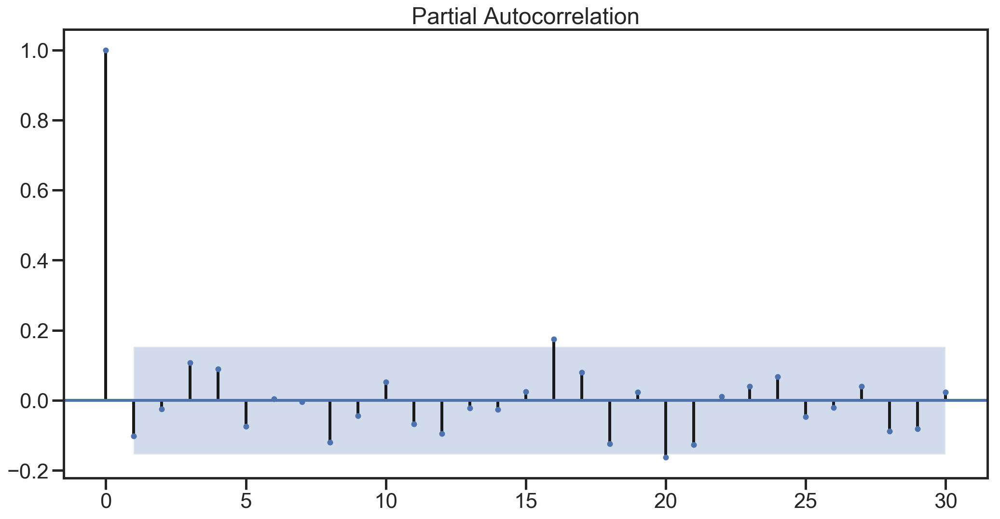

In [10]:
ticket = 'DPM'

series = df[df.ticket == ticket]['close']

series_log_diff = np.log(series).diff()[1:]
name = df[df.ticket == ticket].name[0]
print(name)

series = series.sort_index()
size = len(series)
train_start = int(start_train * size)
train_end = int(end_train * size)
train, test = series[train_start:train_end], series[train_end:]

_plot_acf_pacf(train)

result = adfuller(train.values)
print('adf: %f' % result[0])
print('p-value: %f' % result[1])
print('usedlag: %f' % result[2])
print('nobs: %f' % result[3])
print('critical values: \n',result[4])

# split data
series_log_diff = series_log_diff.sort_index()
size = len(series_log_diff)
train_start = int(start_train * size)
train_end = int(end_train * size)
train_log_diff, test_log_diff = series_log_diff[train_start:train_end], series_log_diff[train_end:]

_plot_acf_pacf(train_log_diff)

result = adfuller(train_log_diff.values)
print('adf: %f' % result[0])
print('p-value: %f' % result[1])
print('usedlag: %f' % result[2])
print('nobs: %f' % result[3])
print('critical values: \n',result[4])

(0, 1, 0)
Testing result: {'mse': 89909.09090909091, 'rmse': 299.8484465677468, 'mae': 227.27272727272728, 'mape': 1.2158120316884142, 'order': (0, 1, 0)}


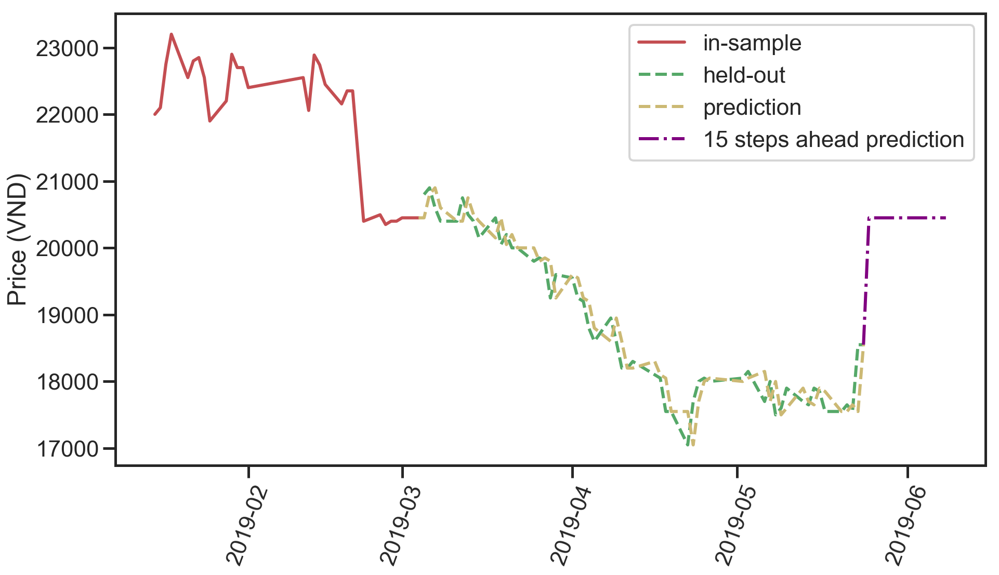

(16, 1, 0)
Testing result: {'mse': 87572.40485478562, 'rmse': 295.9263503893927, 'mae': 224.74888506321605, 'mape': 1.2055274463351728, 'order': (16, 1, 0)}


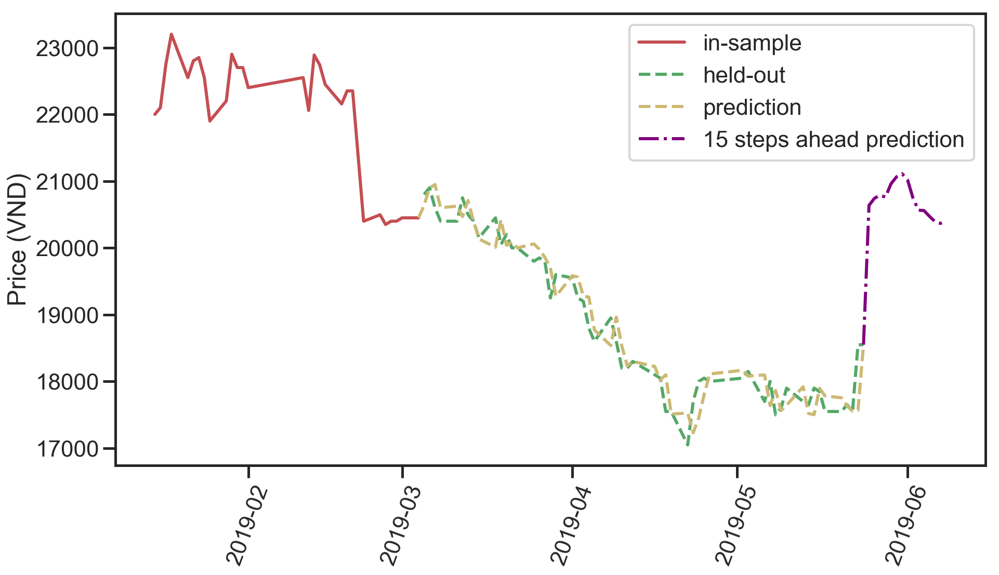

(20, 1, 0)
Testing result: {'mse': 90135.75278854124, 'rmse': 300.2261693932447, 'mae': 237.2767023413692, 'mape': 1.270197484534208, 'order': (20, 1, 0)}


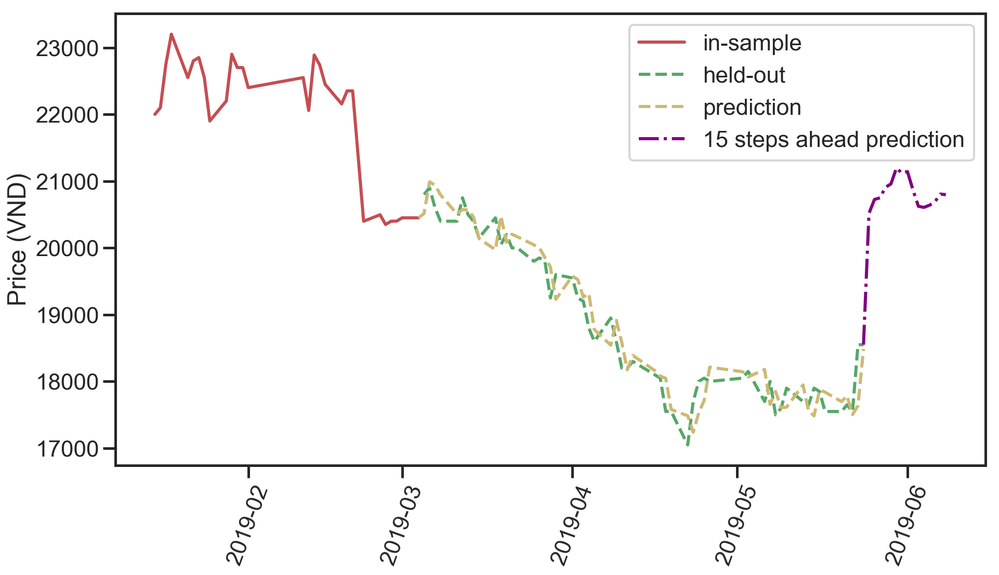

In [23]:
p = [0,16,20]
d = [1]
q = [0]
lst_order = gen_order(p,d,q)
lst_result = []
for order in lst_order:
    print(order)
    result = run_model_with_parameters(train, test, model_selection='ARIMA', order=order)
    time.sleep(1)
    if result['status']:
        _result = result['test_evaluation']
        _result['order'] = order
        lst_result.append(_result)
        print('Testing result:', result['test_evaluation'])
        validation = result['model'].validate(test)
        predict_ahead = result['model'].predict_multi_step_ahead(start=test.index[-1], steps=15)
        fig, ax1 = plt.subplots(nrows=1, ncols=1, figsize=(15, 8))
        ax1.plot(train[-30:], label='in-sample', color='r', linestyle='-')
        ax1.plot(test, label='held-out', color='g', linestyle='--')
        ax1.plot(validation, label='predicted held-out', color='y', linestyle='--')
        ax1.plot(predict_ahead, label='15 steps ahead prediction', color='purple', linestyle='-.')
        plt.xticks(rotation=70)
        plt.ylabel('Price (VND)')
        plt.legend(['in-sample','held-out', 'prediction', '15 steps ahead prediction'])
#         plt.title('Model evaluation of ' + ticket)
        plt.show()
    else:
        print('None')

In [24]:
df_result = pd.DataFrame(data=lst_result)
df_result = df_result.set_index('order')
lst_metric = ['mae','mape','mse','rmse']
df_result = df_result[lst_metric].round(3)
df_result.to_csv('dpm_arima_result.csv', index=True)
df_result

,mae,mape,mse,rmse
order,,,,
"(0, 1, 0)",227.27300,1.21600,89909.09100,299.84800
"(16, 1, 0)",224.74900,1.20600,87572.40500,295.92600
"(20, 1, 0)",237.27700,1.27000,90135.75300,300.22600


## ANN

DPM
(1, 3, 1)
Testing result: {'mse': 1365208.3398923462, 'rmse': 1168.421302395821, 'mae': 1072.4475418980928, 'mape': 5.756970659097583, 'lags': 1, 'hidden layers': (3, 1)}


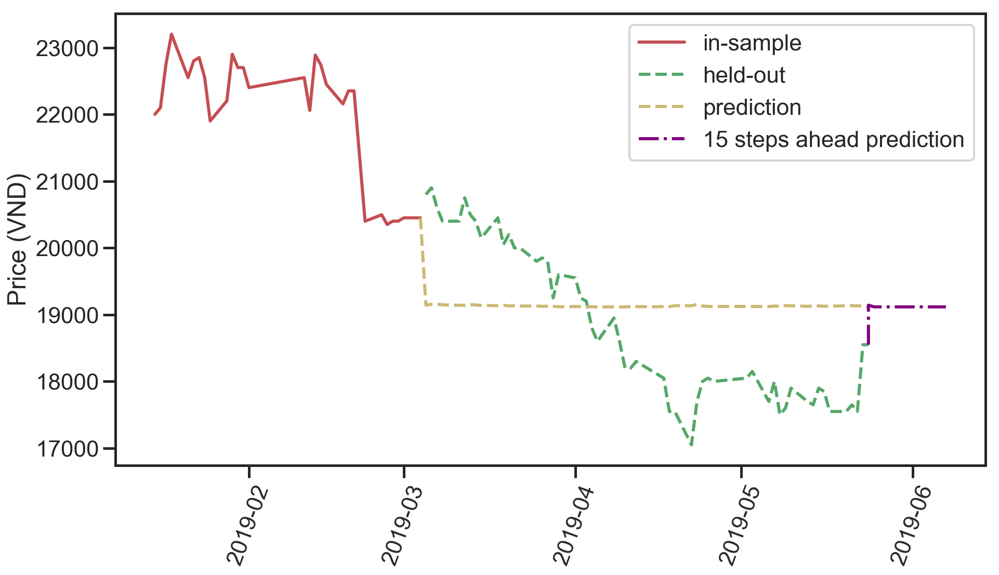

(1, 3, 2)
Testing result: {'mse': 674963.8029215356, 'rmse': 821.5618071219812, 'mae': 733.3617425510074, 'mape': 3.8777071963765777, 'lags': 1, 'hidden layers': (3, 2)}


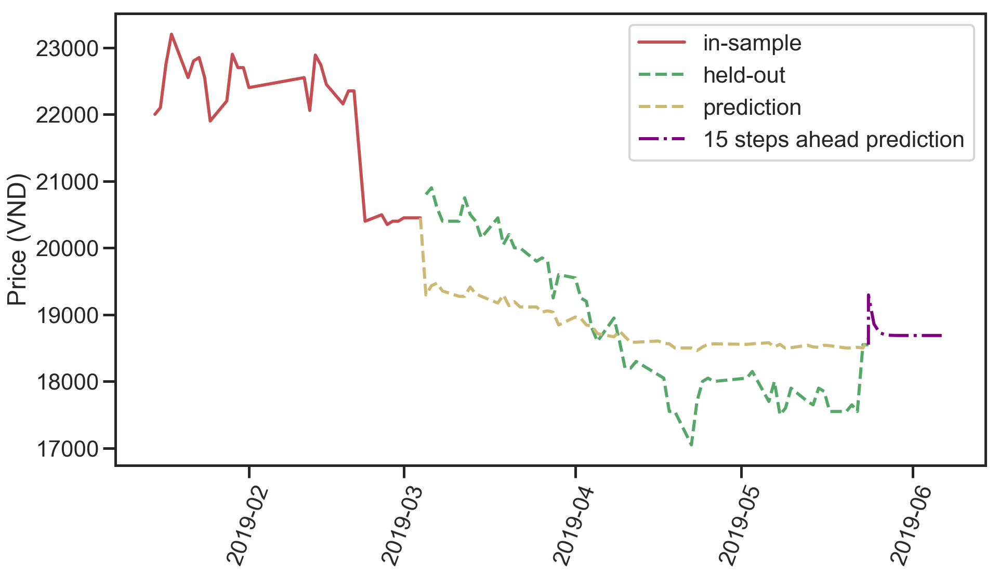

(1, 3, 2)
Testing result: {'mse': 674963.8029215356, 'rmse': 821.5618071219812, 'mae': 733.3617425510074, 'mape': 3.8777071963765777, 'lags': 1, 'hidden layers': (3, 2)}


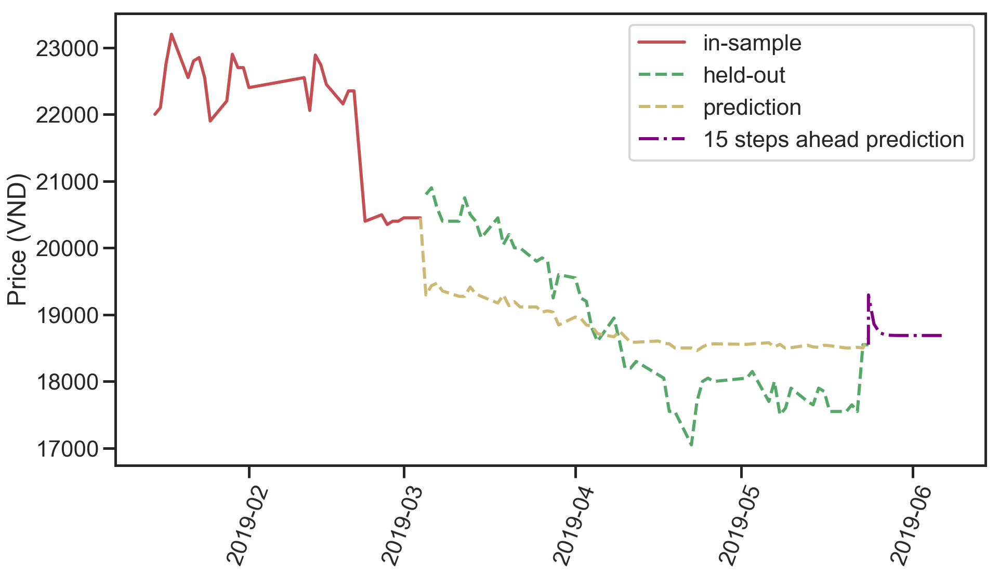

(1, 3, 3)
Testing result: {'mse': 282118.6235649284, 'rmse': 531.1484006988334, 'mae': 457.27740081503714, 'mape': 2.4867015212762027, 'lags': 1, 'hidden layers': (3, 3)}


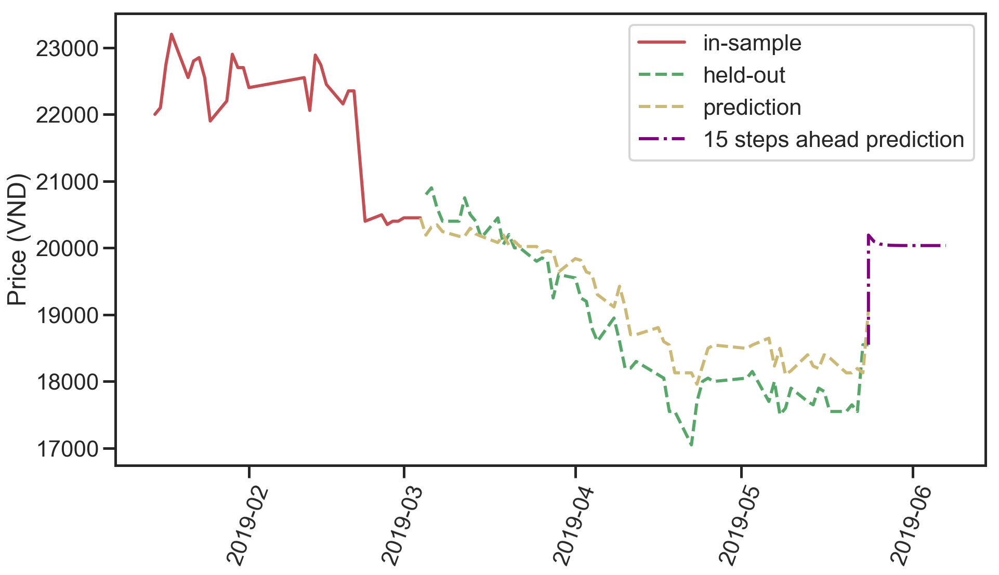

(1, 3, 3)
Testing result: {'mse': 282118.6235649284, 'rmse': 531.1484006988334, 'mae': 457.27740081503714, 'mape': 2.4867015212762027, 'lags': 1, 'hidden layers': (3, 3)}


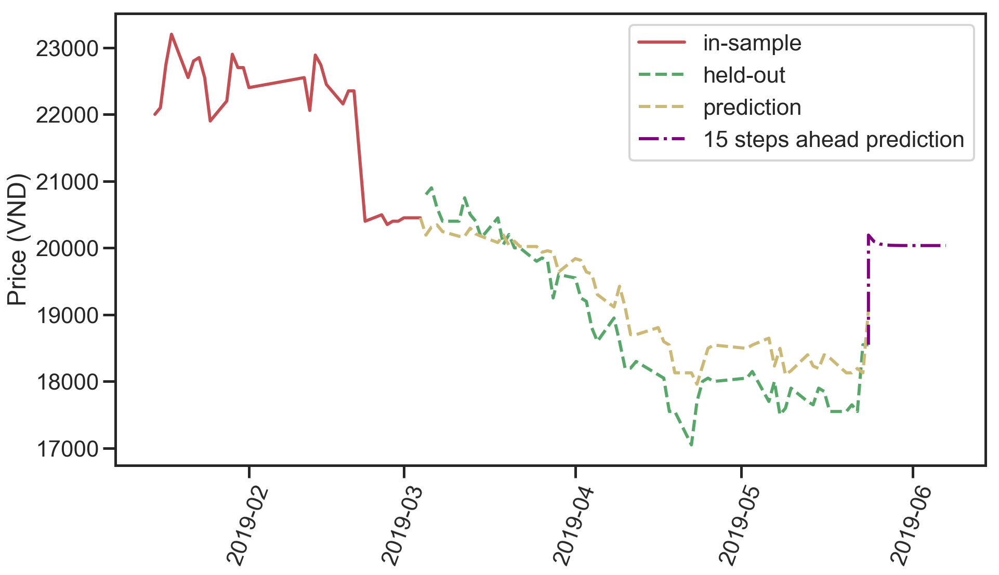

(1, 4, 1)
Testing result: {'mse': 6721493.055061818, 'rmse': 2592.5842426162003, 'mae': 2374.123777650742, 'mape': 12.335217224647215, 'lags': 1, 'hidden layers': (4, 1)}


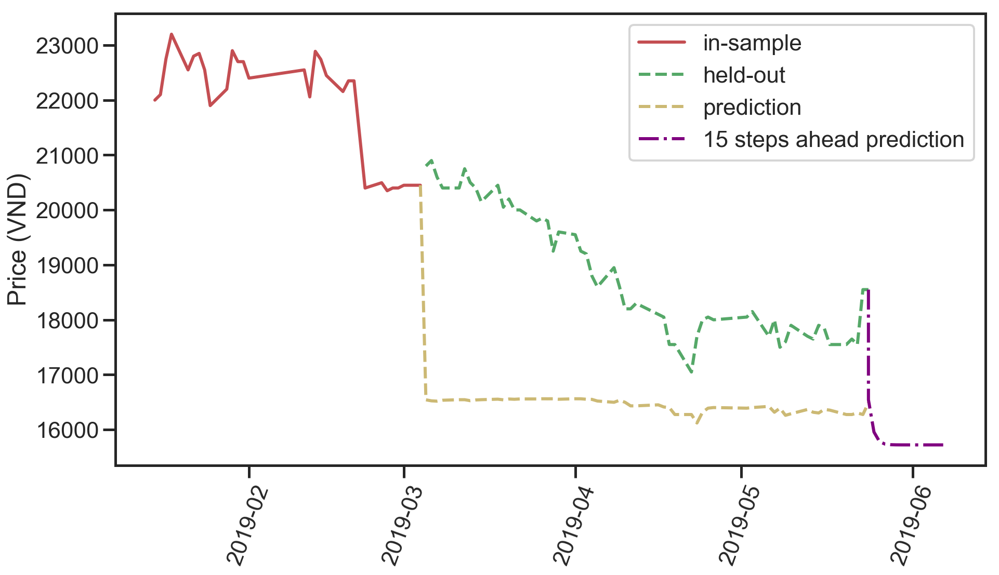

(1, 4, 2)
Testing result: {'mse': 441092.1593188508, 'rmse': 664.1476939046396, 'mae': 591.5294618951692, 'mape': 3.1452700295153644, 'lags': 1, 'hidden layers': (4, 2)}


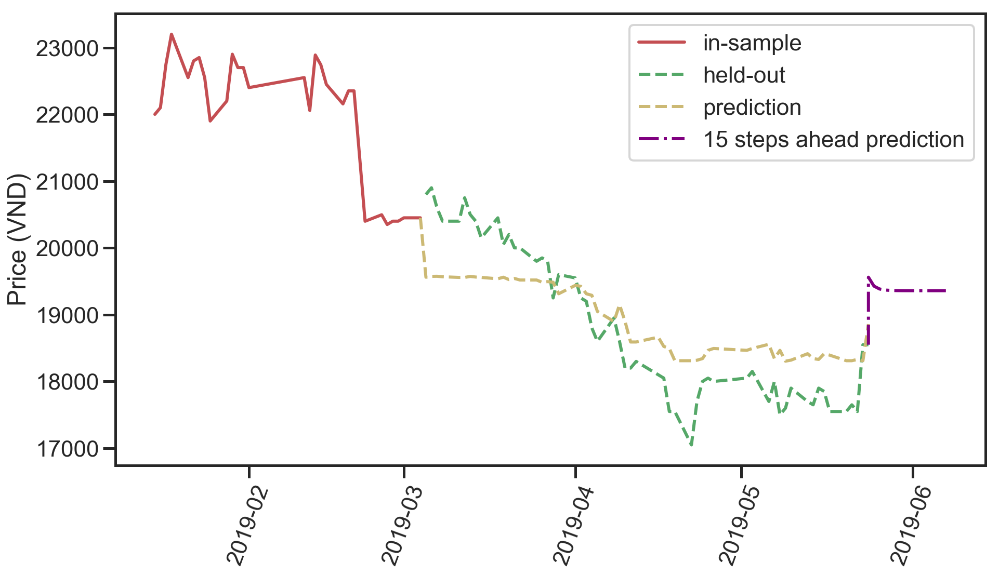

(1, 4, 2)
Testing result: {'mse': 441092.1593188508, 'rmse': 664.1476939046396, 'mae': 591.5294618951692, 'mape': 3.1452700295153644, 'lags': 1, 'hidden layers': (4, 2)}


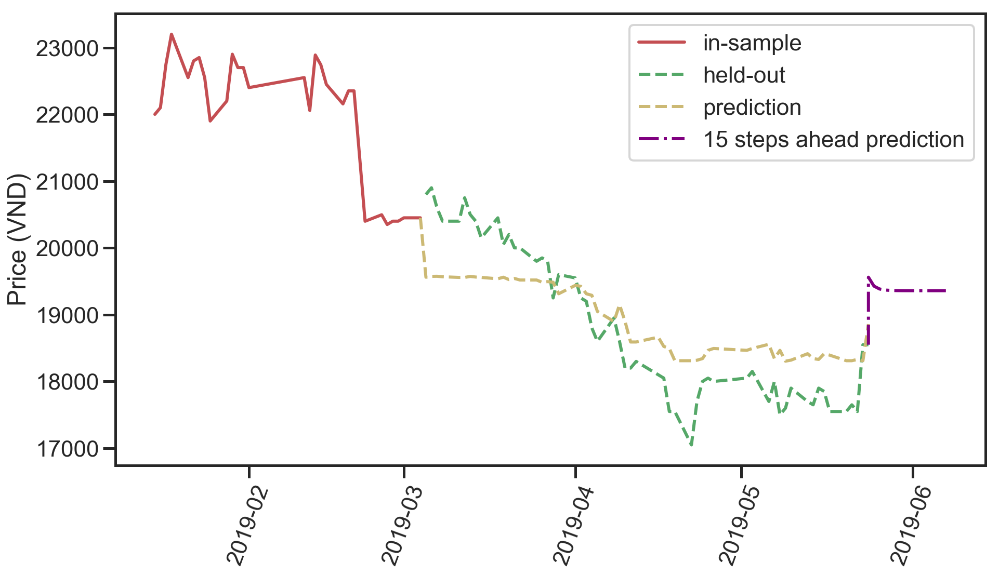

(1, 4, 3)
Testing result: {'mse': 112765.53788787544, 'rmse': 335.80580383292283, 'mae': 259.7128407861821, 'mape': 1.3845948710480145, 'lags': 1, 'hidden layers': (4, 3)}


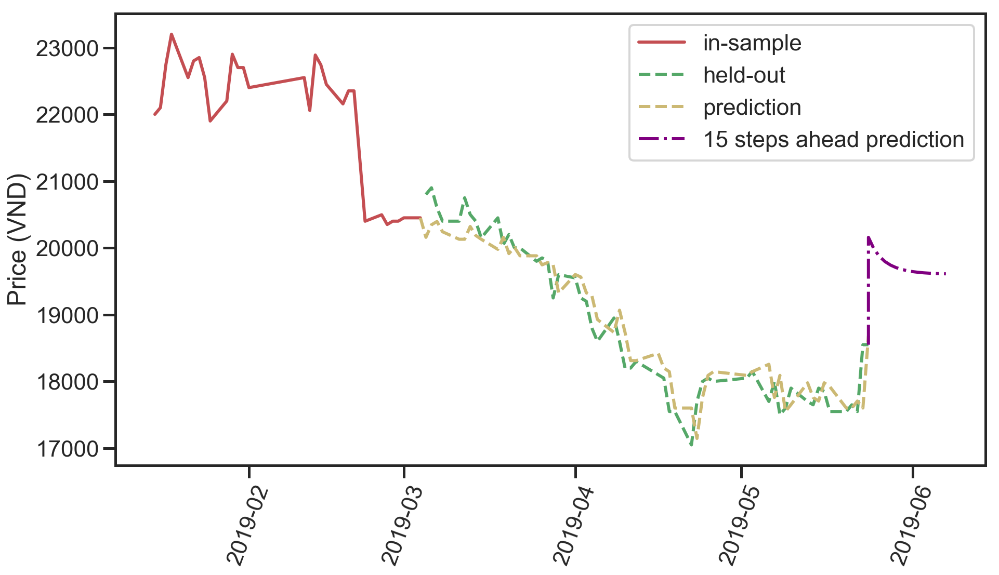

(1, 4, 3)
Testing result: {'mse': 112765.53788787544, 'rmse': 335.80580383292283, 'mae': 259.7128407861821, 'mape': 1.3845948710480145, 'lags': 1, 'hidden layers': (4, 3)}


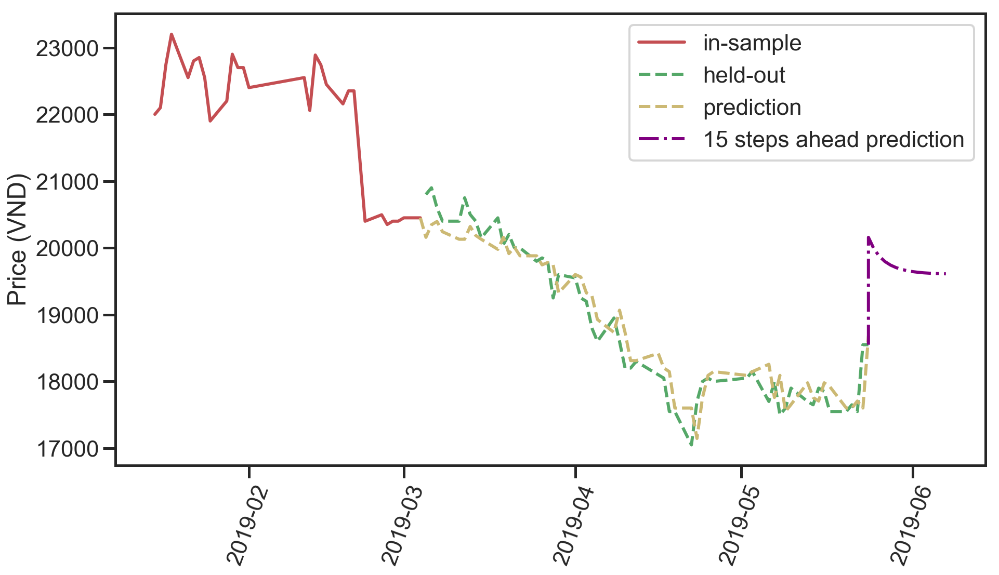

(1, 5, 1)
Testing result: {'mse': 1343022.5696182533, 'rmse': 1158.8885061205212, 'mae': 1052.861546686371, 'mape': 5.577734642588676, 'lags': 1, 'hidden layers': (5, 1)}


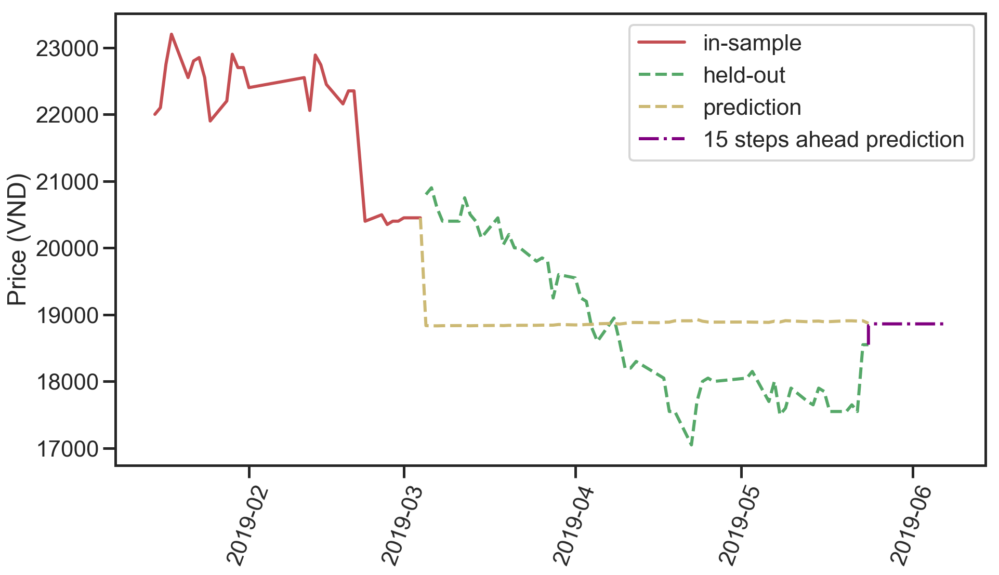

(1, 5, 2)
Testing result: {'mse': 521919.83040448645, 'rmse': 722.4401915760823, 'mae': 628.586863897689, 'mape': 3.41648930086981, 'lags': 1, 'hidden layers': (5, 2)}


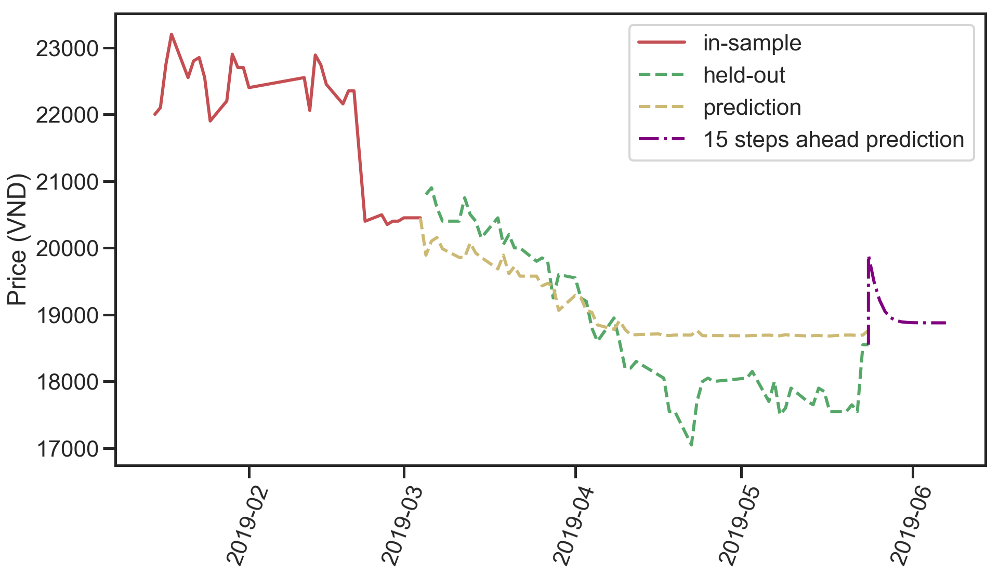

(1, 5, 2)
Testing result: {'mse': 521919.83040448645, 'rmse': 722.4401915760823, 'mae': 628.586863897689, 'mape': 3.41648930086981, 'lags': 1, 'hidden layers': (5, 2)}


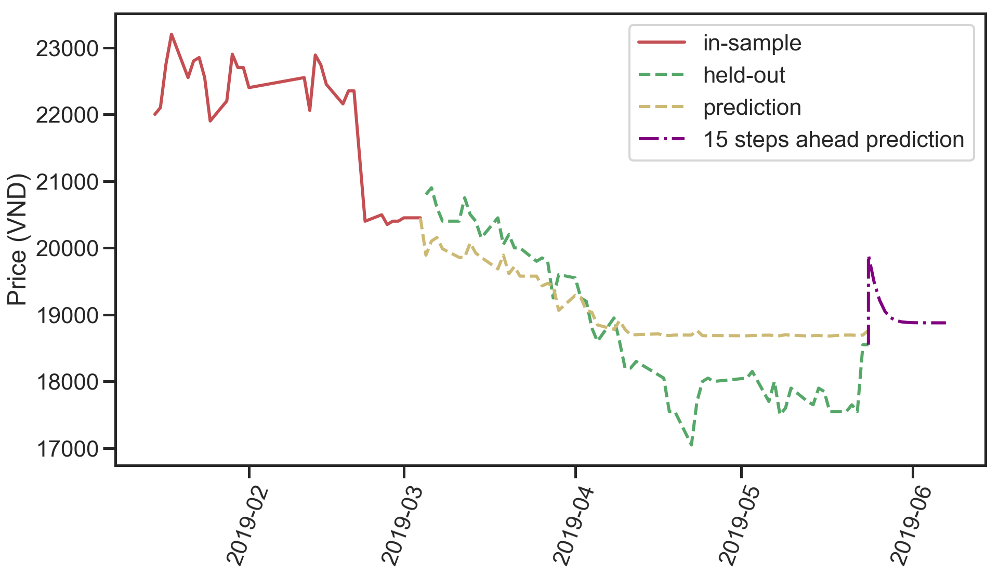

(1, 5, 3)
Testing result: {'mse': 738926.1201598841, 'rmse': 859.6081201104862, 'mae': 678.3944864800078, 'mape': 3.496097550753859, 'lags': 1, 'hidden layers': (5, 3)}


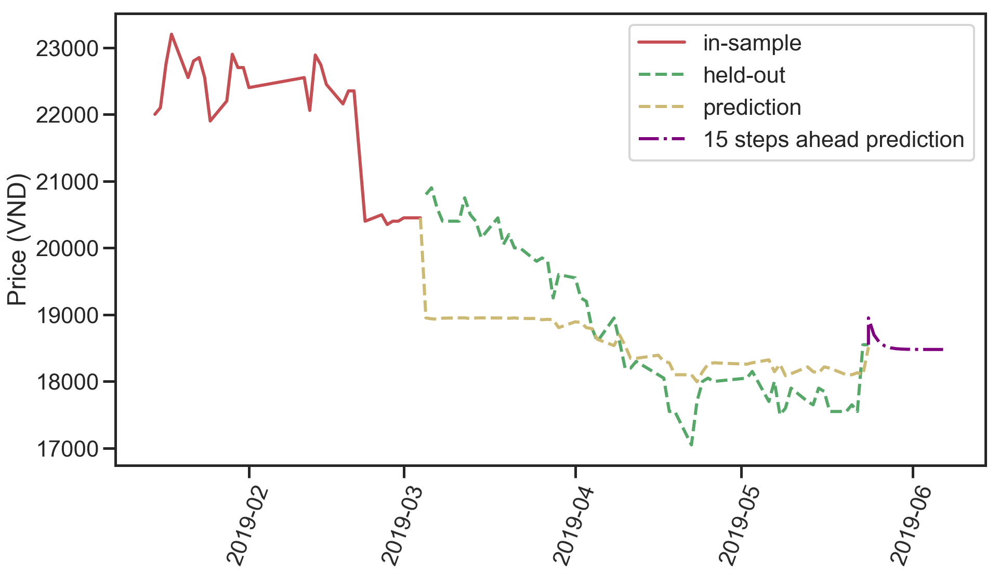

(1, 5, 3)
Testing result: {'mse': 738926.1201598841, 'rmse': 859.6081201104862, 'mae': 678.3944864800078, 'mape': 3.496097550753859, 'lags': 1, 'hidden layers': (5, 3)}


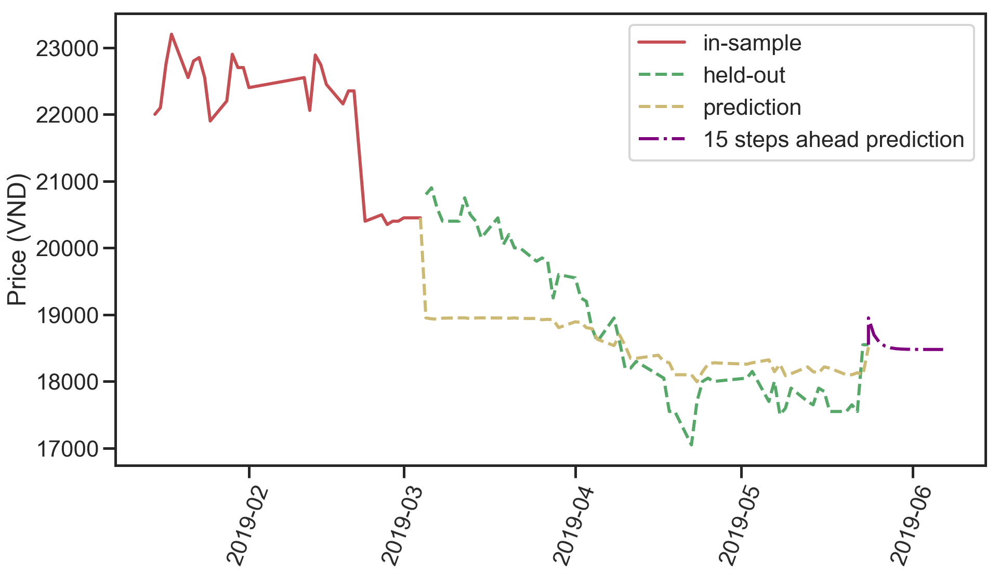

(1, 6, 1)
Testing result: {'mse': 2464171.4728282737, 'rmse': 1569.767967831002, 'mae': 1307.9298672311775, 'mape': 7.22915795229427, 'lags': 1, 'hidden layers': (6, 1)}


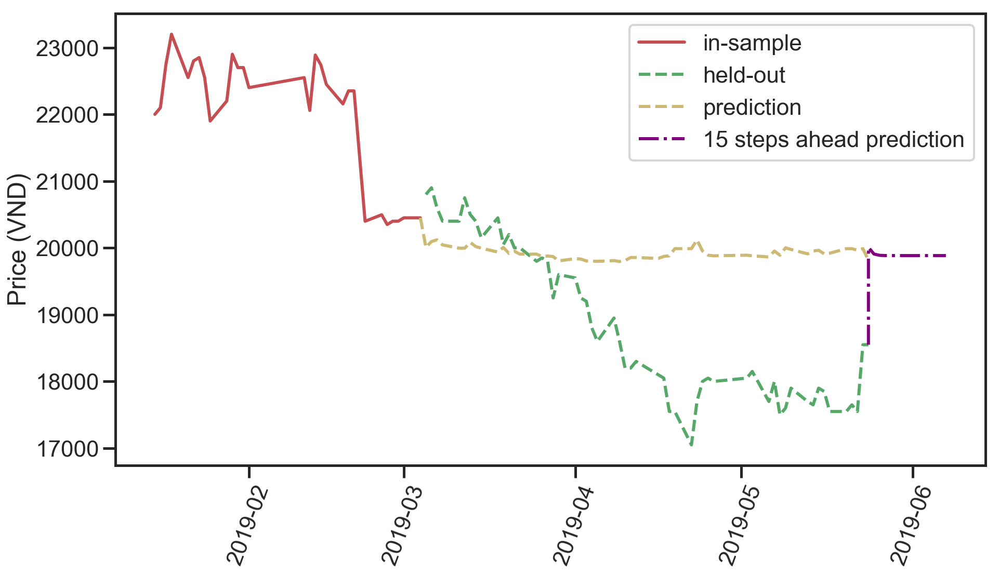

(1, 6, 2)
Testing result: {'mse': 695599.9966181159, 'rmse': 834.0263764522774, 'mae': 691.7567712807806, 'mape': 3.5654743408292076, 'lags': 1, 'hidden layers': (6, 2)}


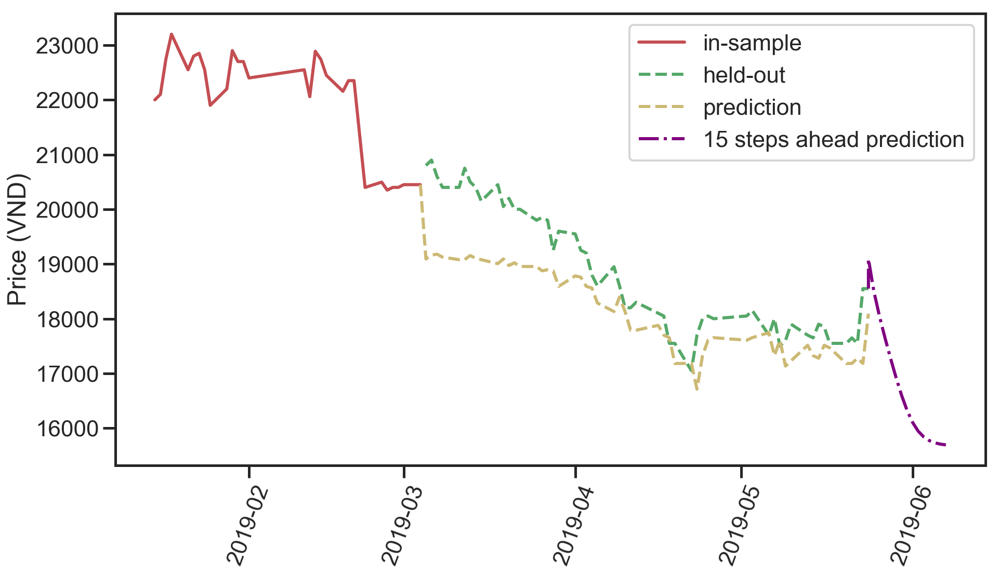

(1, 6, 2)
Testing result: {'mse': 695599.9966181159, 'rmse': 834.0263764522774, 'mae': 691.7567712807806, 'mape': 3.5654743408292076, 'lags': 1, 'hidden layers': (6, 2)}


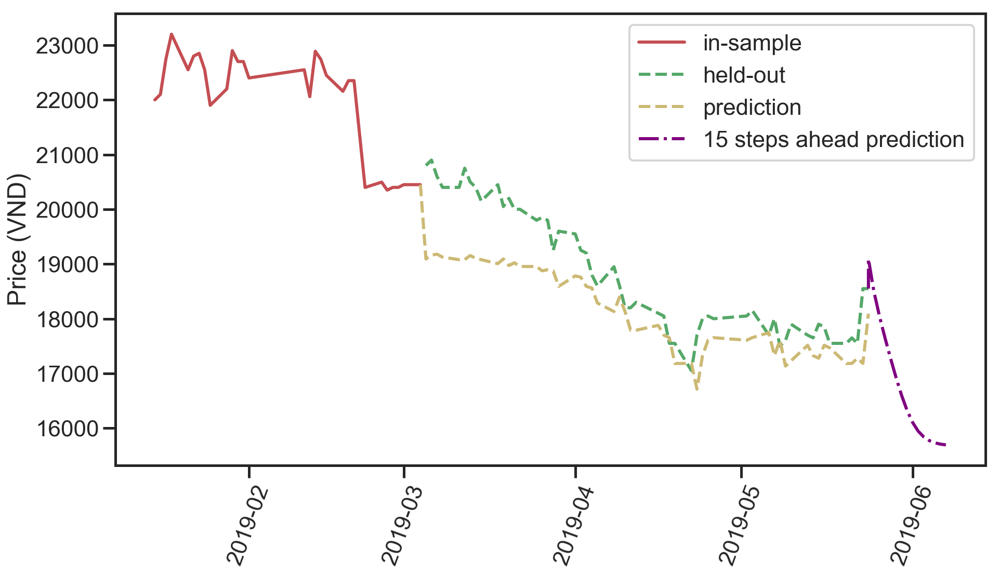

(1, 6, 3)
Testing result: {'mse': 76176.68681265239, 'rmse': 276.001244223015, 'mae': 211.8532867066795, 'mape': 1.1366458028338045, 'lags': 1, 'hidden layers': (6, 3)}


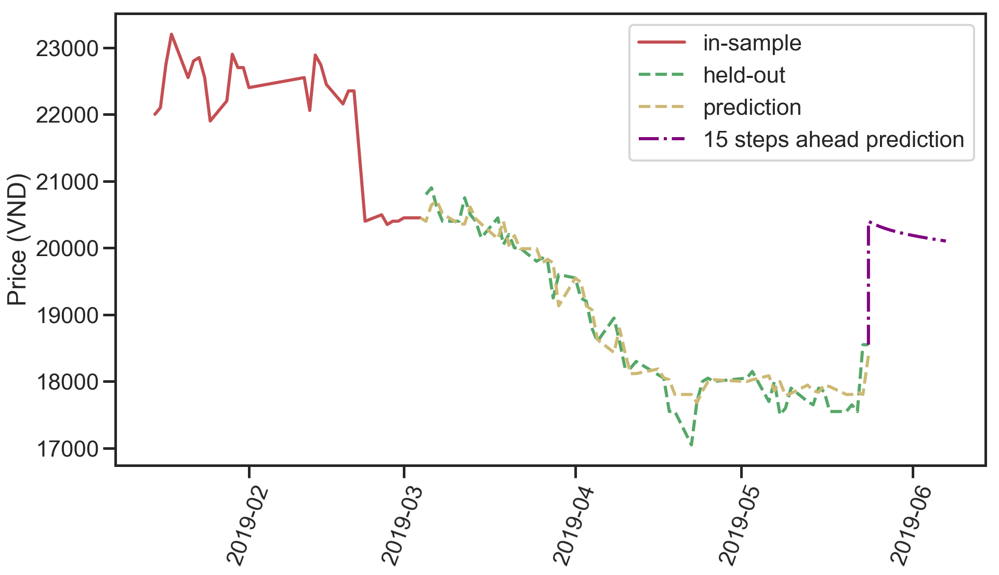

(1, 6, 3)
Testing result: {'mse': 76176.68681265239, 'rmse': 276.001244223015, 'mae': 211.8532867066795, 'mape': 1.1366458028338045, 'lags': 1, 'hidden layers': (6, 3)}


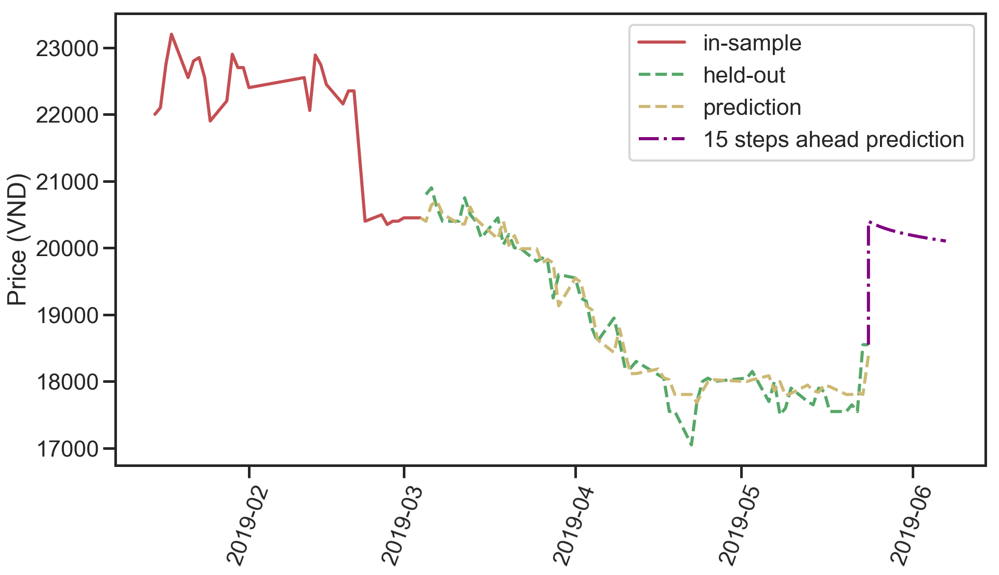

(1, 7, 1)
Testing result: {'mse': 1240238.5256392607, 'rmse': 1113.659968589722, 'mae': 995.8703554669728, 'mape': 5.246591856127125, 'lags': 1, 'hidden layers': (7, 1)}


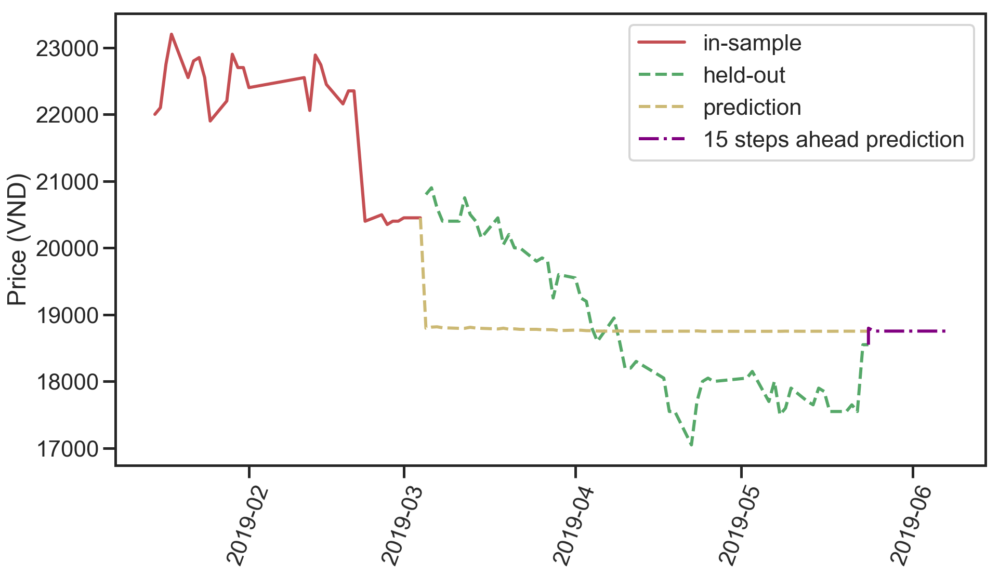

(1, 7, 2)
Testing result: {'mse': 3328135.2193623083, 'rmse': 1824.3177407903231, 'mae': 1781.4698408914626, 'mape': 9.606426924968511, 'lags': 1, 'hidden layers': (7, 2)}


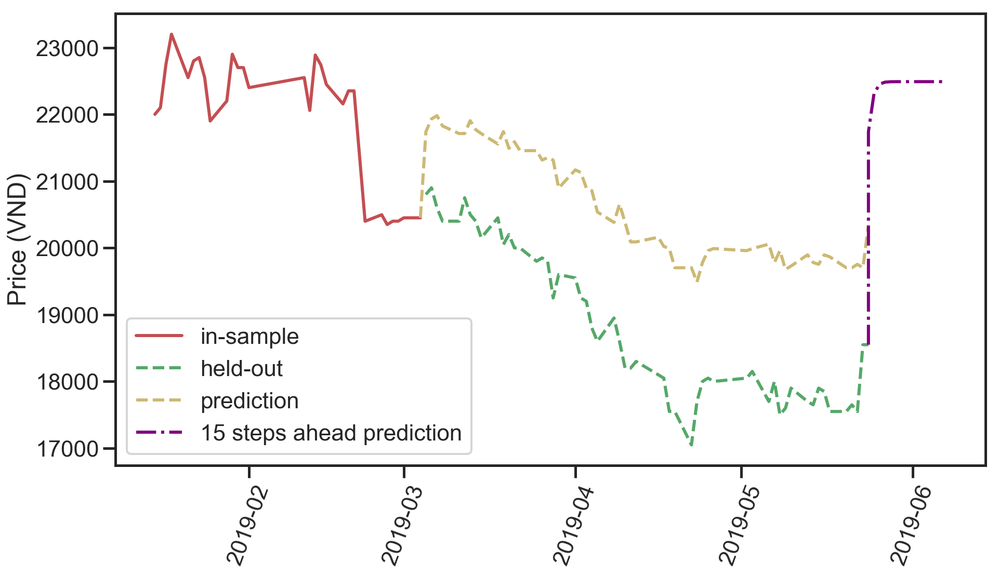

(1, 7, 2)
Testing result: {'mse': 3328135.2193623083, 'rmse': 1824.3177407903231, 'mae': 1781.4698408914626, 'mape': 9.606426924968511, 'lags': 1, 'hidden layers': (7, 2)}


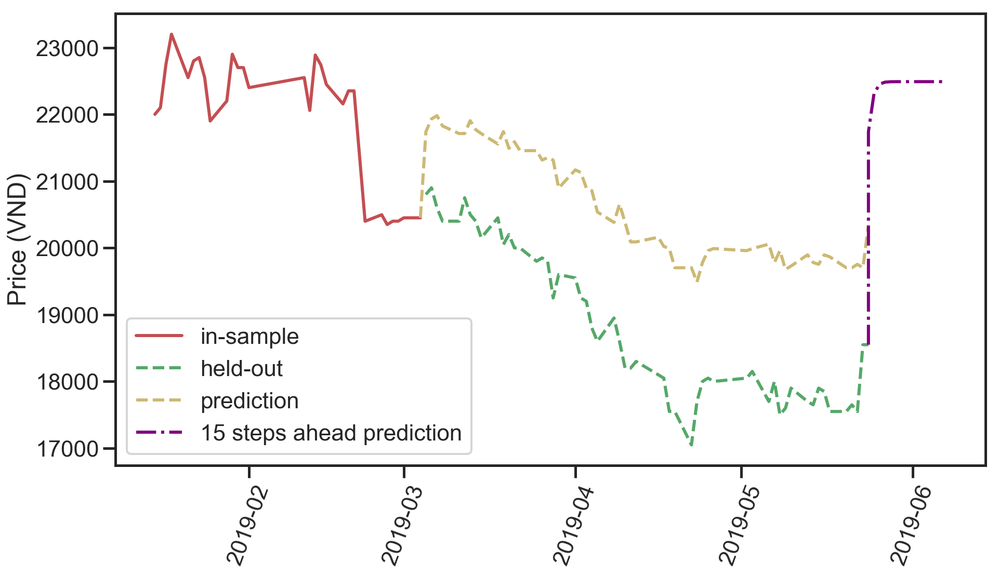

(1, 7, 3)
Testing result: {'mse': 94697.84317866169, 'rmse': 307.73014668482136, 'mae': 247.30800130318895, 'mape': 1.3163501325944338, 'lags': 1, 'hidden layers': (7, 3)}


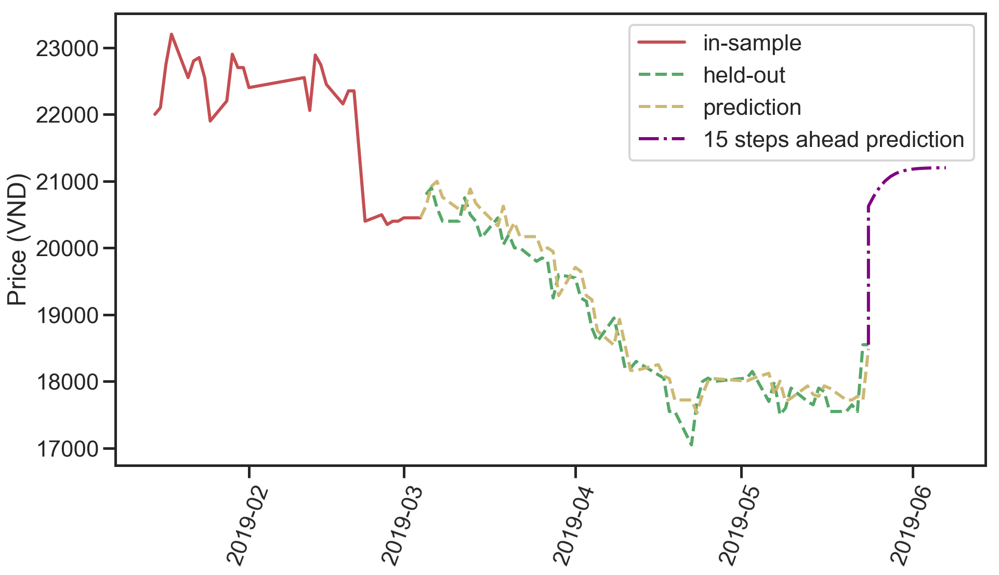

(1, 7, 3)
Testing result: {'mse': 94697.84317866169, 'rmse': 307.73014668482136, 'mae': 247.30800130318895, 'mape': 1.3163501325944338, 'lags': 1, 'hidden layers': (7, 3)}


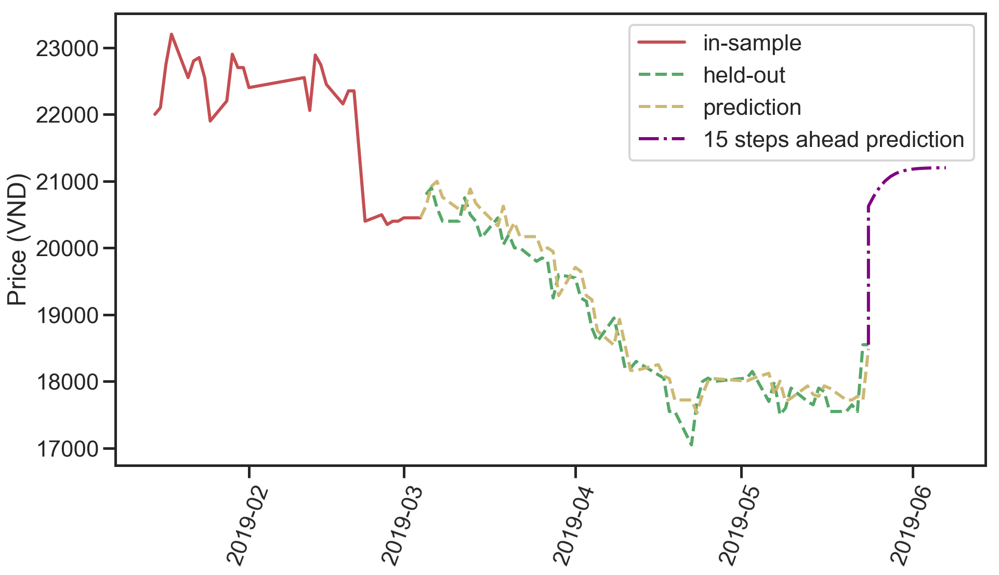

(2, 3, 1)
Testing result: {'mse': 12567157.571515625, 'rmse': 3545.018698330888, 'mae': 3083.61894693721, 'mape': 15.89853620981839, 'lags': 2, 'hidden layers': (3, 1)}


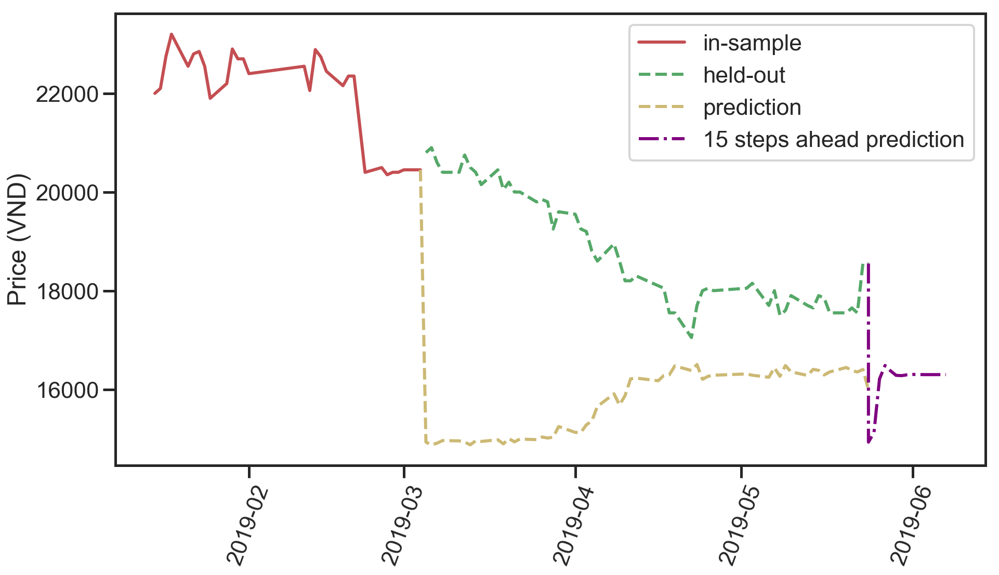

(2, 3, 2)
Testing result: {'mse': 3876472.227128596, 'rmse': 1968.875879056015, 'mae': 1655.6109935635782, 'mape': 8.557269745761712, 'lags': 2, 'hidden layers': (3, 2)}


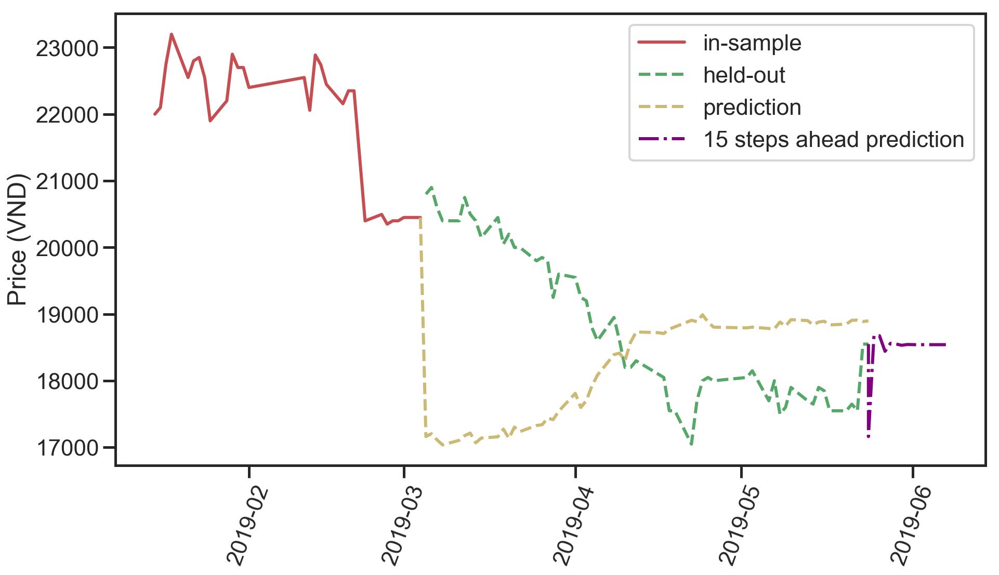

(2, 3, 2)
Testing result: {'mse': 3876472.227128596, 'rmse': 1968.875879056015, 'mae': 1655.6109935635782, 'mape': 8.557269745761712, 'lags': 2, 'hidden layers': (3, 2)}


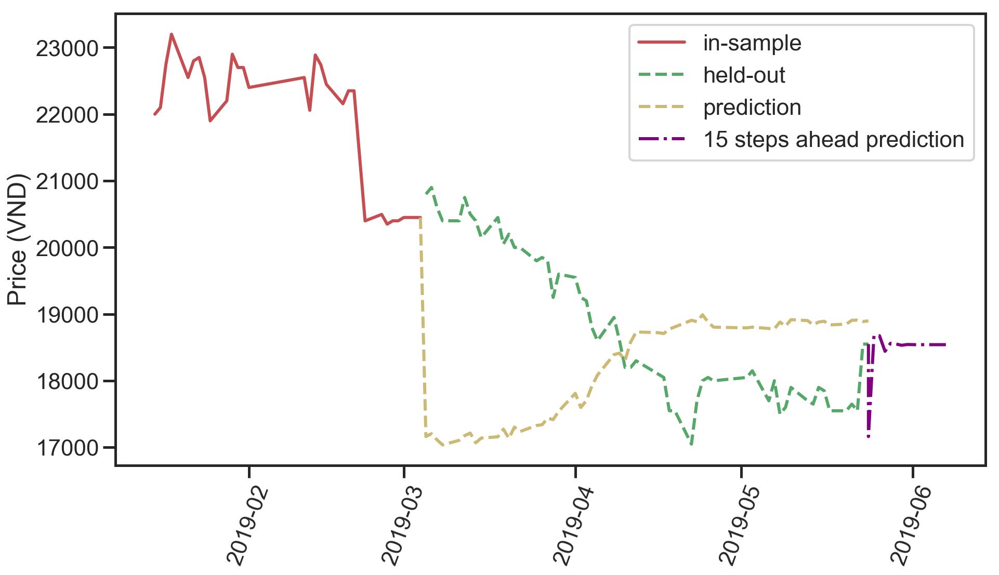

(2, 3, 3)
Testing result: {'mse': 665623.2322726917, 'rmse': 815.857360249138, 'mae': 722.3090772272752, 'mape': 3.897816617341748, 'lags': 2, 'hidden layers': (3, 3)}


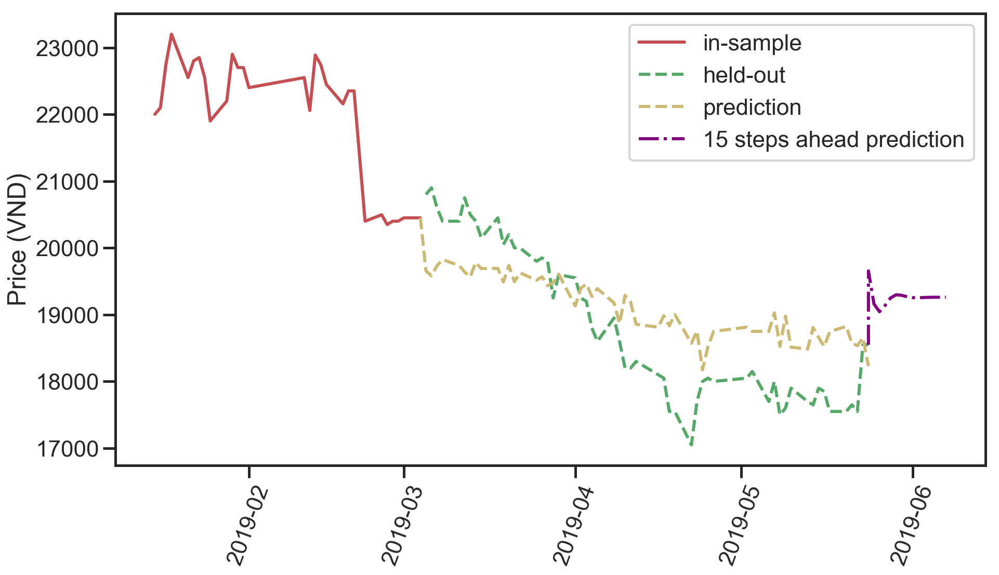

(2, 3, 3)
Testing result: {'mse': 665623.2322726917, 'rmse': 815.857360249138, 'mae': 722.3090772272752, 'mape': 3.897816617341748, 'lags': 2, 'hidden layers': (3, 3)}


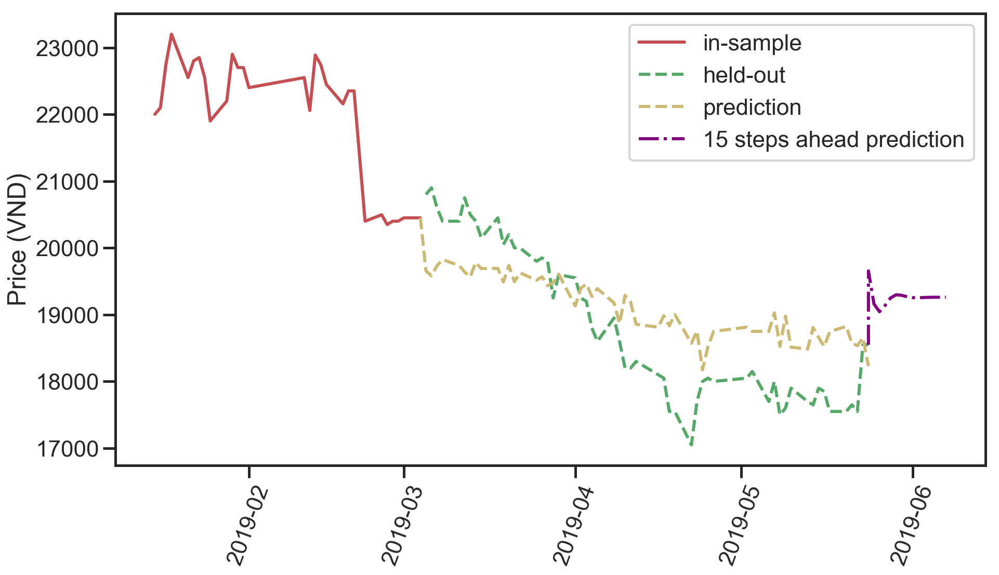

(2, 4, 1)
Testing result: {'mse': 2648685.452576699, 'rmse': 1627.478249494198, 'mae': 1294.5158186759638, 'mape': 6.59669682547928, 'lags': 2, 'hidden layers': (4, 1)}


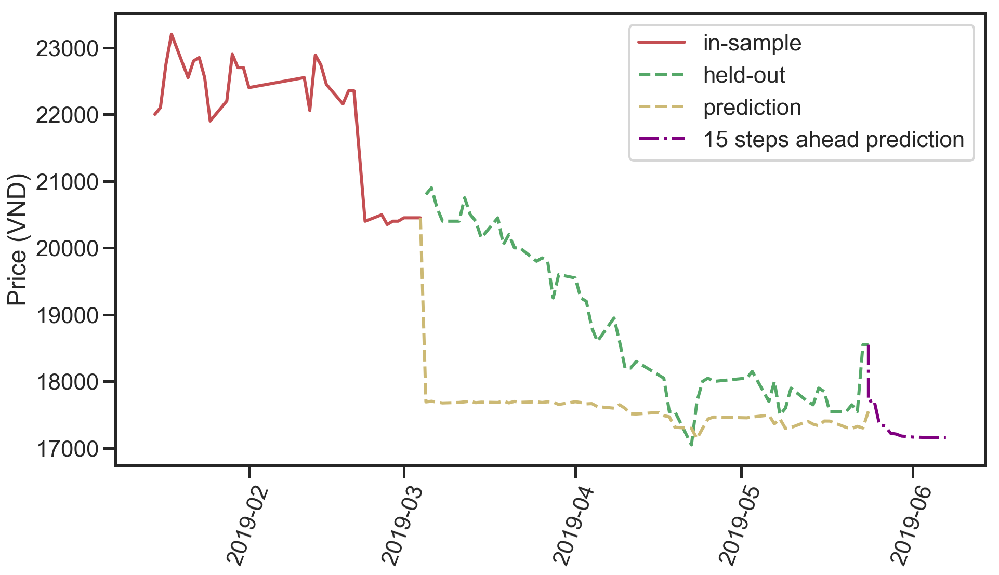

(2, 4, 2)
Testing result: {'mse': 3082424.554929976, 'rmse': 1755.683500785371, 'mae': 1479.5543463264391, 'mape': 8.167180785277282, 'lags': 2, 'hidden layers': (4, 2)}


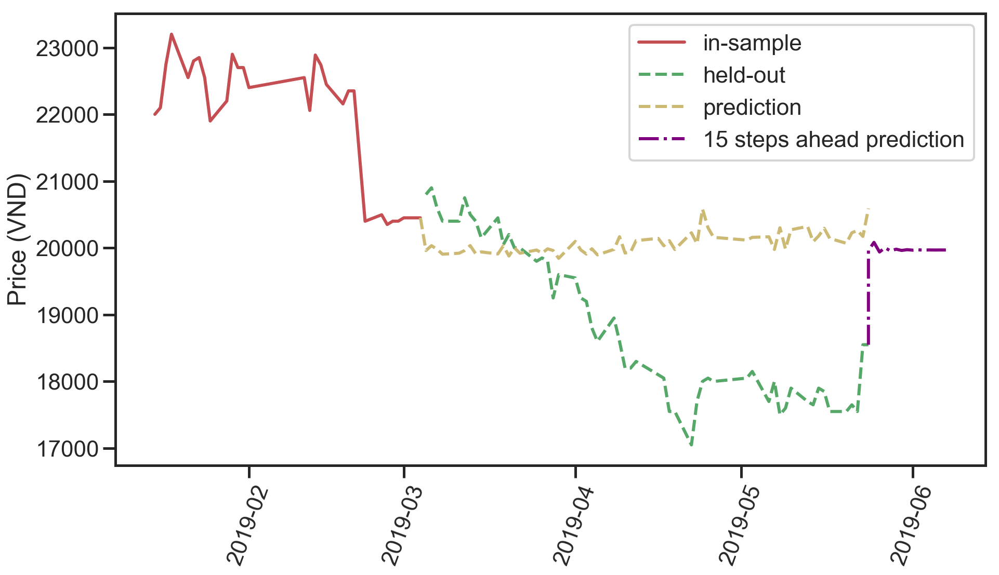

(2, 4, 2)
Testing result: {'mse': 3082424.554929976, 'rmse': 1755.683500785371, 'mae': 1479.5543463264391, 'mape': 8.167180785277282, 'lags': 2, 'hidden layers': (4, 2)}


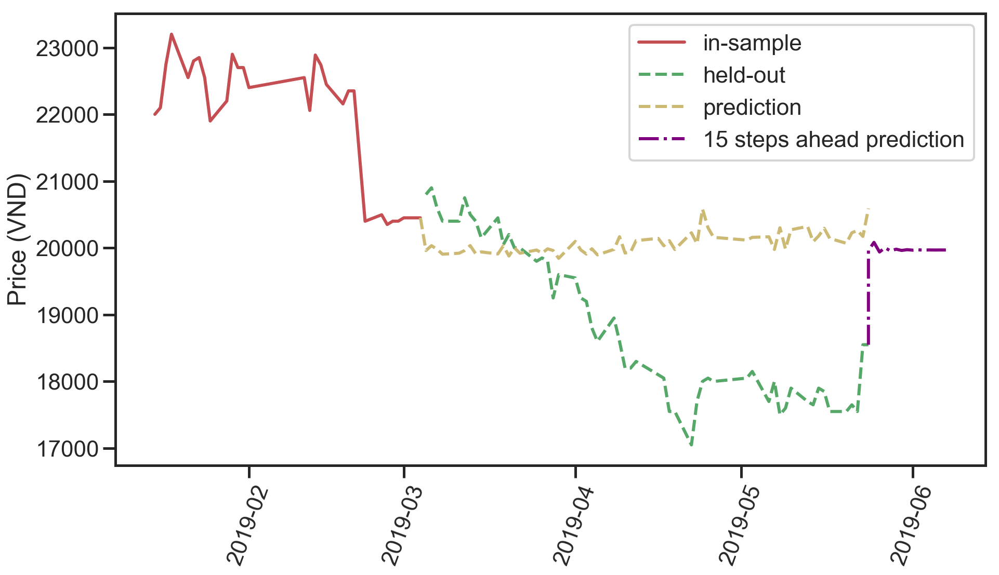

(2, 4, 3)
Testing result: {'mse': 6223487.321339823, 'rmse': 2494.691828931947, 'mae': 2178.6103255641, 'mape': 11.23756514780352, 'lags': 2, 'hidden layers': (4, 3)}


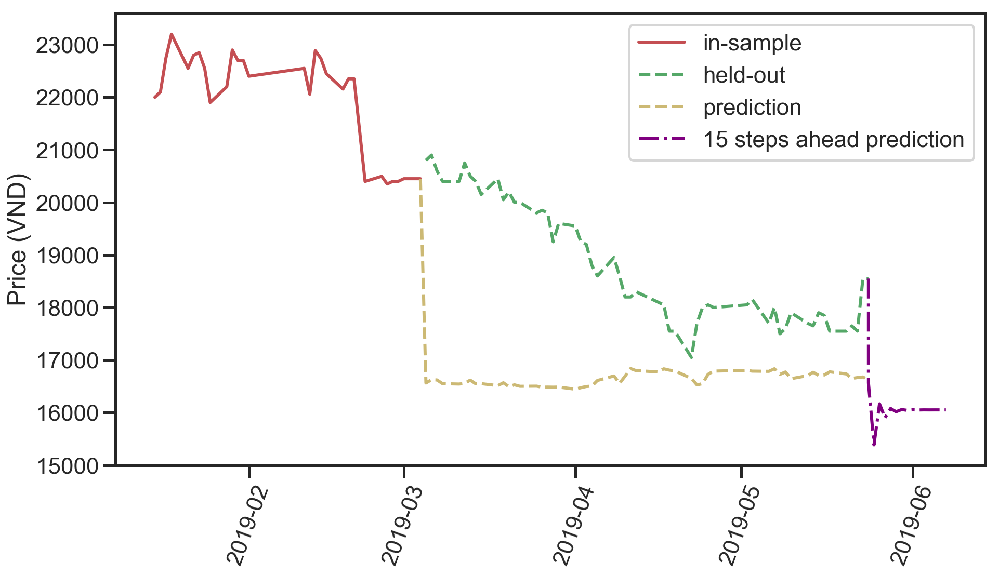

(2, 4, 3)
Testing result: {'mse': 6223487.321339823, 'rmse': 2494.691828931947, 'mae': 2178.6103255641, 'mape': 11.23756514780352, 'lags': 2, 'hidden layers': (4, 3)}


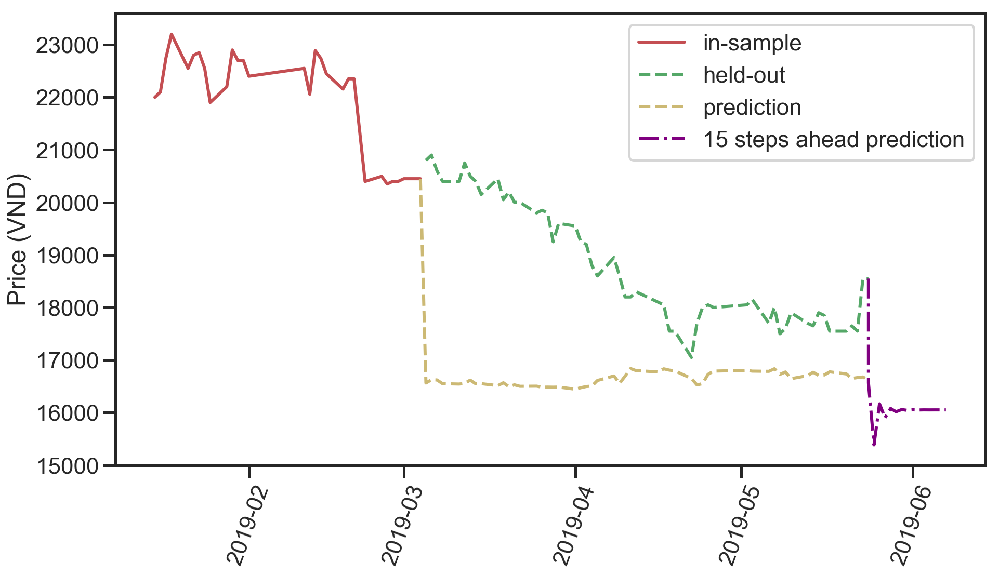

(2, 5, 1)
Testing result: {'mse': 105964.16483118745, 'rmse': 325.52137384692185, 'mae': 246.06054965446634, 'mape': 1.3153927771739529, 'lags': 2, 'hidden layers': (5, 1)}


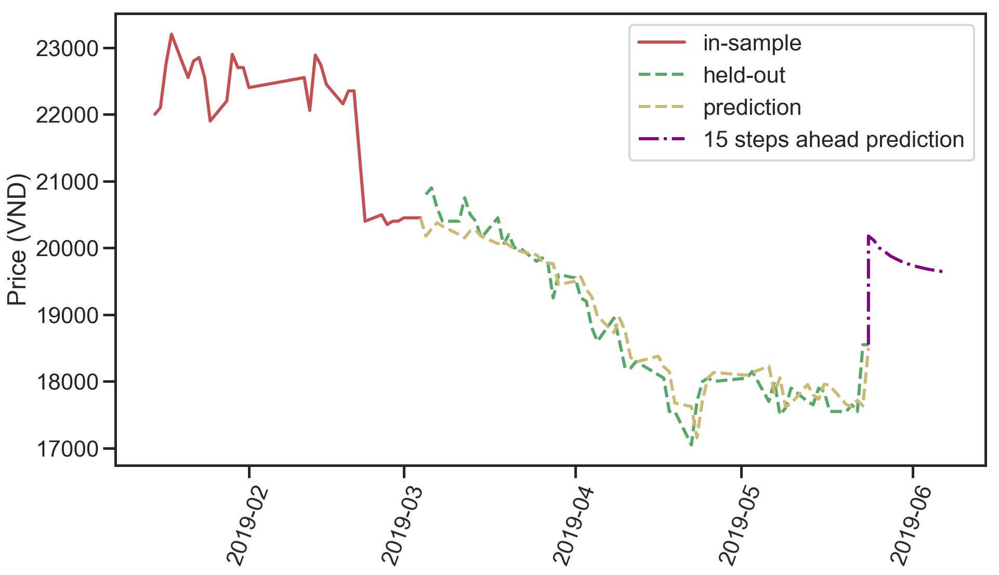

(2, 5, 2)
Testing result: {'mse': 385886.67655998335, 'rmse': 621.1977757204088, 'mae': 512.5364789755224, 'mape': 2.808891770197717, 'lags': 2, 'hidden layers': (5, 2)}


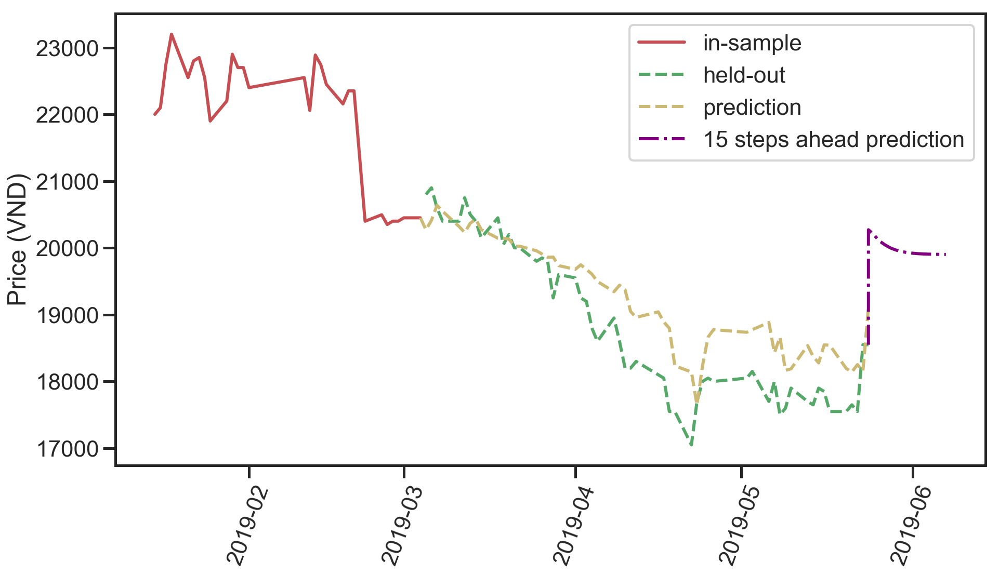

(2, 5, 2)
Testing result: {'mse': 385886.67655998335, 'rmse': 621.1977757204088, 'mae': 512.5364789755224, 'mape': 2.808891770197717, 'lags': 2, 'hidden layers': (5, 2)}


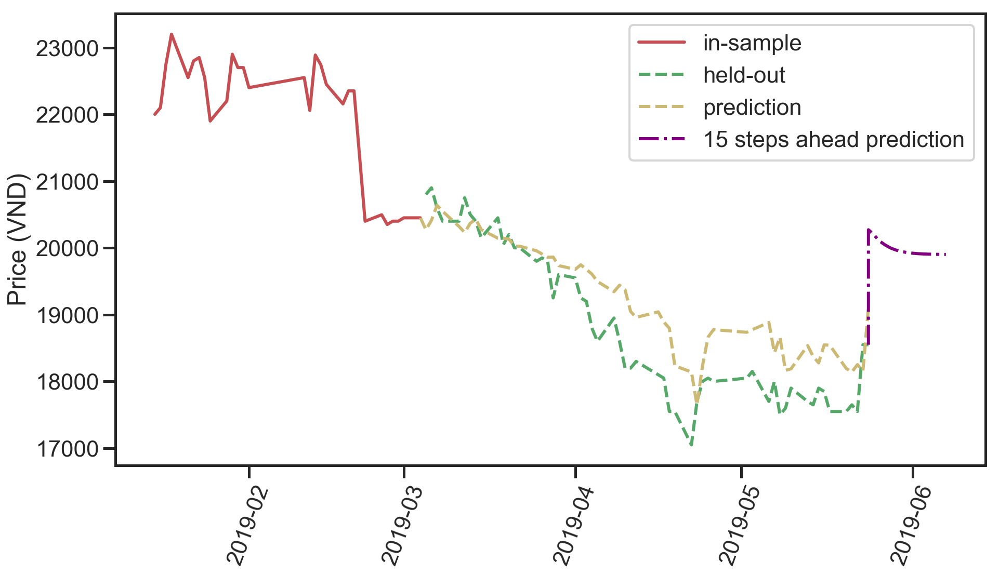

(2, 5, 3)
Testing result: {'mse': 133853.79435653525, 'rmse': 365.8603481610644, 'mae': 290.63551549485516, 'mape': 1.5572989053820625, 'lags': 2, 'hidden layers': (5, 3)}


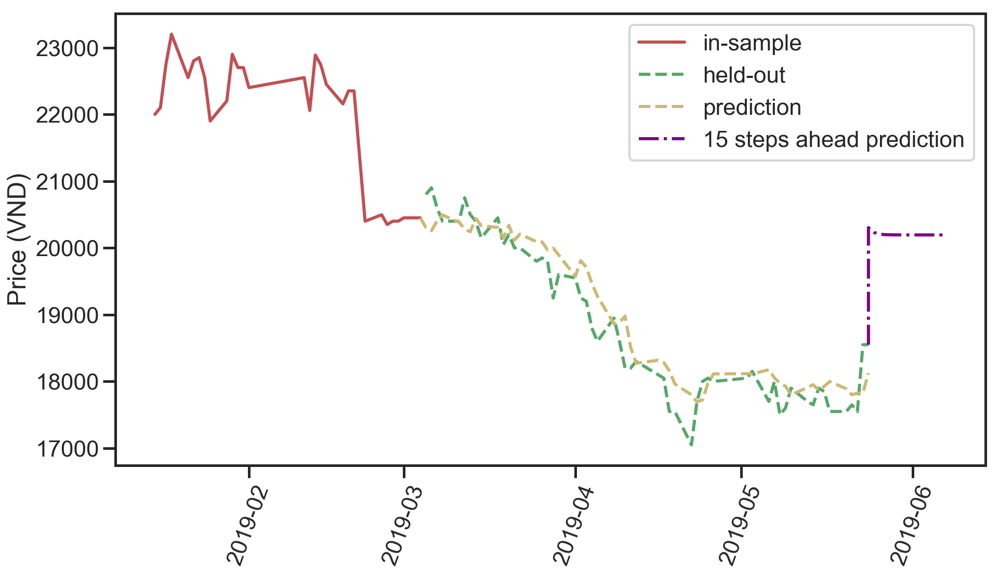

(2, 5, 3)
Testing result: {'mse': 133853.79435653525, 'rmse': 365.8603481610644, 'mae': 290.63551549485516, 'mape': 1.5572989053820625, 'lags': 2, 'hidden layers': (5, 3)}


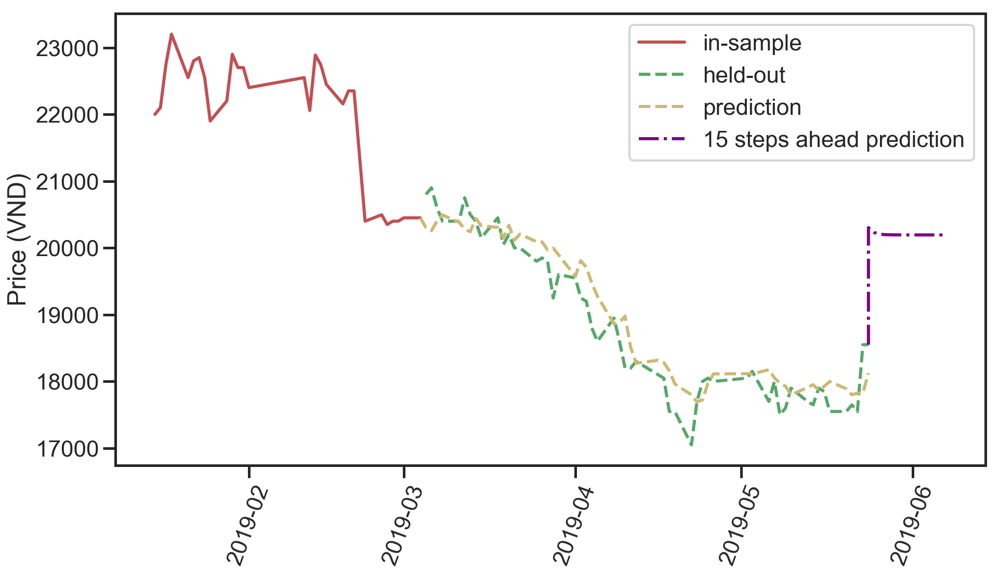

(2, 6, 1)
Testing result: {'mse': 538266.8092269751, 'rmse': 733.6666880995587, 'mae': 580.2969364117187, 'mape': 2.9979465631023325, 'lags': 2, 'hidden layers': (6, 1)}


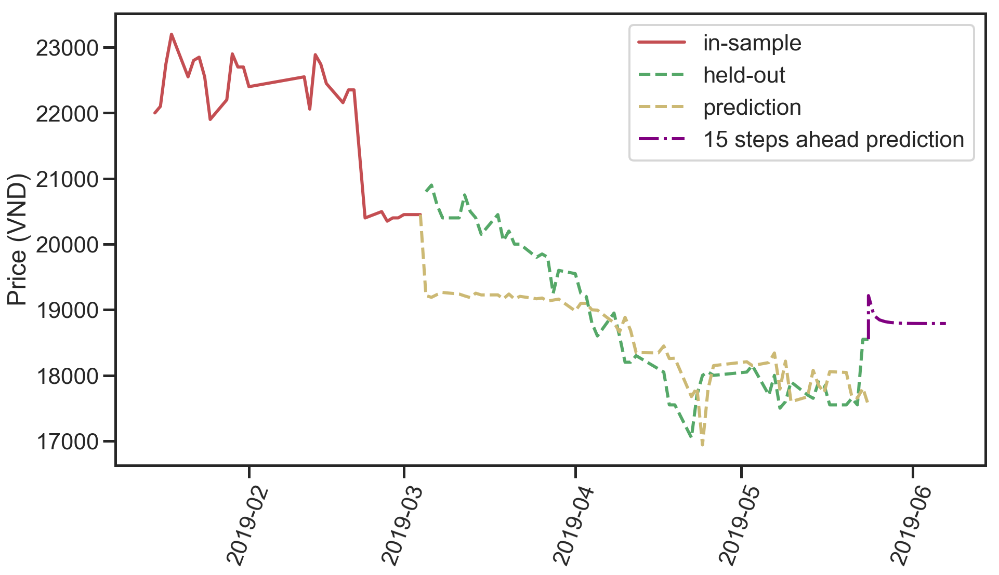

(2, 6, 2)
Testing result: {'mse': 97252.25790317431, 'rmse': 311.85294275214767, 'mae': 249.72351580094434, 'mape': 1.340471568507135, 'lags': 2, 'hidden layers': (6, 2)}


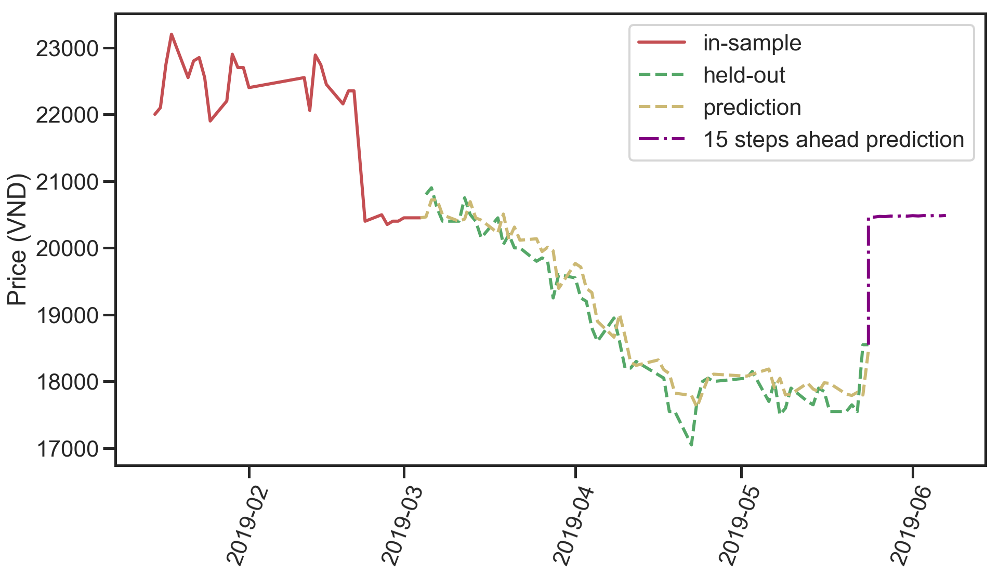

(2, 6, 2)
Testing result: {'mse': 97252.25790317431, 'rmse': 311.85294275214767, 'mae': 249.72351580094434, 'mape': 1.340471568507135, 'lags': 2, 'hidden layers': (6, 2)}


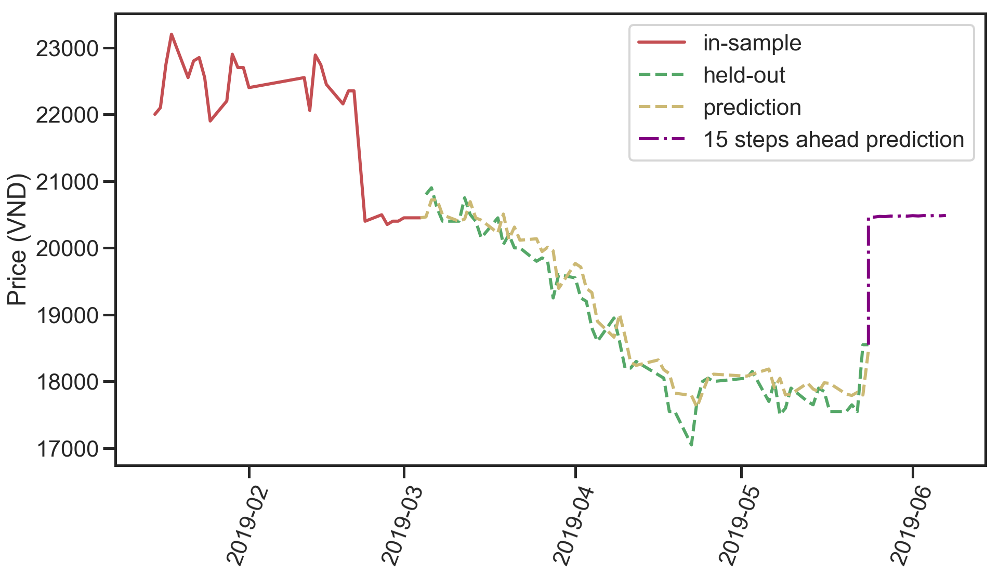

(2, 6, 3)
Testing result: {'mse': 130475.65426180778, 'rmse': 361.21413906685297, 'mae': 280.29845652450115, 'mape': 1.4908699723913084, 'lags': 2, 'hidden layers': (6, 3)}


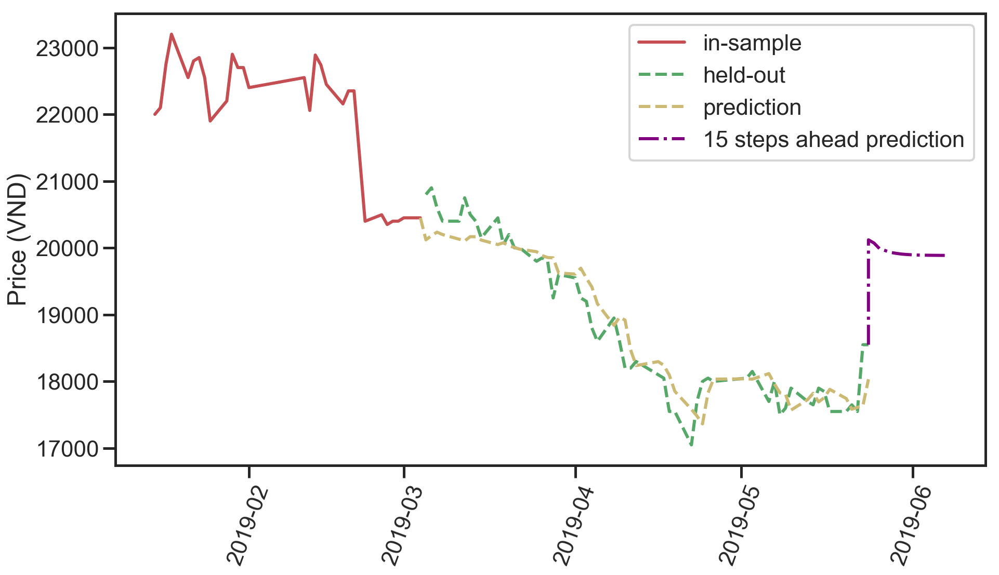

(2, 6, 3)
Testing result: {'mse': 130475.65426180778, 'rmse': 361.21413906685297, 'mae': 280.29845652450115, 'mape': 1.4908699723913084, 'lags': 2, 'hidden layers': (6, 3)}


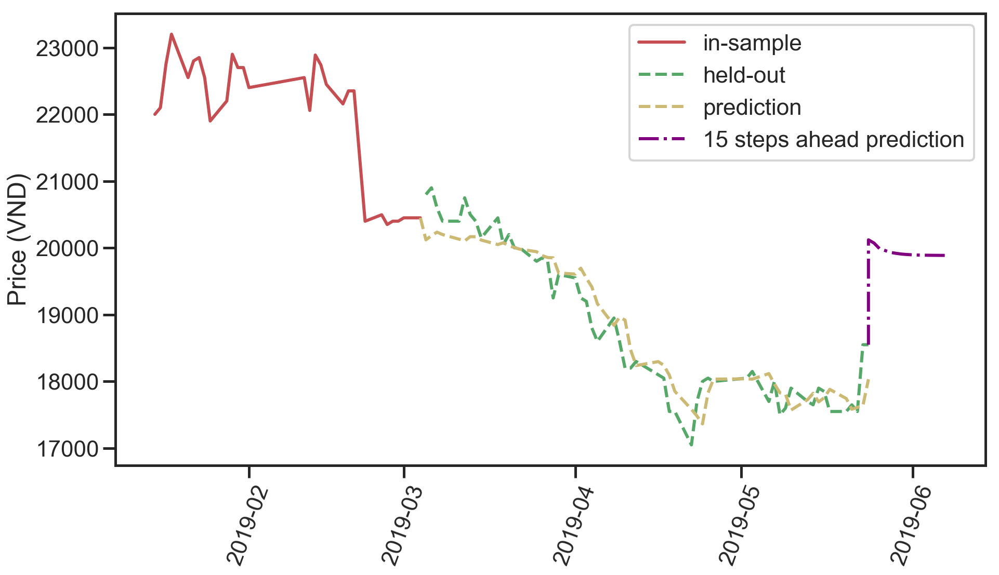

(2, 7, 1)
Testing result: {'mse': 10661613.595589347, 'rmse': 3265.212641711003, 'mae': 2397.14960993382, 'mape': 12.099223351825486, 'lags': 2, 'hidden layers': (7, 1)}


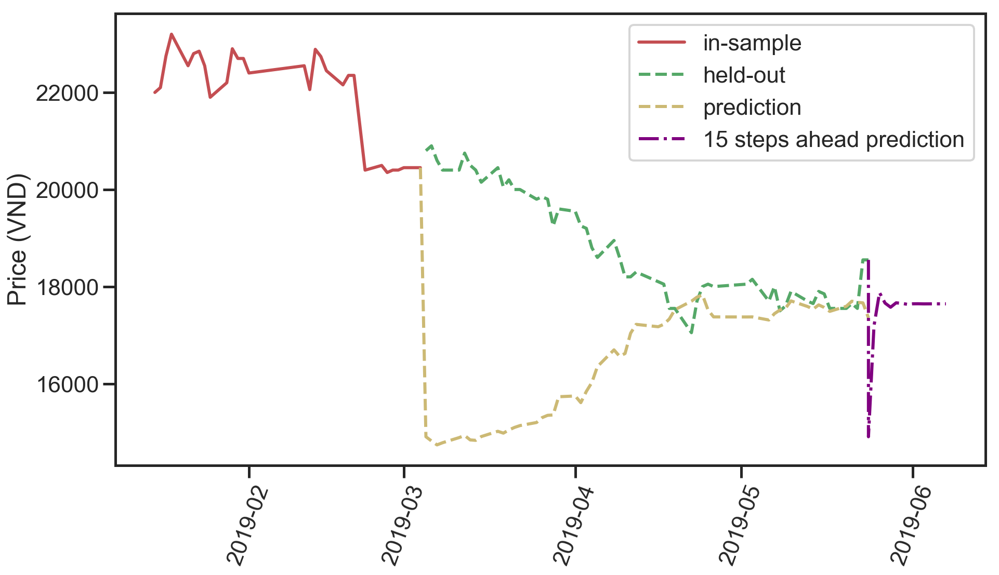

(2, 7, 2)
Testing result: {'mse': 235565.7754340316, 'rmse': 485.35118773320374, 'mae': 376.1168674442218, 'mape': 1.9889248744416592, 'lags': 2, 'hidden layers': (7, 2)}


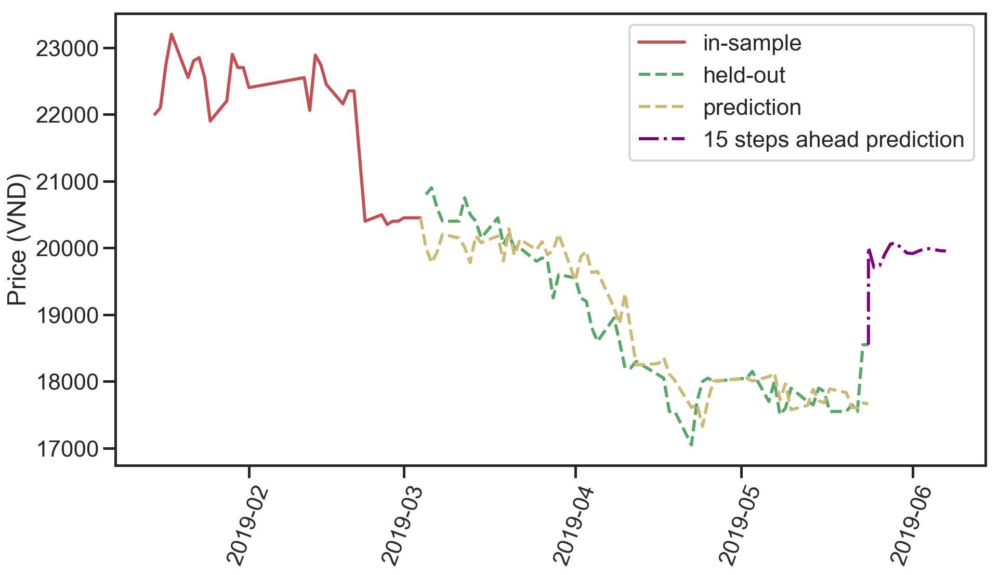

(2, 7, 2)
Testing result: {'mse': 235565.7754340316, 'rmse': 485.35118773320374, 'mae': 376.1168674442218, 'mape': 1.9889248744416592, 'lags': 2, 'hidden layers': (7, 2)}


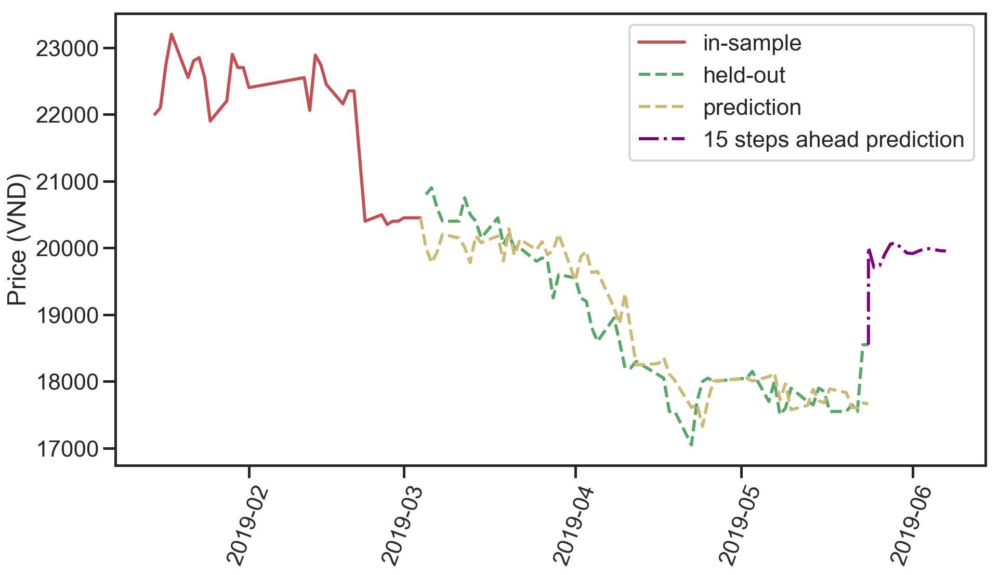

(2, 7, 3)
Testing result: {'mse': 101823.07144727506, 'rmse': 319.0972758380664, 'mae': 249.33843642984053, 'mape': 1.3257614914553992, 'lags': 2, 'hidden layers': (7, 3)}


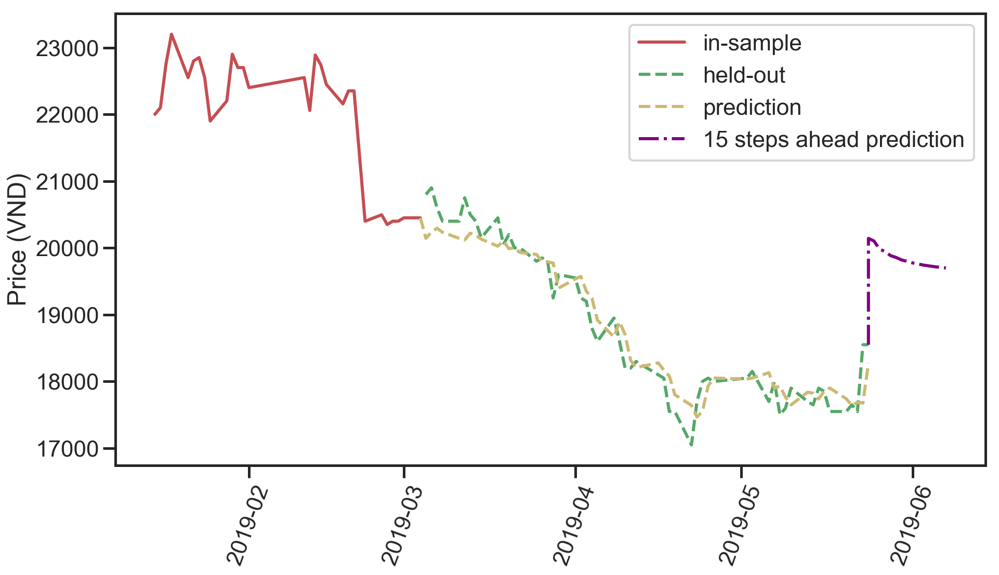

(2, 7, 3)
Testing result: {'mse': 101823.07144727506, 'rmse': 319.0972758380664, 'mae': 249.33843642984053, 'mape': 1.3257614914553992, 'lags': 2, 'hidden layers': (7, 3)}


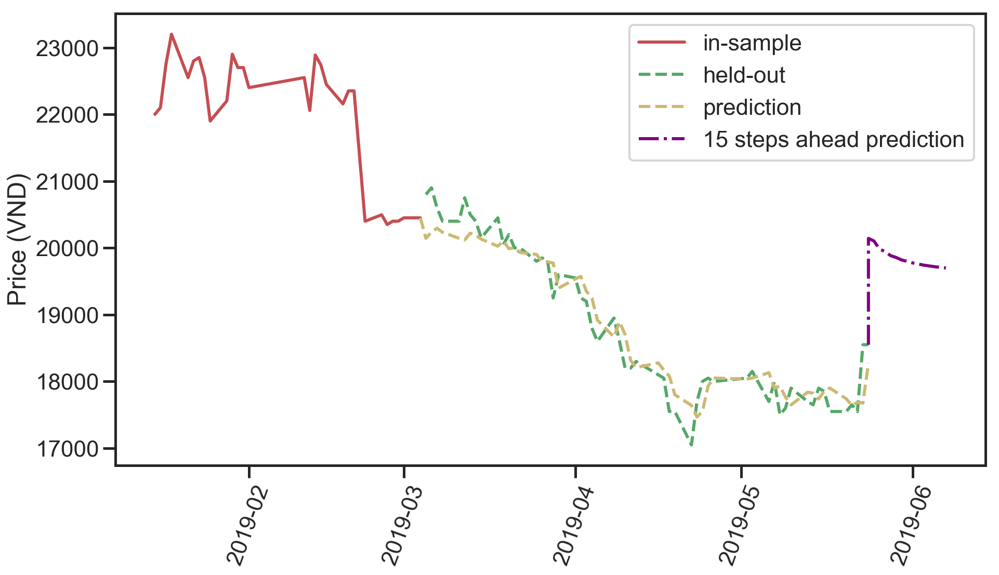

(3, 3, 1)
Testing result: {'mse': 1379317.4943716847, 'rmse': 1174.4434828341825, 'mae': 1074.0084638522112, 'mape': 5.707683823547214, 'lags': 3, 'hidden layers': (3, 1)}


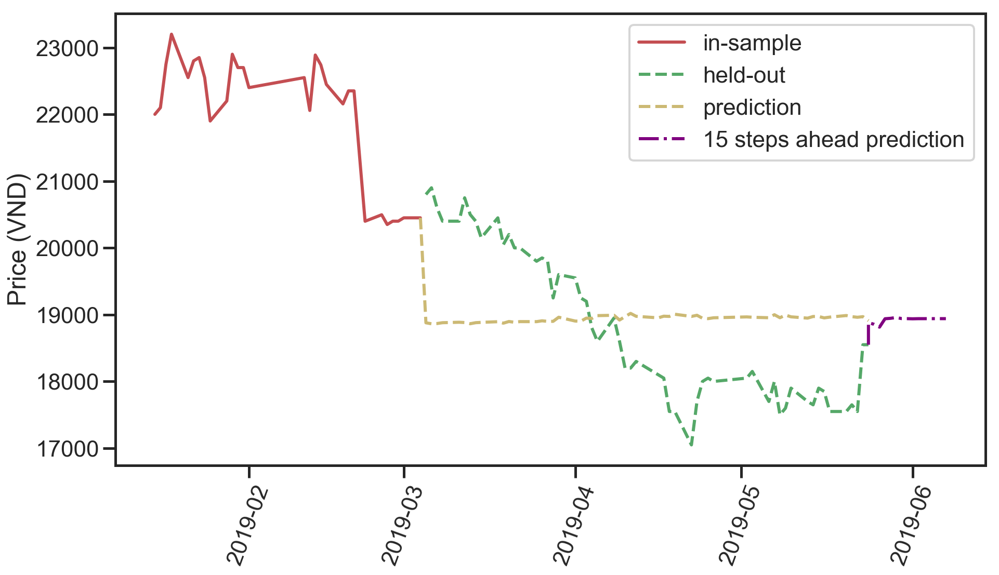

(3, 3, 2)
Testing result: {'mse': 2720563.957984583, 'rmse': 1649.4132162634635, 'mae': 1291.933085574282, 'mape': 6.577306747884106, 'lags': 3, 'hidden layers': (3, 2)}


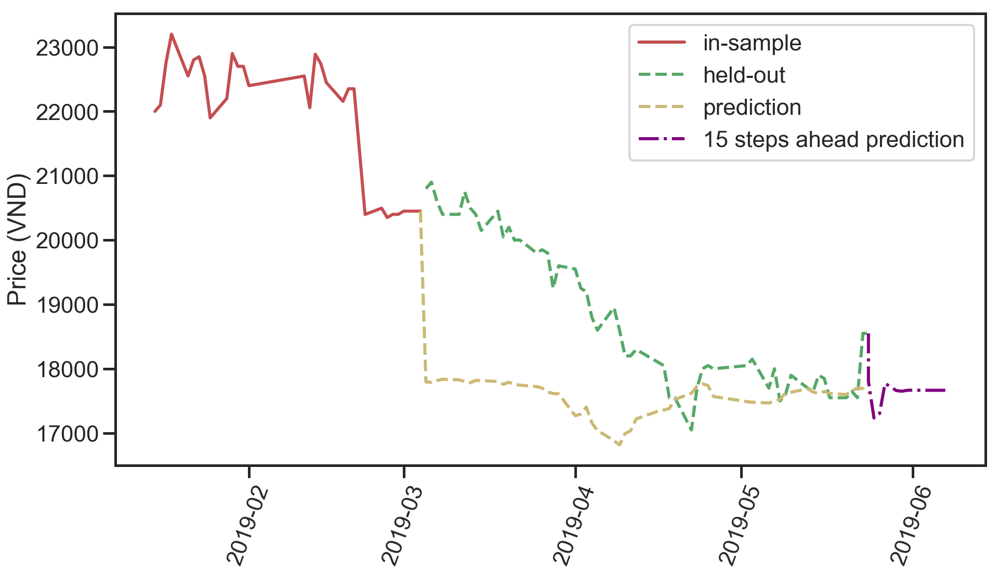

(3, 3, 2)
Testing result: {'mse': 2720563.957984583, 'rmse': 1649.4132162634635, 'mae': 1291.933085574282, 'mape': 6.577306747884106, 'lags': 3, 'hidden layers': (3, 2)}


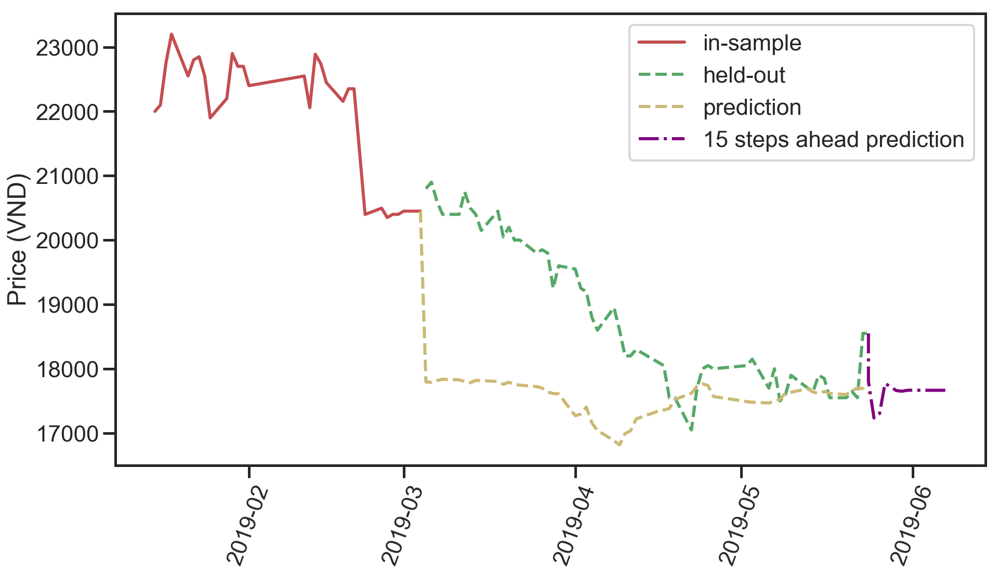

(3, 3, 3)
Testing result: {'mse': 451711.51493236324, 'rmse': 672.094870485085, 'mae': 579.2640841807342, 'mape': 3.0403262347309035, 'lags': 3, 'hidden layers': (3, 3)}


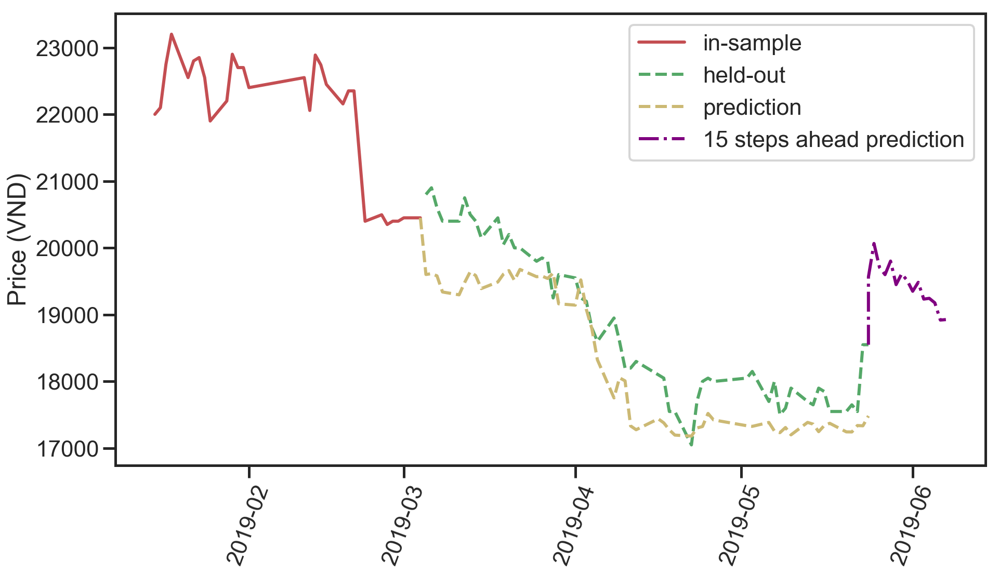

(3, 3, 3)
Testing result: {'mse': 451711.51493236324, 'rmse': 672.094870485085, 'mae': 579.2640841807342, 'mape': 3.0403262347309035, 'lags': 3, 'hidden layers': (3, 3)}


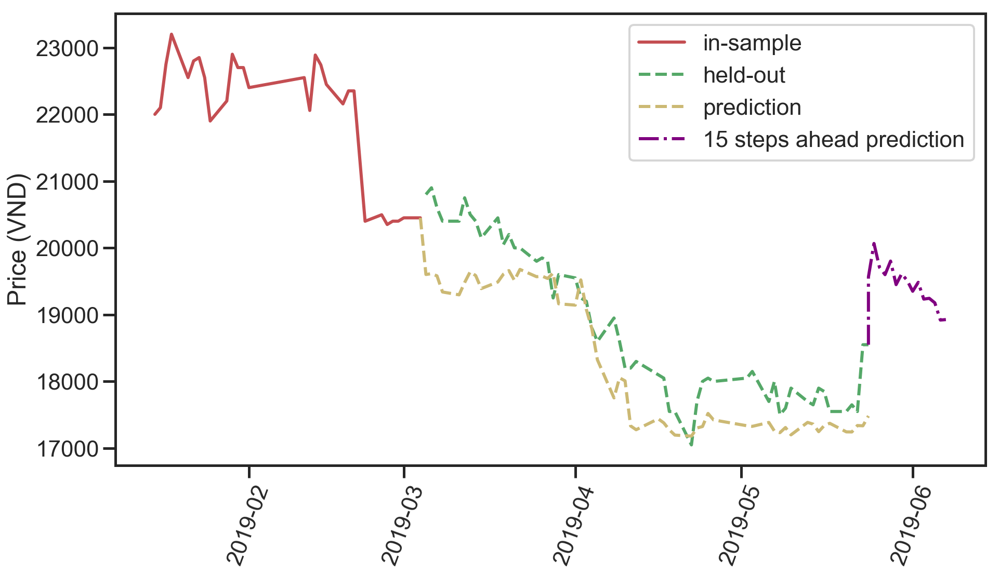

(3, 4, 1)
Testing result: {'mse': 258657.92379175528, 'rmse': 508.5842347062631, 'mae': 396.8160866036207, 'mape': 2.117850133596537, 'lags': 3, 'hidden layers': (4, 1)}


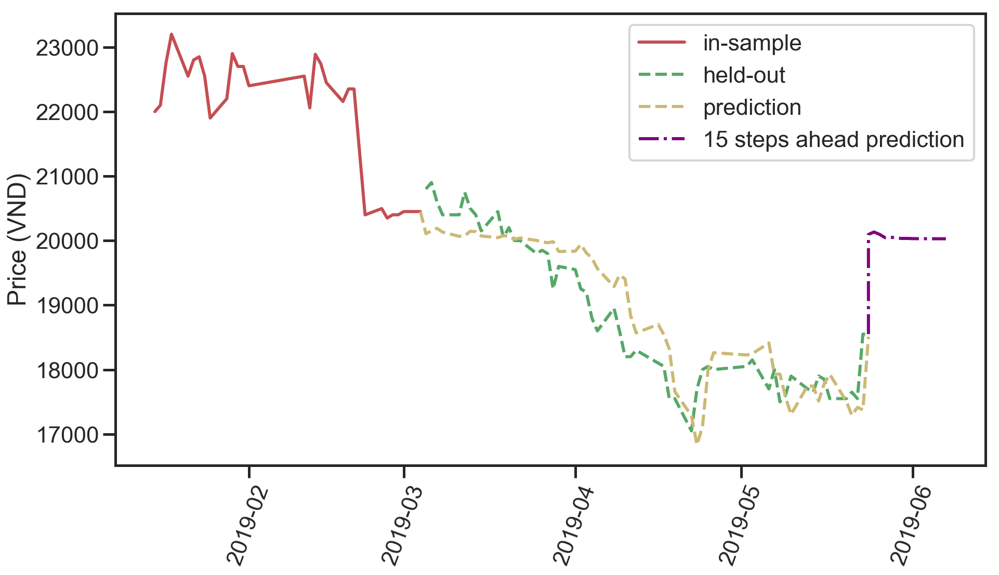

(3, 4, 2)
Testing result: {'mse': 357505.4129466787, 'rmse': 597.9175636713466, 'mae': 493.52619736403415, 'mape': 2.6259455694974525, 'lags': 3, 'hidden layers': (4, 2)}


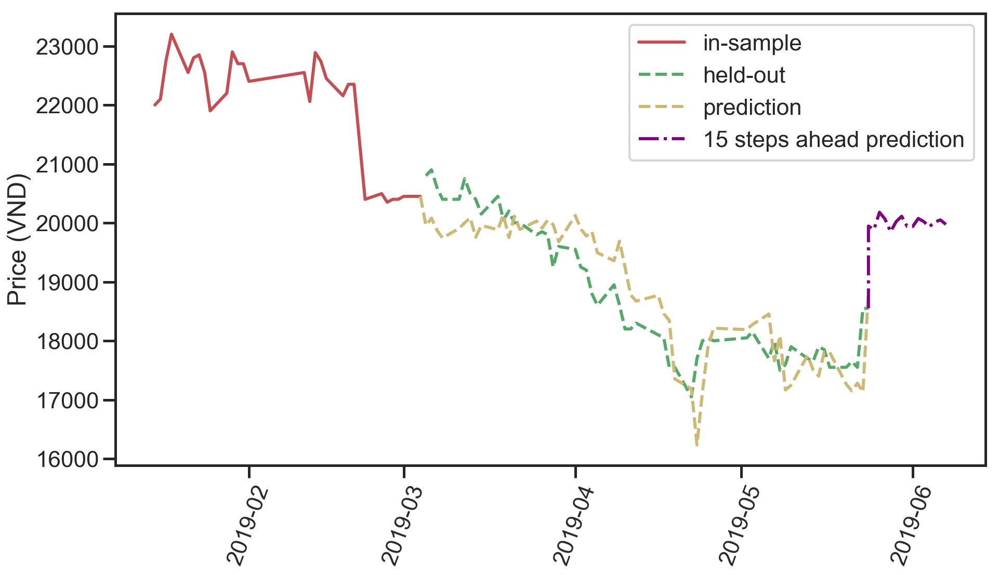

(3, 4, 2)
Testing result: {'mse': 357505.4129466787, 'rmse': 597.9175636713466, 'mae': 493.52619736403415, 'mape': 2.6259455694974525, 'lags': 3, 'hidden layers': (4, 2)}


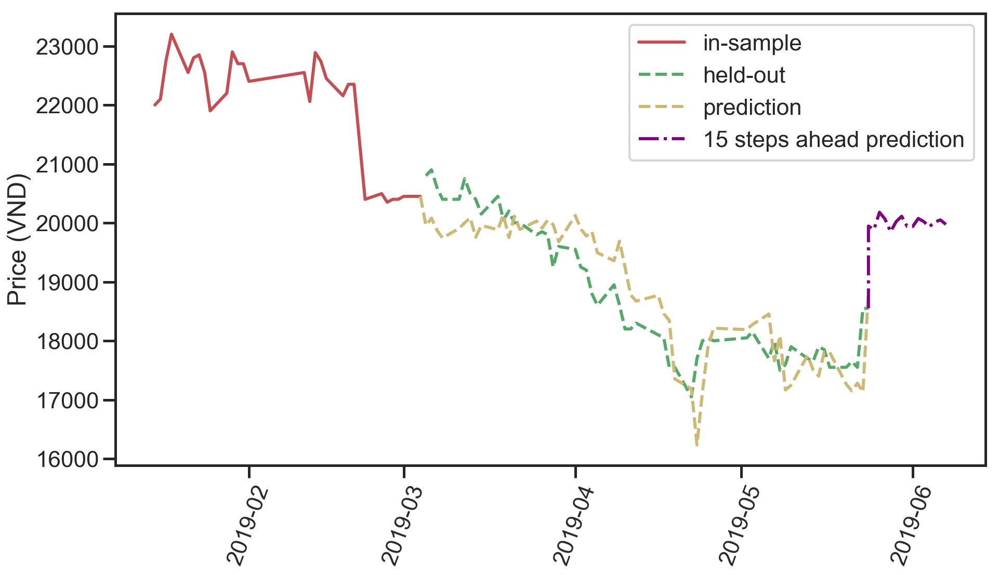

(3, 4, 3)
Testing result: {'mse': 376103.360709107, 'rmse': 613.2726642441411, 'mae': 510.385938738489, 'mape': 2.788763226080041, 'lags': 3, 'hidden layers': (4, 3)}


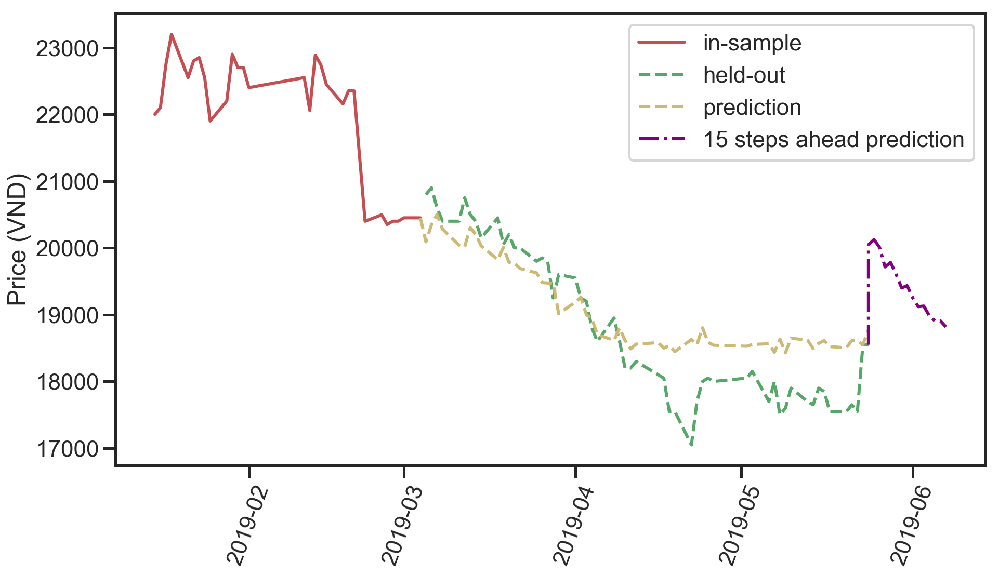

(3, 4, 3)
Testing result: {'mse': 376103.360709107, 'rmse': 613.2726642441411, 'mae': 510.385938738489, 'mape': 2.788763226080041, 'lags': 3, 'hidden layers': (4, 3)}


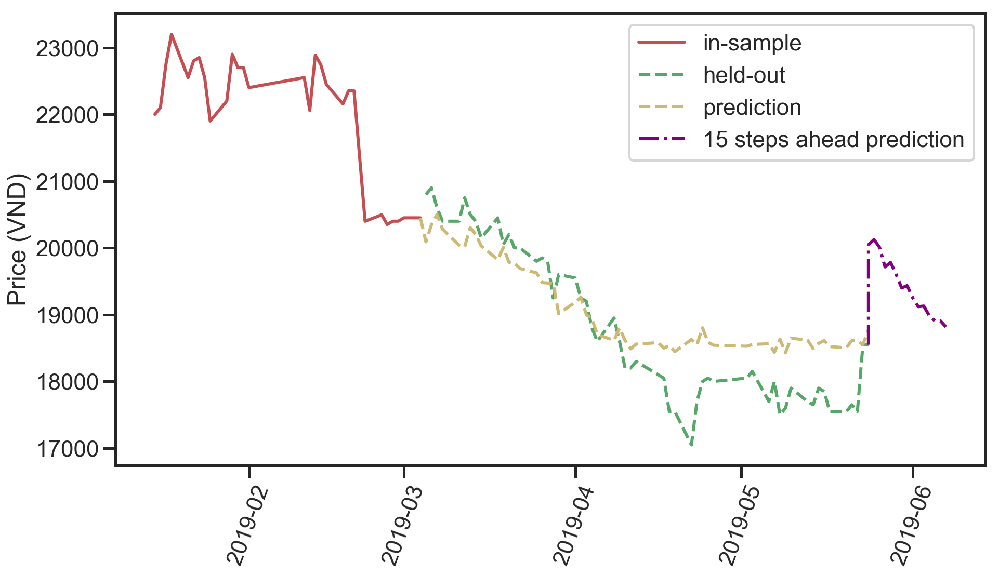

(3, 5, 1)
Testing result: {'mse': 1932293.3664056219, 'rmse': 1390.069554520788, 'mae': 1189.3366572751372, 'mape': 6.1346253097339165, 'lags': 3, 'hidden layers': (5, 1)}


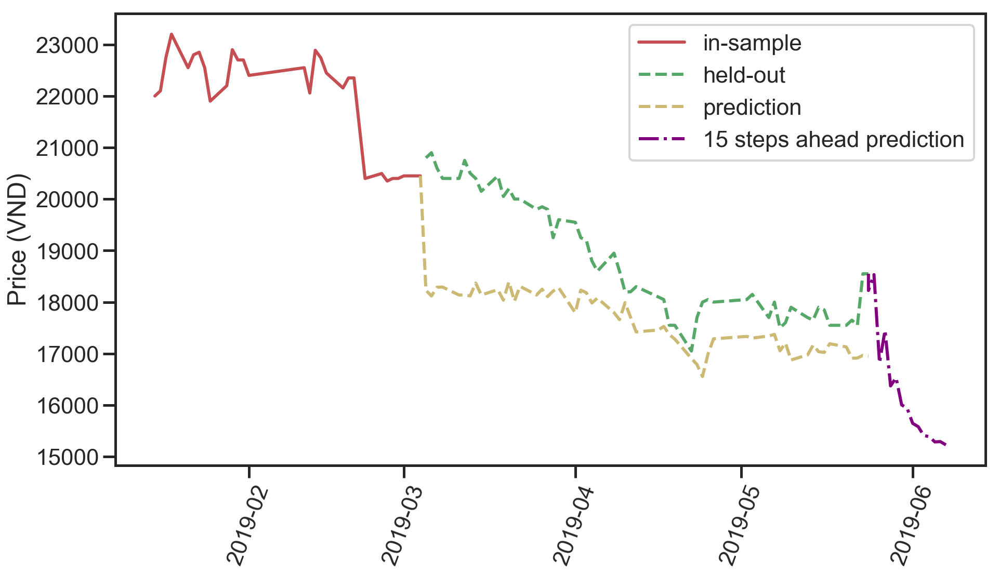

(3, 5, 2)
Testing result: {'mse': 469402.1108002477, 'rmse': 685.1292657595701, 'mae': 608.1337382852444, 'mape': 3.2286049274056365, 'lags': 3, 'hidden layers': (5, 2)}


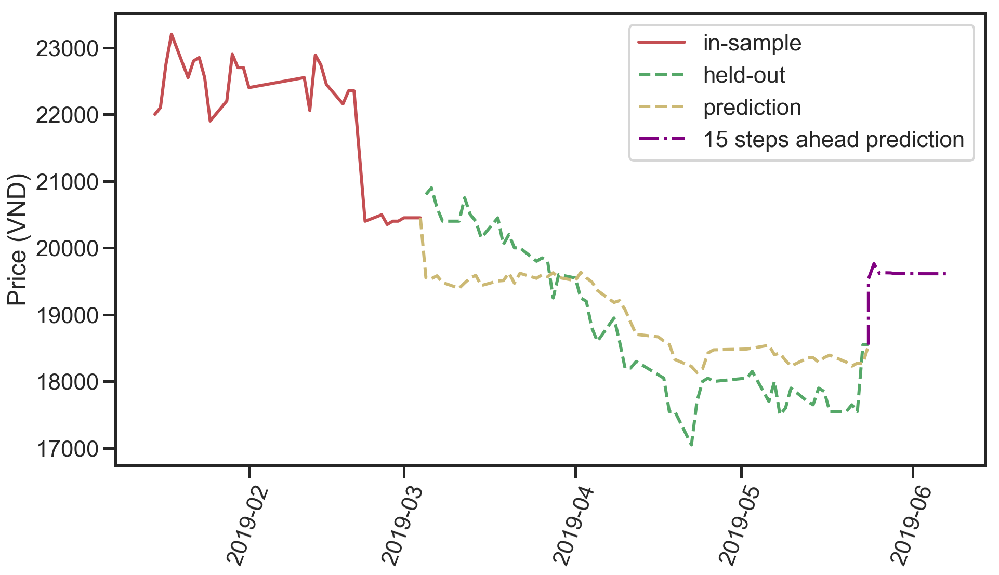

(3, 5, 2)
Testing result: {'mse': 469402.1108002477, 'rmse': 685.1292657595701, 'mae': 608.1337382852444, 'mape': 3.2286049274056365, 'lags': 3, 'hidden layers': (5, 2)}


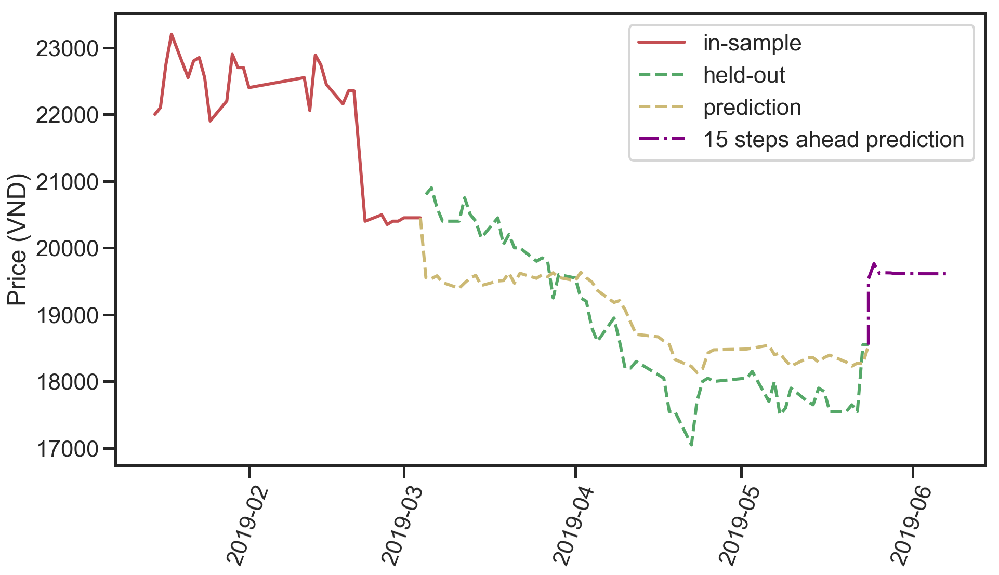

(3, 5, 3)
Testing result: {'mse': 1679411.262752738, 'rmse': 1295.9210094572654, 'mae': 1220.985156685252, 'mape': 6.42497347570495, 'lags': 3, 'hidden layers': (5, 3)}


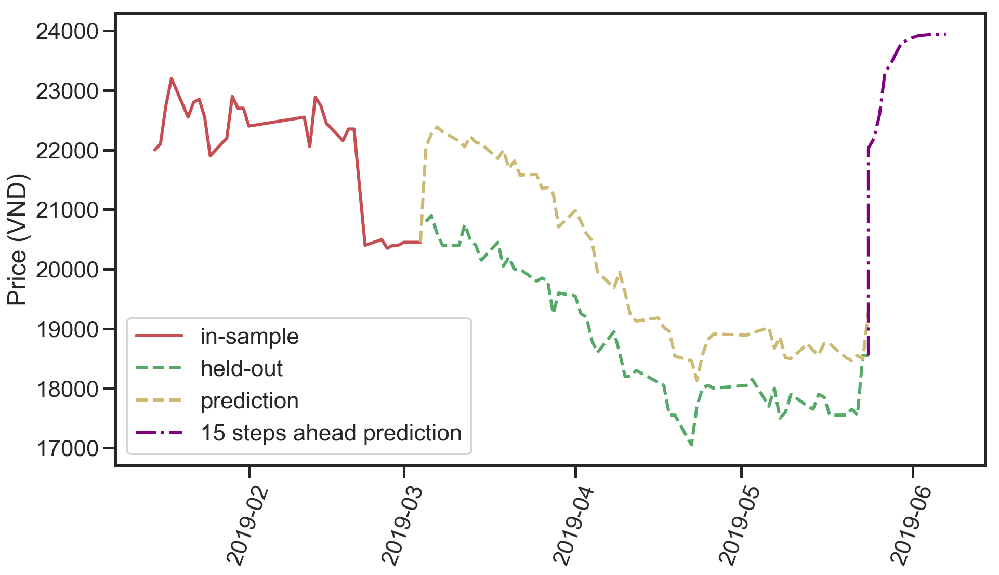

(3, 5, 3)
Testing result: {'mse': 1679411.262752738, 'rmse': 1295.9210094572654, 'mae': 1220.985156685252, 'mape': 6.42497347570495, 'lags': 3, 'hidden layers': (5, 3)}


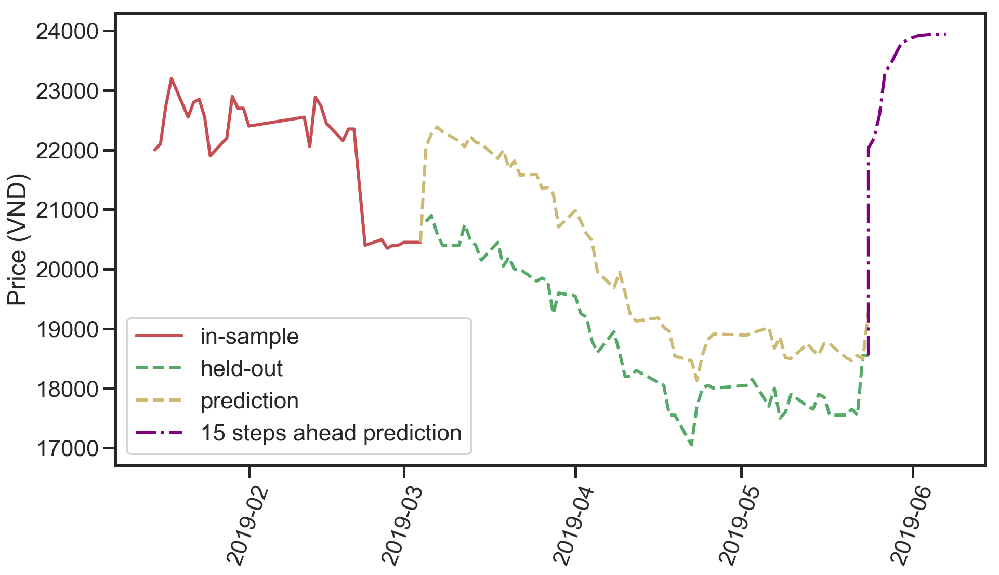

(3, 6, 1)
Testing result: {'mse': 10028499.867347762, 'rmse': 3166.7806787568607, 'mae': 2897.4694944353937, 'mape': 15.852364275829148, 'lags': 3, 'hidden layers': (6, 1)}


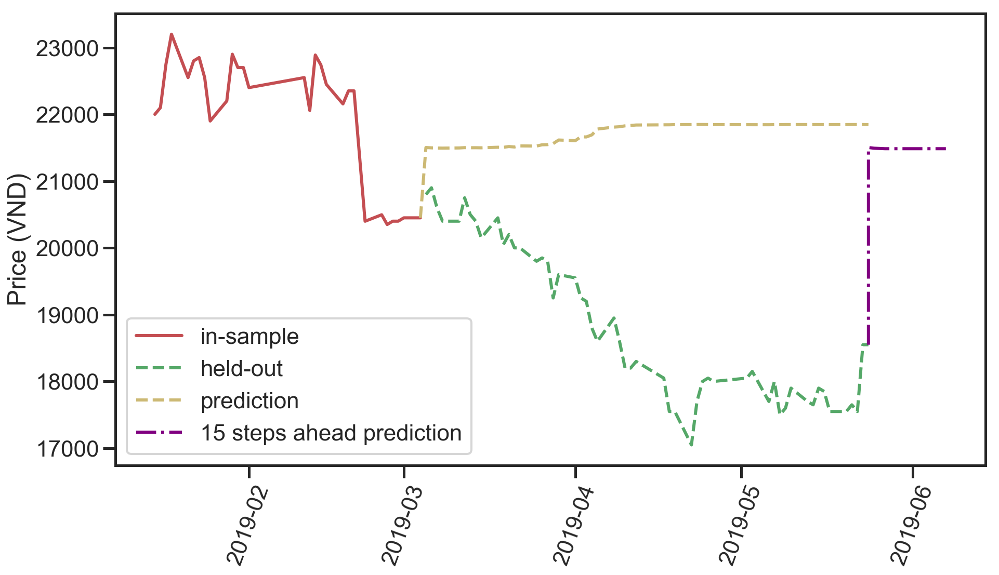

(3, 6, 2)
Testing result: {'mse': 2324805.171047719, 'rmse': 1524.7311799290126, 'mae': 1383.857376560198, 'mape': 7.570948822669732, 'lags': 3, 'hidden layers': (6, 2)}


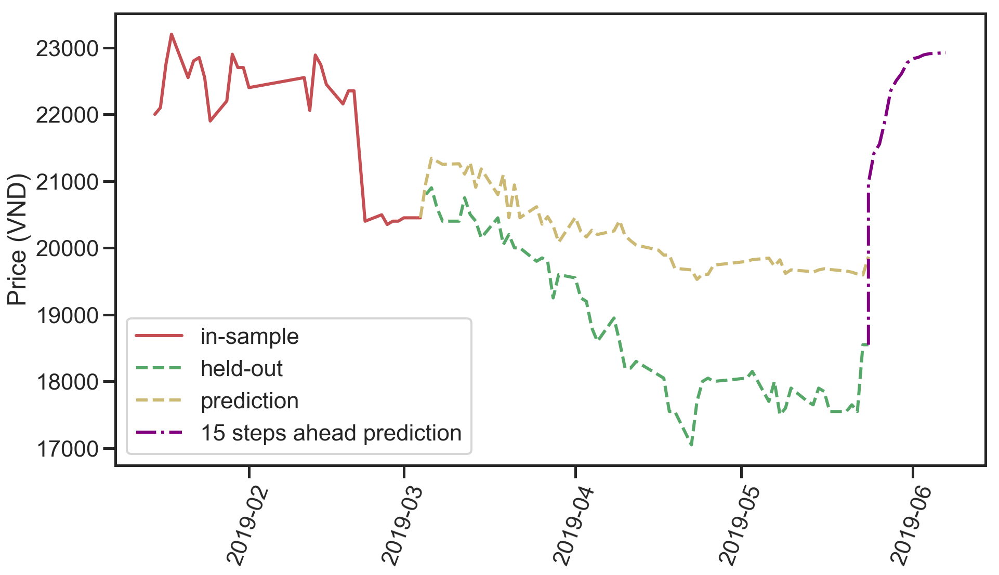

(3, 6, 2)
Testing result: {'mse': 2324805.171047719, 'rmse': 1524.7311799290126, 'mae': 1383.857376560198, 'mape': 7.570948822669732, 'lags': 3, 'hidden layers': (6, 2)}


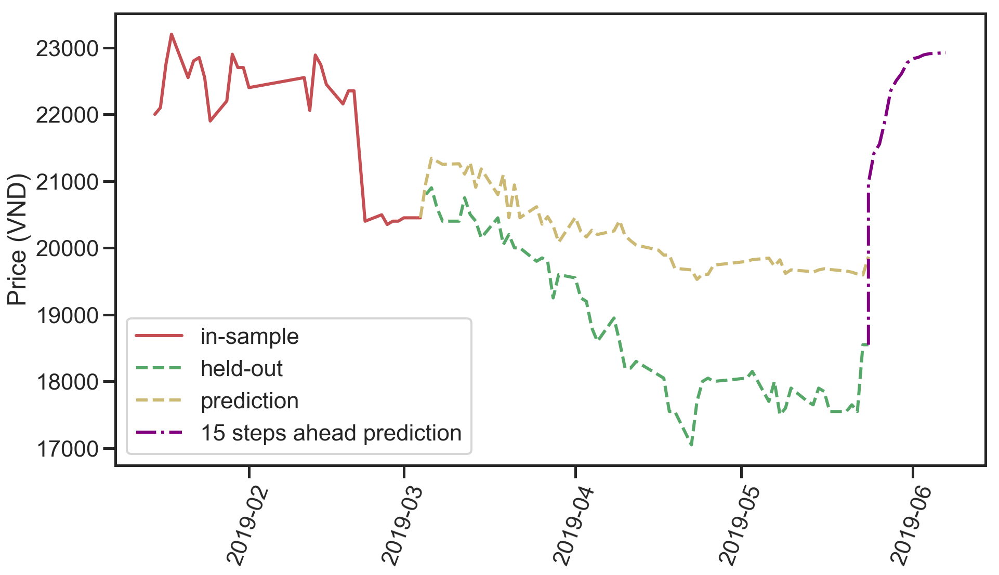

(3, 6, 3)
Testing result: {'mse': 453787.984916789, 'rmse': 673.637873725037, 'mae': 578.5168538057576, 'mape': 3.061923971999528, 'lags': 3, 'hidden layers': (6, 3)}


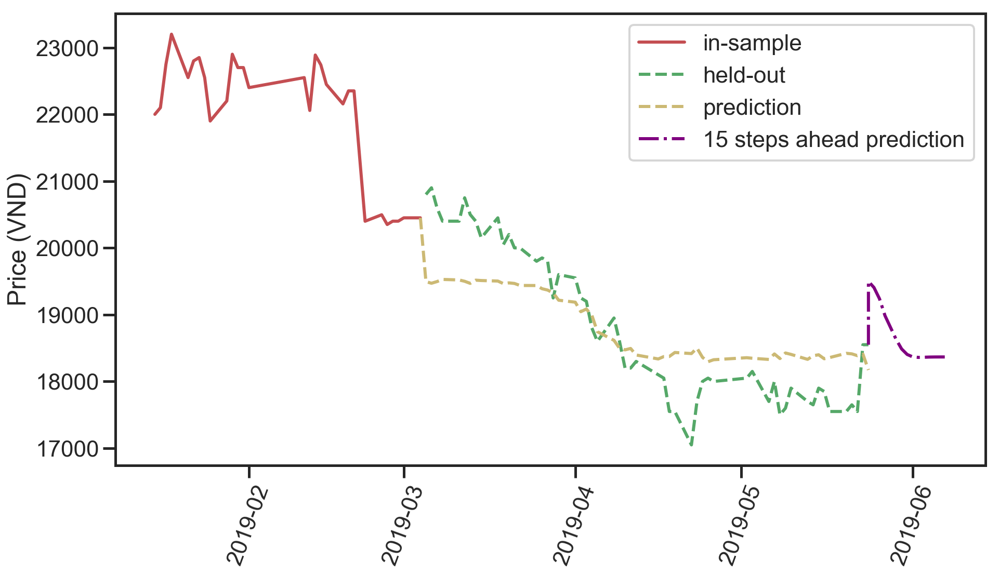

(3, 6, 3)
Testing result: {'mse': 453787.984916789, 'rmse': 673.637873725037, 'mae': 578.5168538057576, 'mape': 3.061923971999528, 'lags': 3, 'hidden layers': (6, 3)}


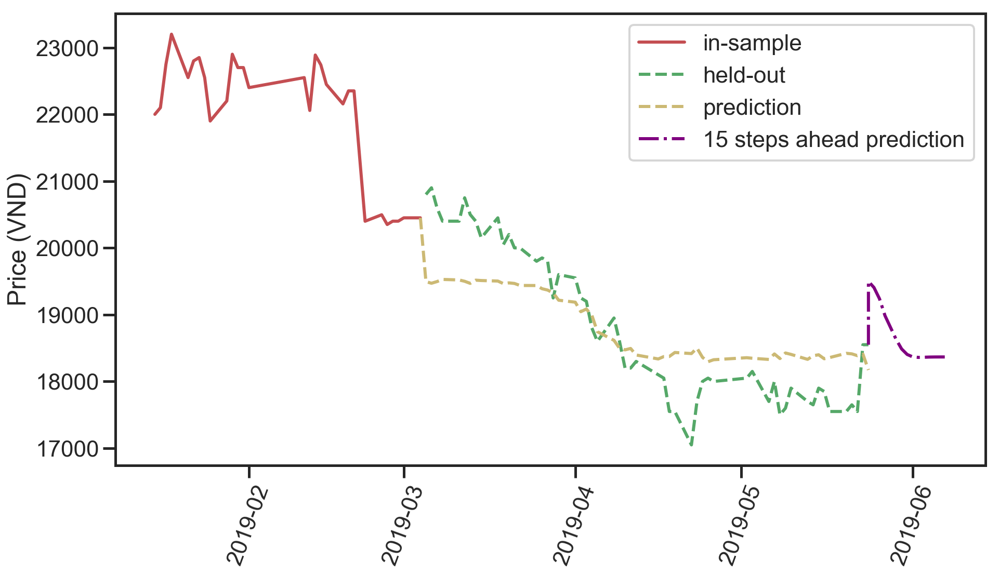

(3, 7, 1)
Testing result: {'mse': 1217048.8476285958, 'rmse': 1103.1993689395383, 'mae': 892.1836094809329, 'mape': 4.949052726409667, 'lags': 3, 'hidden layers': (7, 1)}


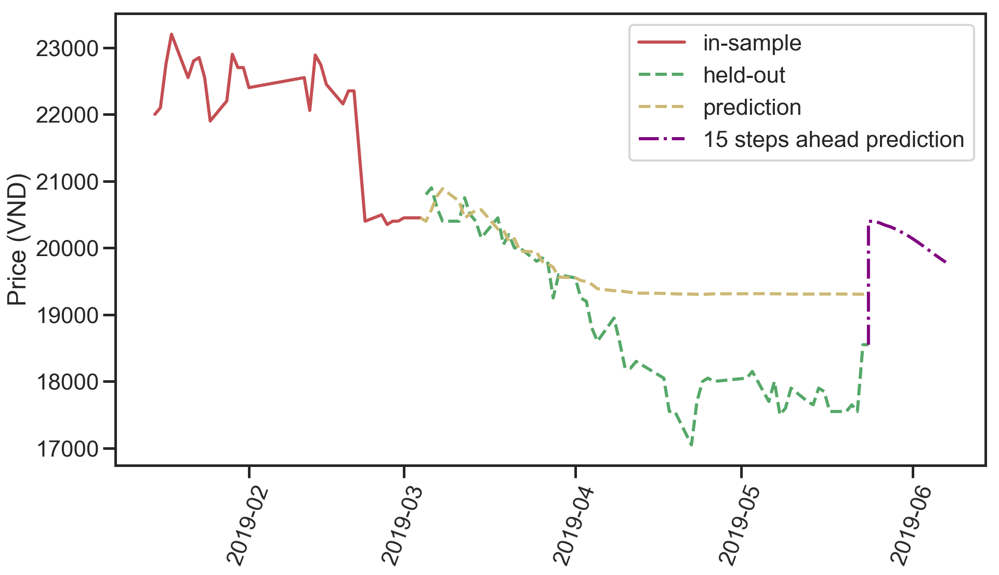

(3, 7, 2)
Testing result: {'mse': 435056.5677861942, 'rmse': 659.588180447614, 'mae': 557.3770444372125, 'mape': 3.035872129977336, 'lags': 3, 'hidden layers': (7, 2)}


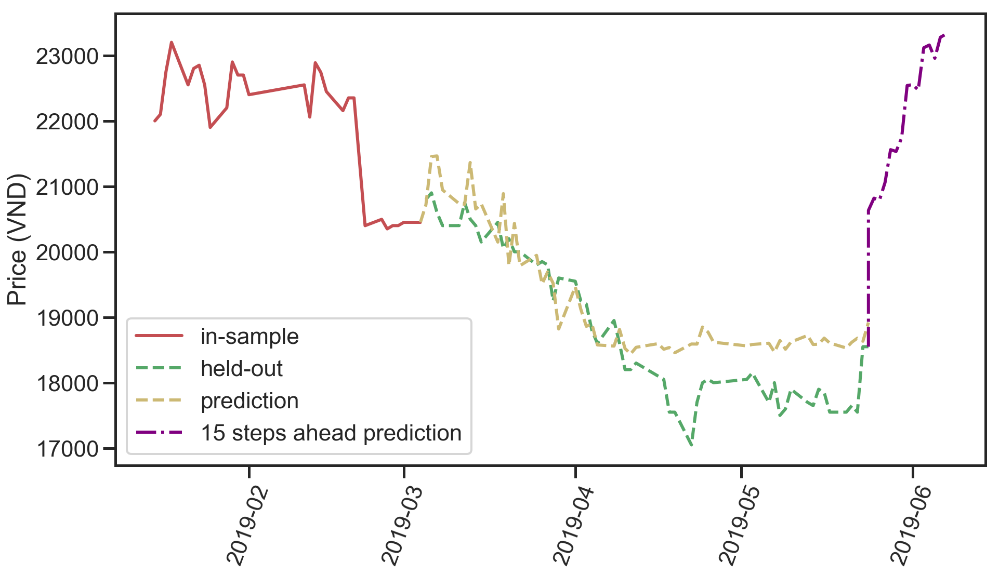

(3, 7, 2)
Testing result: {'mse': 435056.5677861942, 'rmse': 659.588180447614, 'mae': 557.3770444372125, 'mape': 3.035872129977336, 'lags': 3, 'hidden layers': (7, 2)}


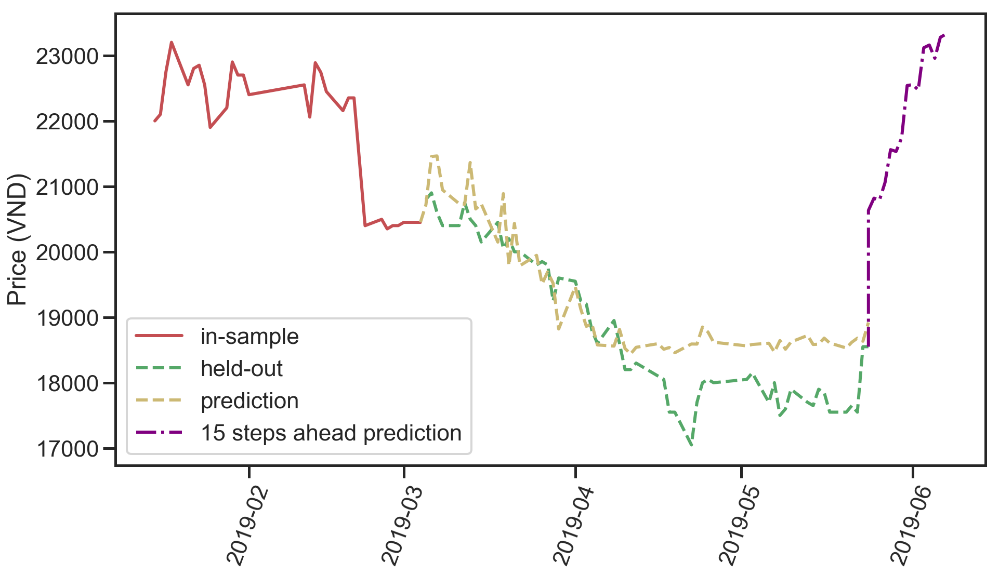

(3, 7, 3)
Testing result: {'mse': 129266.06163850013, 'rmse': 359.5358975658761, 'mae': 274.37328767705685, 'mape': 1.4488947490167137, 'lags': 3, 'hidden layers': (7, 3)}


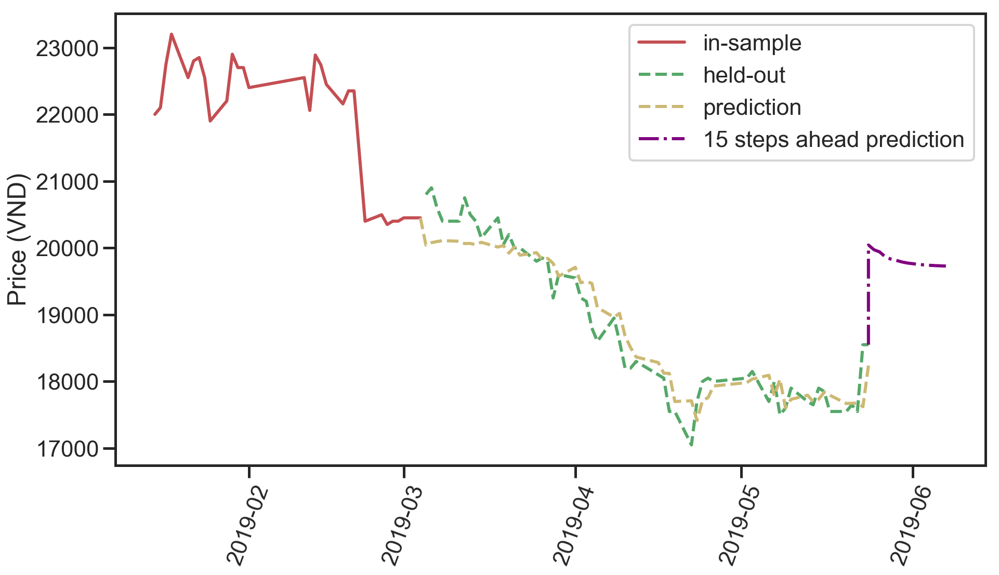

(3, 7, 3)
Testing result: {'mse': 129266.06163850013, 'rmse': 359.5358975658761, 'mae': 274.37328767705685, 'mape': 1.4488947490167137, 'lags': 3, 'hidden layers': (7, 3)}


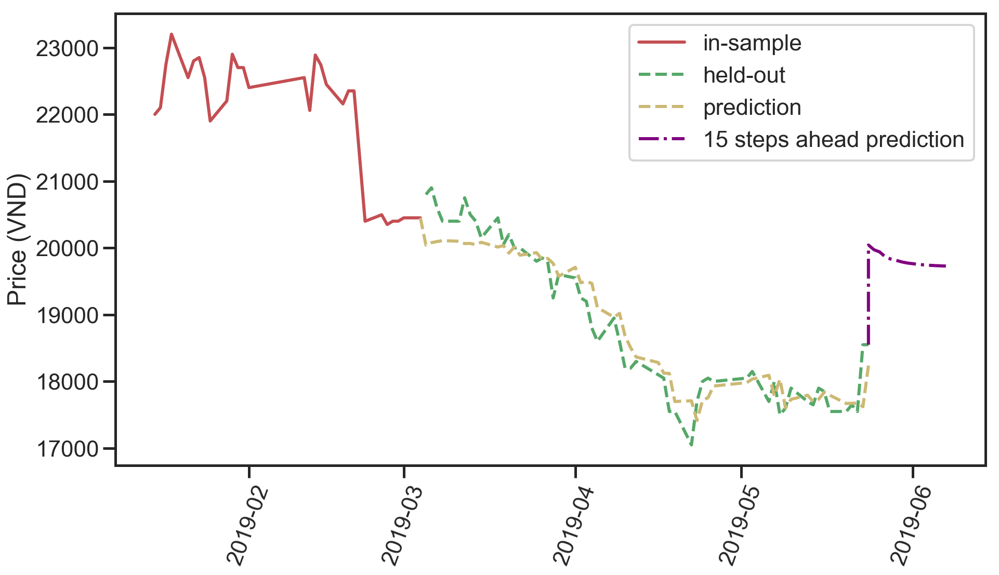

In [41]:
lags = range(1,4)
hl = range(3,8)
lst_ann_param = gen_ann(lags, hl)
lst_result = []
print(ticket)
for ann_param in lst_ann_param:
    print(ann_param)
    result = run_model_with_parameters(train, test, model_selection='ANN',
                                       lag=ann_param[0], hidden_layers=ann_param[1:])
    time.sleep(1)
    if result['status']:
        _result = result['test_evaluation']
        _result['lags'] = ann_param[0]
        _result['hidden layers'] = ann_param[1:]
        lst_result.append(_result)
        print('Testing result:', result['test_evaluation'])
        validation = result['model'].validate(test)
        predict_ahead = result['model'].predict_multi_step_ahead(start=test.index[-1], steps=15)
        fig, ax1 = plt.subplots(nrows=1, ncols=1, figsize=(15, 8))
        ax1.plot(train[-30:], label='in-sample', color='r', linestyle='-')
        ax1.plot(test, label='held-out', color='g', linestyle='--')
        ax1.plot(validation, label='predicted held-out', color='y', linestyle='--')
        ax1.plot(predict_ahead, label='15 steps ahead prediction', color='purple', linestyle='-.')
        plt.xticks(rotation=70)
        plt.ylabel('Price (VND)')
        plt.legend(['in-sample','held-out', 'prediction', '15 steps ahead prediction'])
#         plt.title('Model evaluation of ' + ticket)
        plt.show()
    else:
        print('None')

In [42]:
df_result = pd.DataFrame(data=lst_result)
df_result = df_result.drop_duplicates(['lags','hidden layers'], keep='first')
df_result = df_result.set_index(['lags', 'hidden layers'])
lst_metric = ['mae','mape','mse','rmse']
df_result = df_result[lst_metric].round(3)
df_result.to_csv('pnj_ann_result.csv', index=True)
df_result

mae     mape            mse       rmse
lags hidden layers                                              
1    (3, 1)        1072.44800  5.75700  1365208.34000 1168.42100
     (3, 2)         733.36200  3.87800   674963.80300  821.56200
     (3, 3)         457.27700  2.48700   282118.62400  531.14800
     (4, 1)        2374.12400 12.33500  6721493.05500 2592.58400
     (4, 2)         591.52900  3.14500   441092.15900  664.14800
     (4, 3)         259.71300  1.38500   112765.53800  335.80600
     (5, 1)        1052.86200  5.57800  1343022.57000 1158.88900
     (5, 2)         628.58700  3.41600   521919.83000  722.44000
     (5, 3)         678.39400  3.49600   738926.12000  859.60800
     (6, 1)        1307.93000  7.22900  2464171.47300 1569.76800
     (6, 2)         691.75700  3.56500   695599.99700  834.02600
     (6, 3)         211.85300  1.13700    76176.68700  276.00100
     (7, 1)         995.87000  5.24700  1240238.52600 1113.66000
     (7, 2)        1781.47000  9.60600  3328135.21900 1824.31800
     (7, 3)         247.30800  1.31600    94697.84300  307.73000
2    (3, 1)        3083.61900 15.89900 12567157.57200 3545.01900
     (3, 2)        1655.61100  8.55700  3876472.22700 1968.87600
     (3, 3)         722.30900  3.89800   665623.23200  815.85700
     (4, 1)        1294.51600  6.59700  2648685.45300 1627.47800
     (4, 2)        1479.55400  8.16700  3082424.55500 1755.68400
     (4, 3)        2178.61000 11.23800  6223487.32100 2494.69200
     (5, 1)         246.06100  1.31500   105964.16500  325.52100
     (5, 2)         512.53600  2.80900   385886.67700  621.19800
     (5, 3)         290.63600  1.55700   133853.79400  365.86000
     (6, 1)         580.29700  2.99800   538266.80900  733.66700
     (6, 2)         249.72400  1.34000    97252.25800  311.85300
     (6, 3)         280.29800  1.49100   130475.65400  361.21400
     (7, 1)        2397.15000 12.09900 10661613.59600 3265.21300
     (7, 2)         376.11700  1.98900   235565.77500  485.35100
     (7, 3)         249.33800  1.32600   101823.07100  319.09700
3    (3, 1)        1074.00800  5.70800  1379317.49400 1174.44300
     (3, 2)        1291.93300  6.57700  2720563.95800 1649.41300
     (3, 3)         579.26400  3.04000   451711.51500  672.09500
     (4, 1)         396.81600  2.11800   258657.92400  508.58400
     (4, 2)         493.52600  2.62600   357505.41300  597.91800
     (4, 3)         510.38600  2.78900   376103.36100  613.27300
     (5, 1)        1189.33700  6.13500  1932293.36600 1390.07000
     (5, 2)         608.13400  3.22900   469402.11100  685.12900
     (5, 3)        1220.98500  6.42500  1679411.26300 1295.92100
     (6, 1)        2897.46900 15.85200 10028499.86700 3166.78100
     (6, 2)        1383.85700  7.57100  2324805.17100 1524.73100
     (6, 3)         578.51700  3.06200   453787.98500  673.63800
     (7, 1)         892.18400  4.94900  1217048.84800 1103.19900
     (7, 2)         557.37700  3.03600   435056.56800  659.58800
     (7, 3)         274.37300  1.44900   129266.06200  359.53600

PNJ
(1, 3, 1)
Testing result: {'mse': 6954875.29310321, 'rmse': 2637.209755234348, 'mae': 2428.924944892714, 'mape': 2.4073737716673955, 'lags': 1, 'hidden layers': (3, 1)}


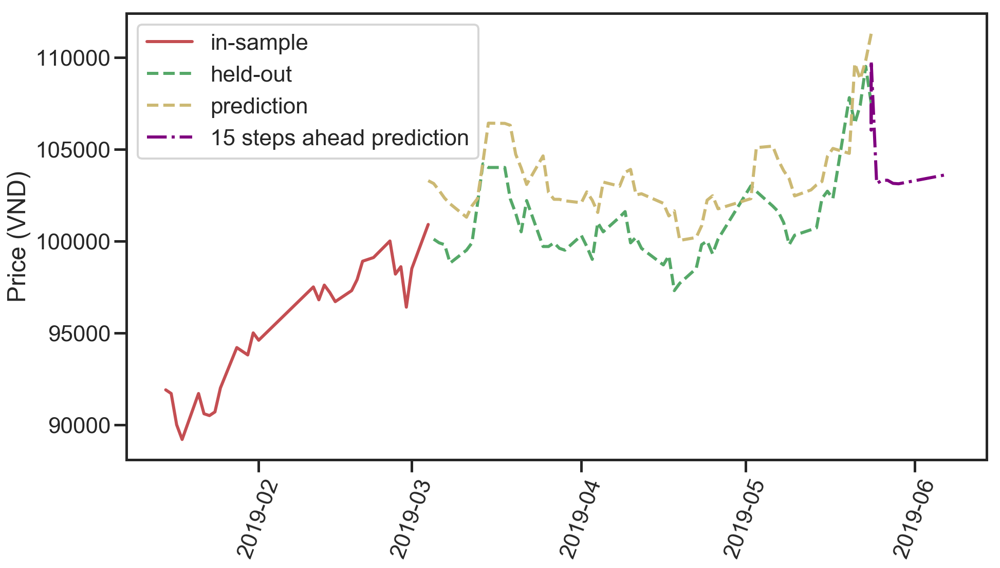

(1, 3, 2)
Testing result: {'mse': 7996172.614361396, 'rmse': 2827.7504512176097, 'mae': 2625.556905804959, 'mape': 2.604546942090566, 'lags': 1, 'hidden layers': (3, 2)}


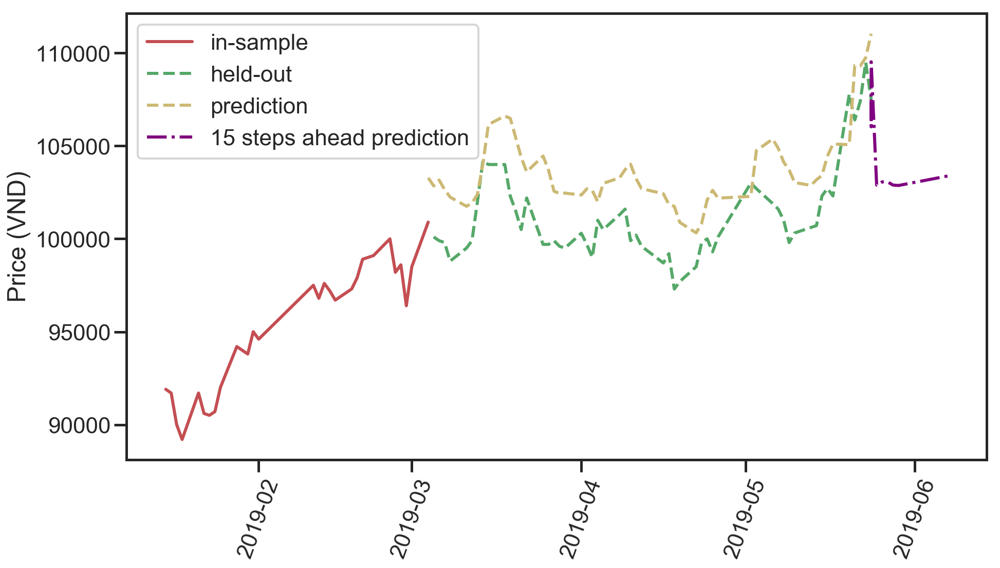

(1, 3, 2)
Testing result: {'mse': 7996172.614361396, 'rmse': 2827.7504512176097, 'mae': 2625.556905804959, 'mape': 2.604546942090566, 'lags': 1, 'hidden layers': (3, 2)}


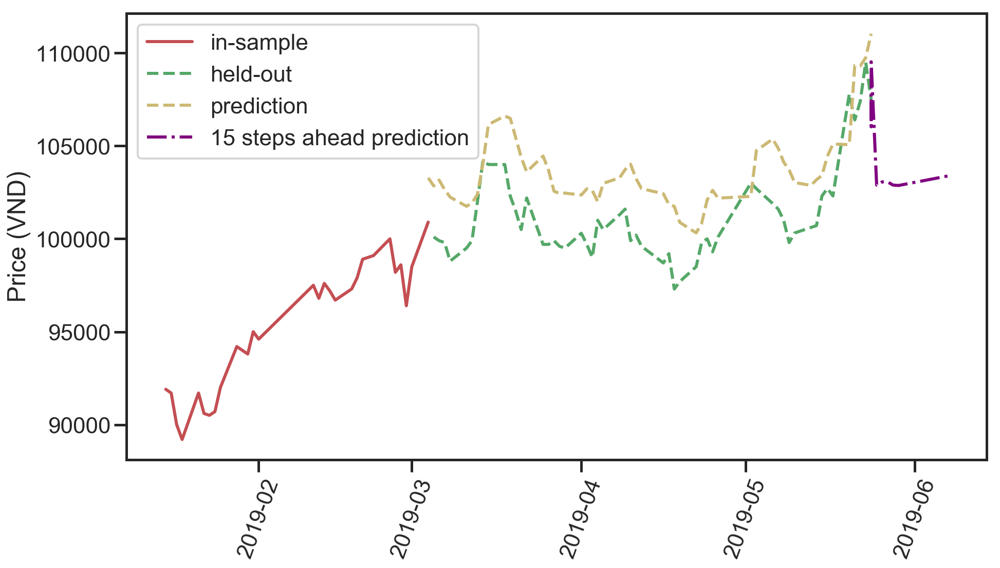

(1, 3, 3)
Testing result: {'mse': 4986832.706835858, 'rmse': 2233.121740263136, 'mae': 1927.5392653283263, 'mape': 1.9053423616291614, 'lags': 1, 'hidden layers': (3, 3)}


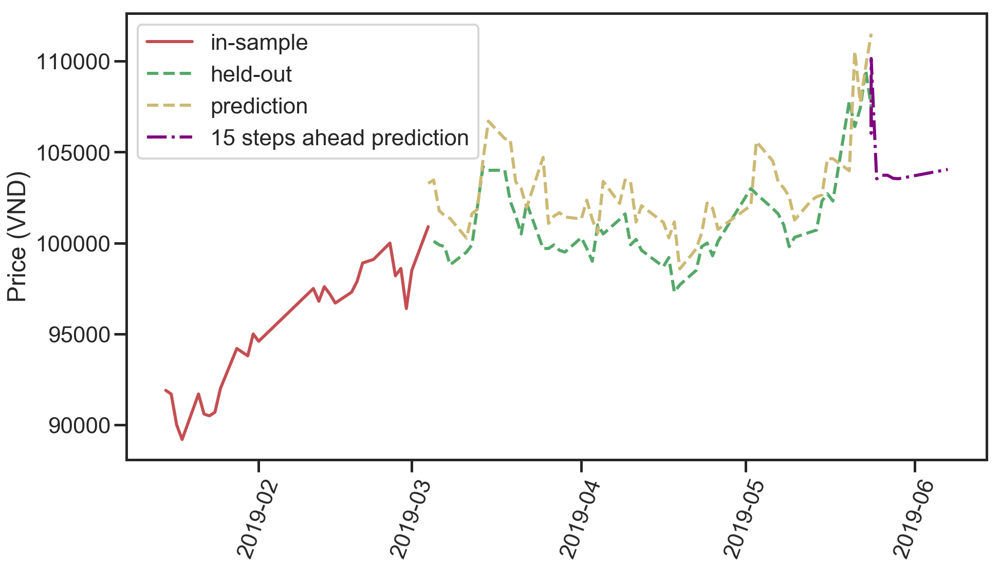

(1, 3, 3)
Testing result: {'mse': 4986832.706835858, 'rmse': 2233.121740263136, 'mae': 1927.5392653283263, 'mape': 1.9053423616291614, 'lags': 1, 'hidden layers': (3, 3)}


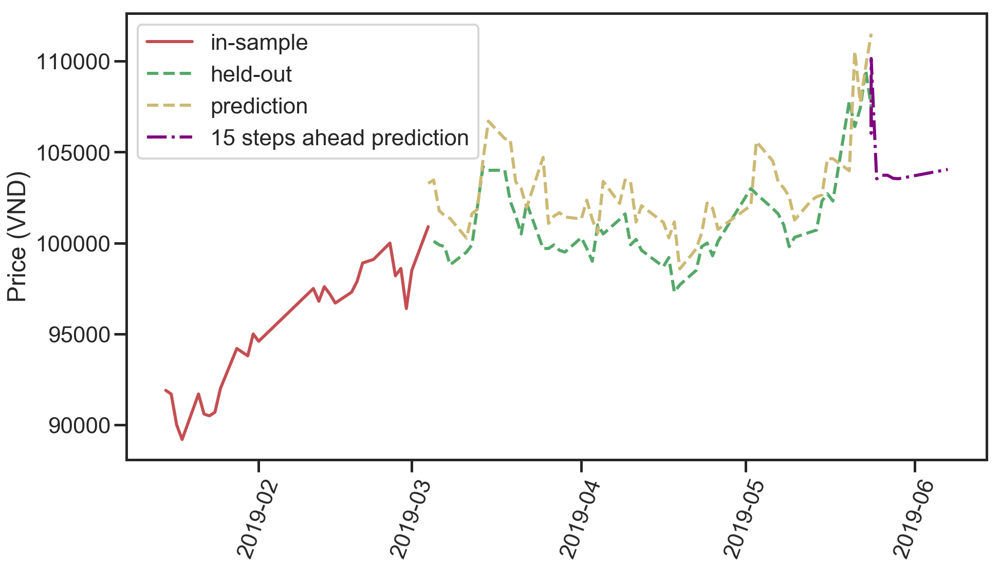

(1, 4, 1)
Testing result: {'mse': 20558899.573037352, 'rmse': 4534.19227349672, 'mae': 4309.2242722410465, 'mape': 4.24902711141101, 'lags': 1, 'hidden layers': (4, 1)}


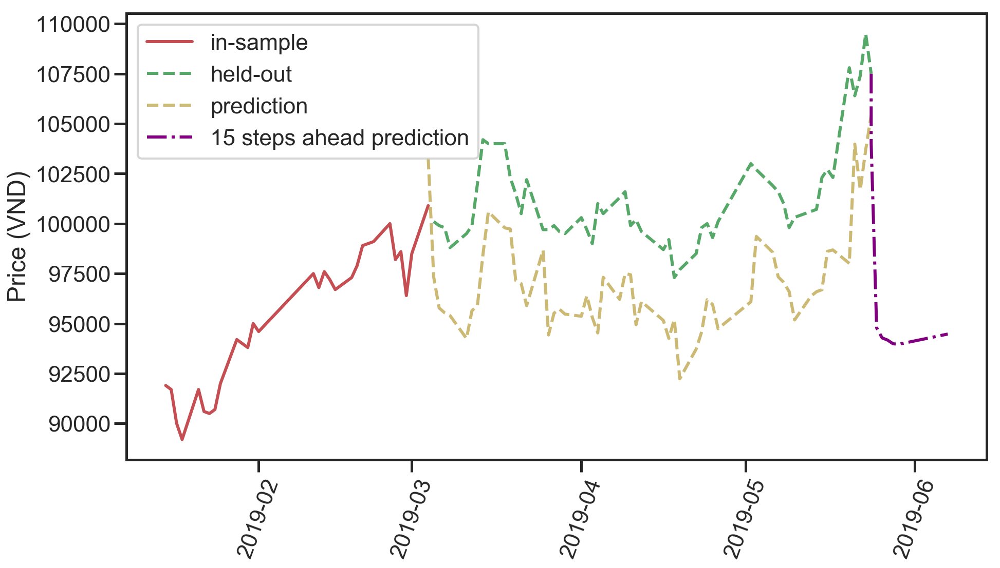

(1, 4, 2)
Testing result: {'mse': 6977066.706855815, 'rmse': 2641.4137704751624, 'mae': 2430.9536748986457, 'mape': 2.410118818799021, 'lags': 1, 'hidden layers': (4, 2)}


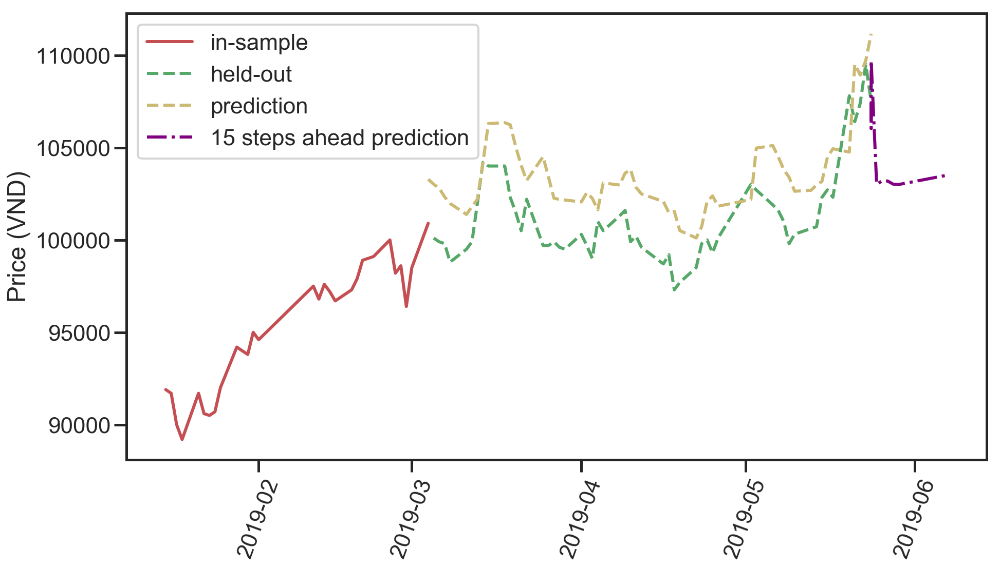

(1, 4, 2)
Testing result: {'mse': 6977066.706855815, 'rmse': 2641.4137704751624, 'mae': 2430.9536748986457, 'mape': 2.410118818799021, 'lags': 1, 'hidden layers': (4, 2)}


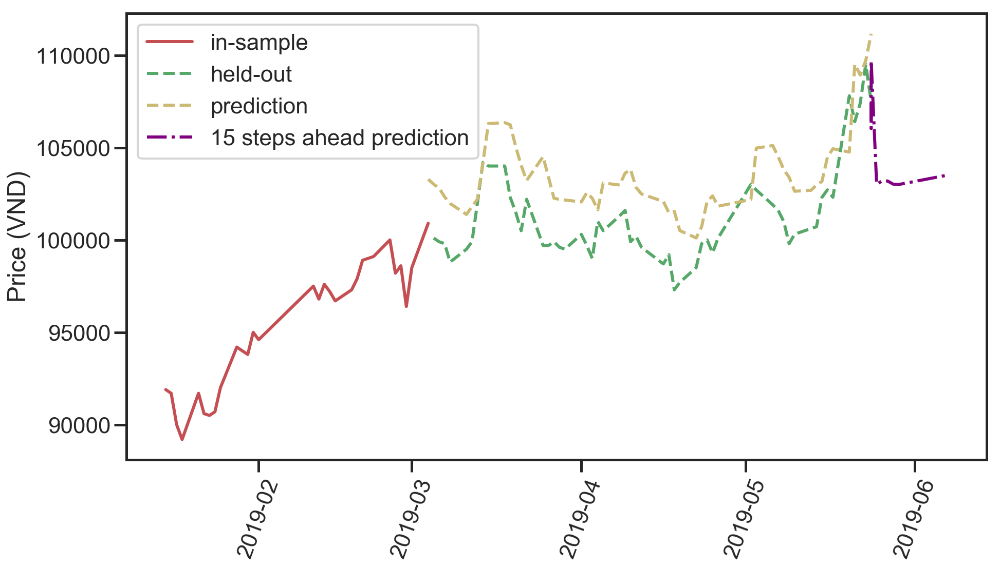

(1, 4, 3)
Testing result: {'mse': 3183248.590460591, 'rmse': 1784.1660770400806, 'mae': 1396.411607242416, 'mape': 1.3730000125788264, 'lags': 1, 'hidden layers': (4, 3)}


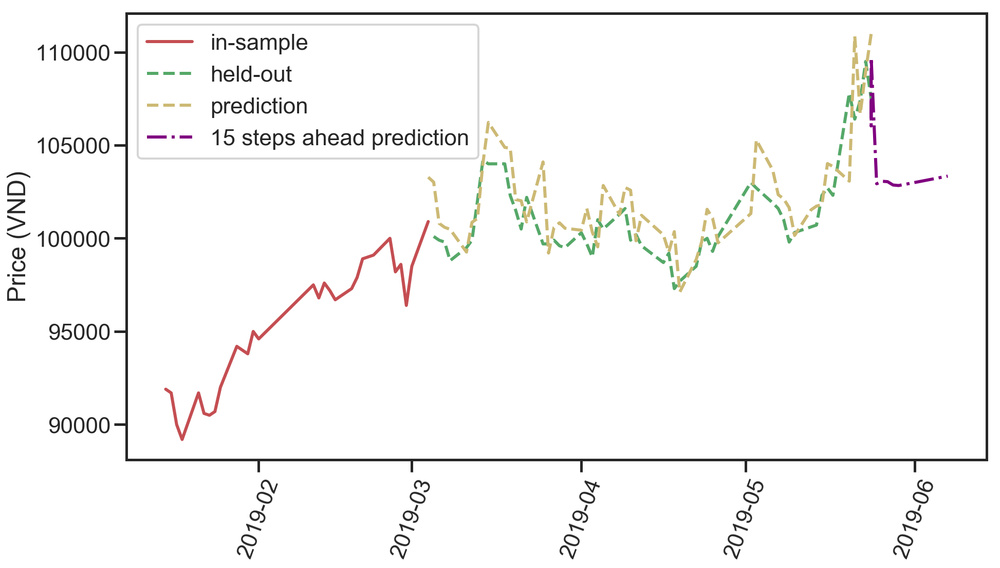

(1, 4, 3)
Testing result: {'mse': 3183248.590460591, 'rmse': 1784.1660770400806, 'mae': 1396.411607242416, 'mape': 1.3730000125788264, 'lags': 1, 'hidden layers': (4, 3)}


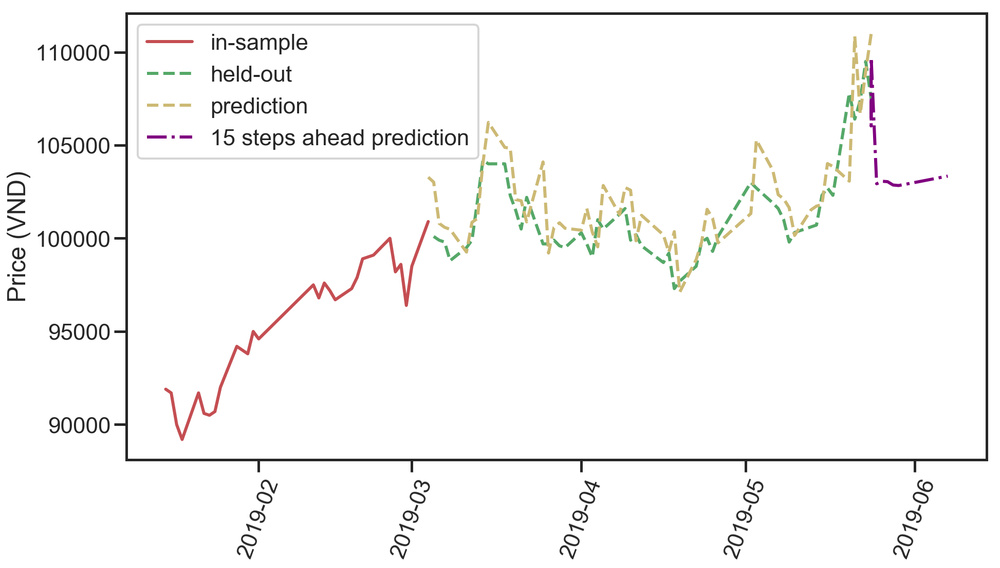

(1, 5, 1)
Testing result: {'mse': 7356837.767367494, 'rmse': 2712.3491234292637, 'mae': 2513.403304363829, 'mape': 2.4932915707653556, 'lags': 1, 'hidden layers': (5, 1)}


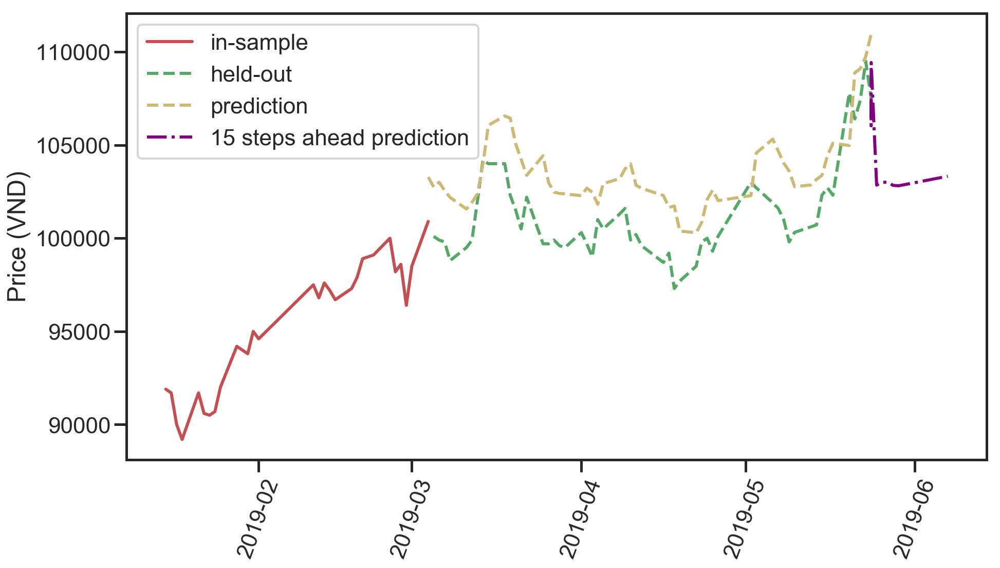

(1, 5, 2)
Testing result: {'mse': 7524859.432595143, 'rmse': 2743.147723436553, 'mae': 2533.6591893856107, 'mape': 2.5121583052406344, 'lags': 1, 'hidden layers': (5, 2)}


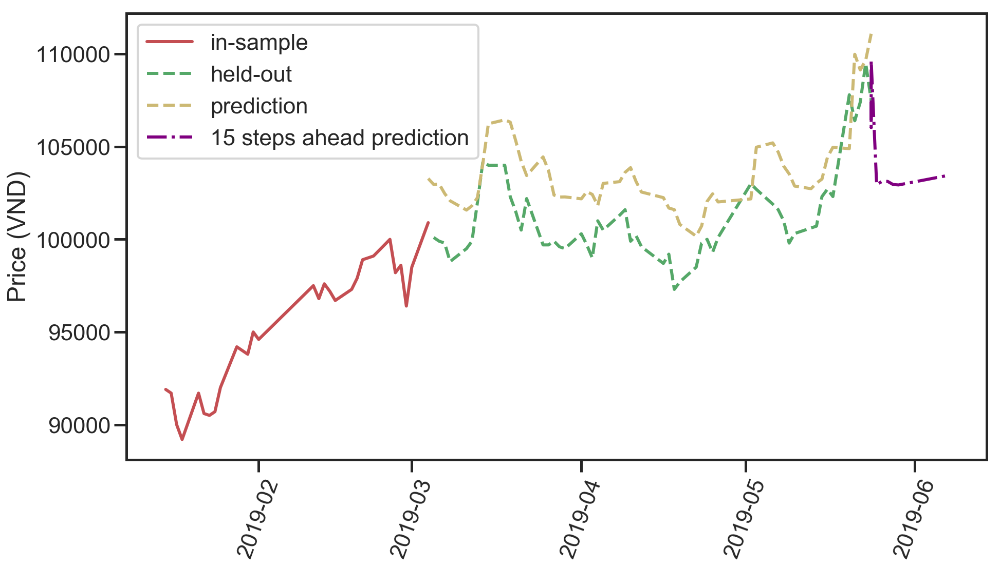

(1, 5, 2)
Testing result: {'mse': 7524859.432595143, 'rmse': 2743.147723436553, 'mae': 2533.6591893856107, 'mape': 2.5121583052406344, 'lags': 1, 'hidden layers': (5, 2)}


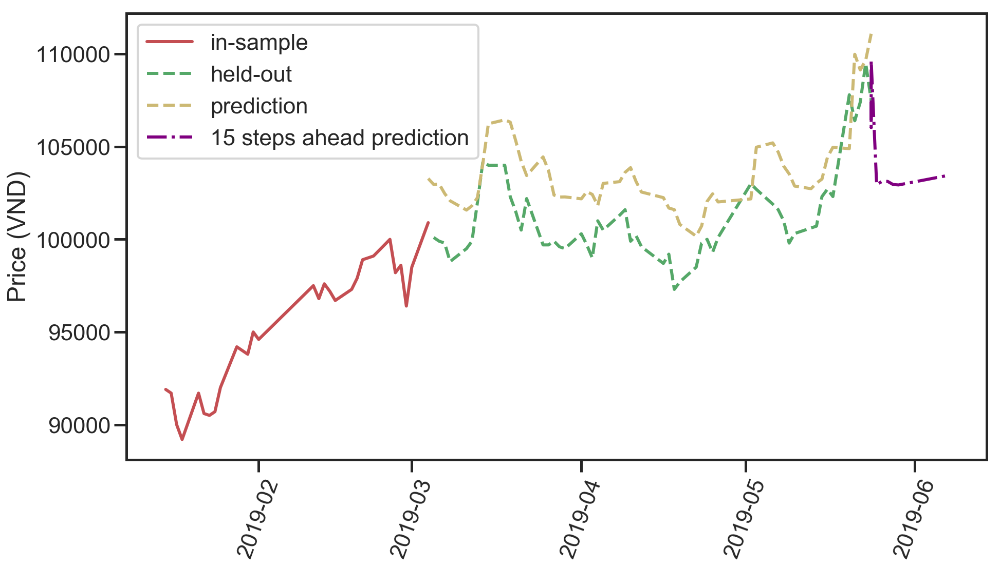

(1, 5, 3)
Testing result: {'mse': 9306704.527820434, 'rmse': 3050.6891889899953, 'mae': 2841.0474467442773, 'mape': 2.820743382672293, 'lags': 1, 'hidden layers': (5, 3)}


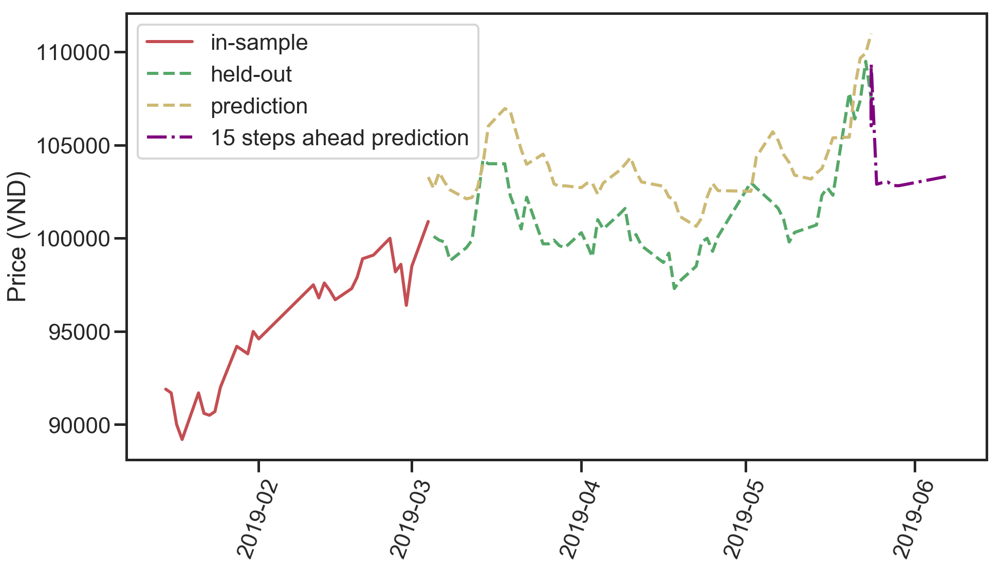

(1, 5, 3)
Testing result: {'mse': 9306704.527820434, 'rmse': 3050.6891889899953, 'mae': 2841.0474467442773, 'mape': 2.820743382672293, 'lags': 1, 'hidden layers': (5, 3)}


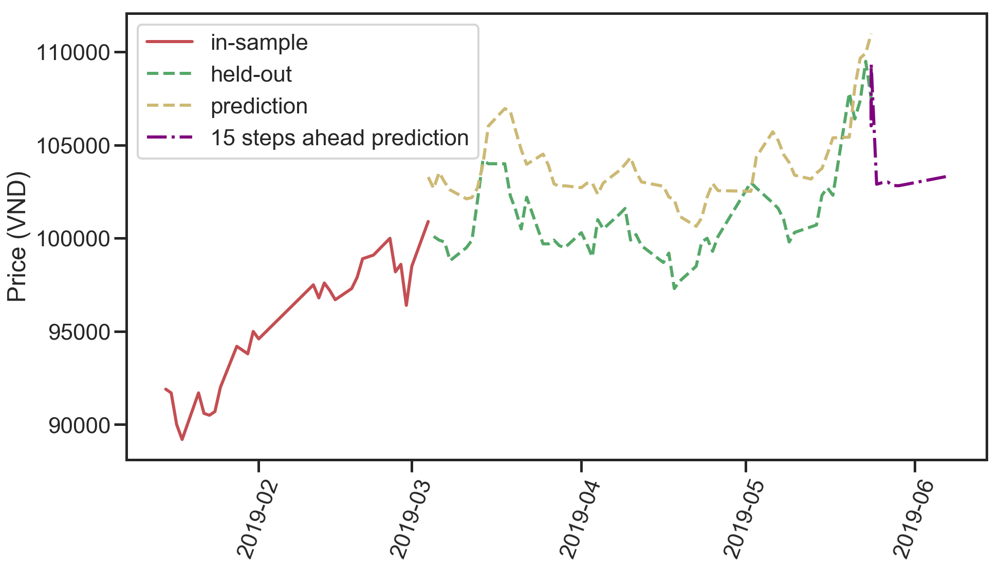

(1, 6, 1)
Testing result: {'mse': 22463648.206232514, 'rmse': 4739.583125785696, 'mae': 4432.335551284897, 'mape': 4.403543300497833, 'lags': 1, 'hidden layers': (6, 1)}


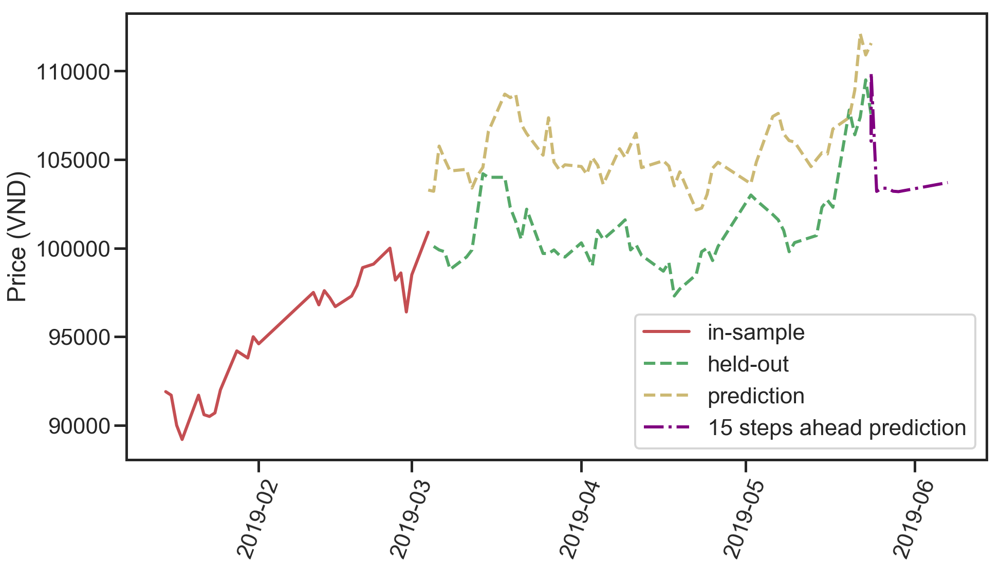

(1, 6, 2)
Testing result: {'mse': 7671775.755253496, 'rmse': 2769.797060301259, 'mae': 2308.3901509661605, 'mape': 2.2726253394148976, 'lags': 1, 'hidden layers': (6, 2)}


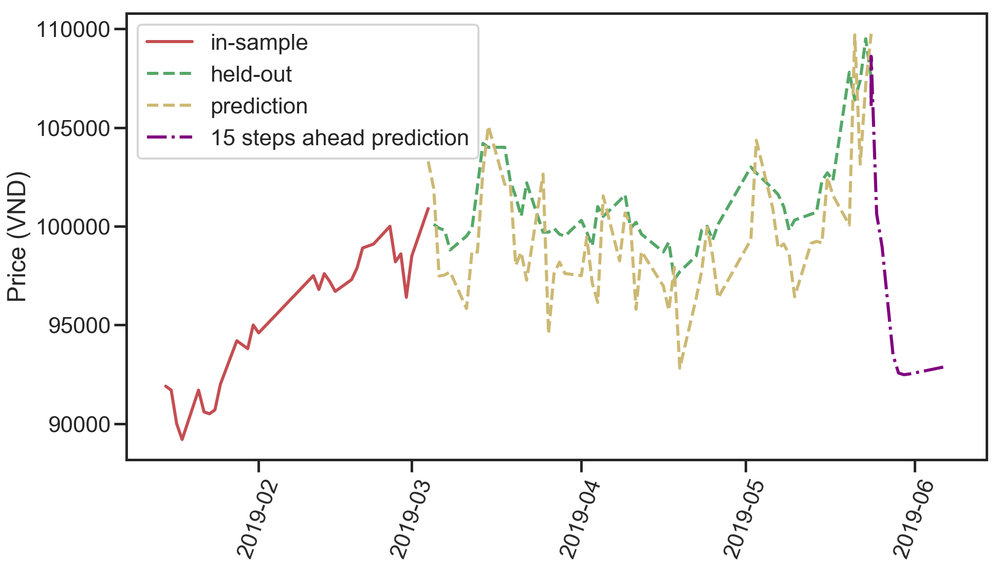

(1, 6, 2)
Testing result: {'mse': 7671775.755253496, 'rmse': 2769.797060301259, 'mae': 2308.3901509661605, 'mape': 2.2726253394148976, 'lags': 1, 'hidden layers': (6, 2)}


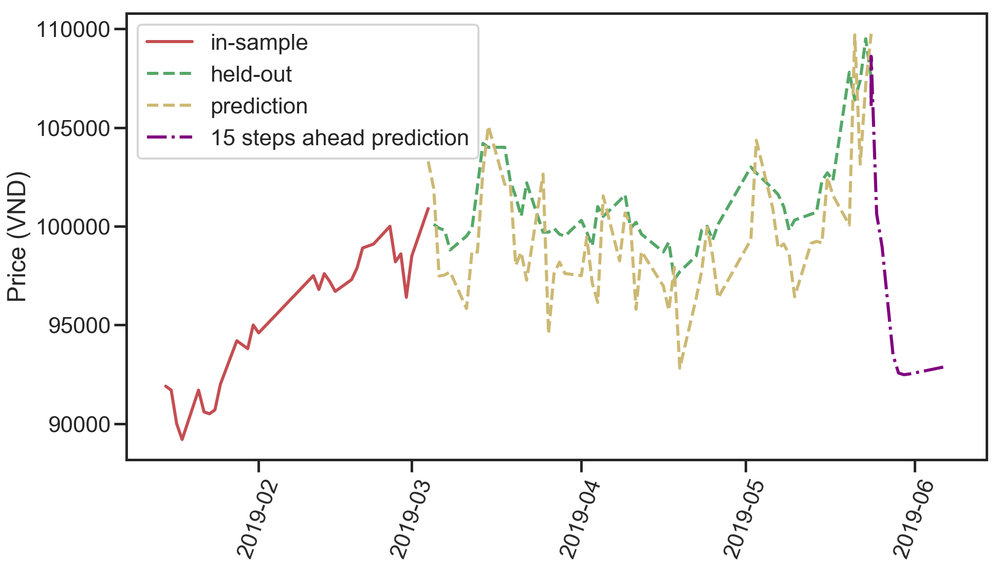

(1, 6, 3)
Testing result: {'mse': 3761552.6467451225, 'rmse': 1939.4722598545004, 'mae': 1662.9911107385965, 'mape': 1.6427807520343052, 'lags': 1, 'hidden layers': (6, 3)}


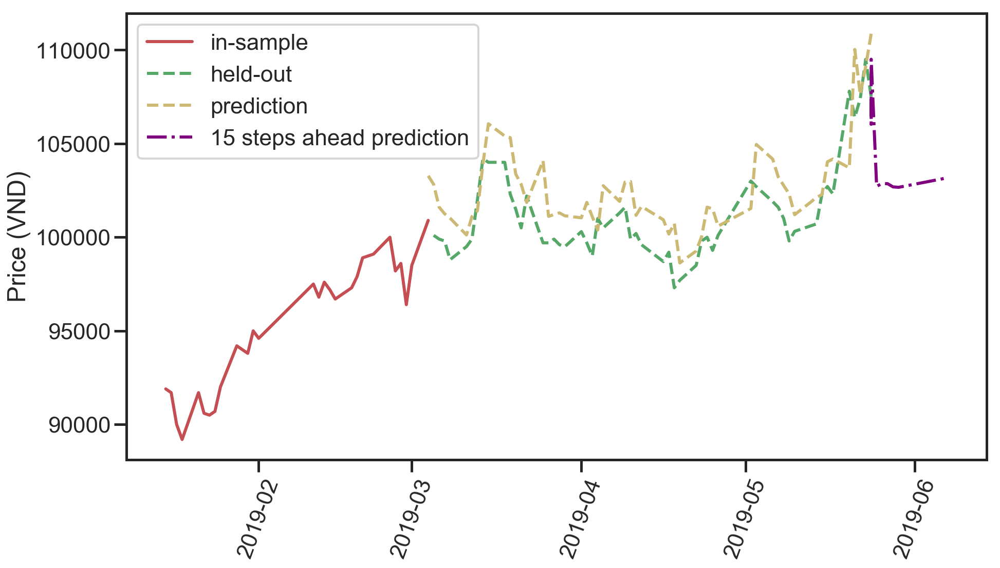

(1, 6, 3)
Testing result: {'mse': 3761552.6467451225, 'rmse': 1939.4722598545004, 'mae': 1662.9911107385965, 'mape': 1.6427807520343052, 'lags': 1, 'hidden layers': (6, 3)}


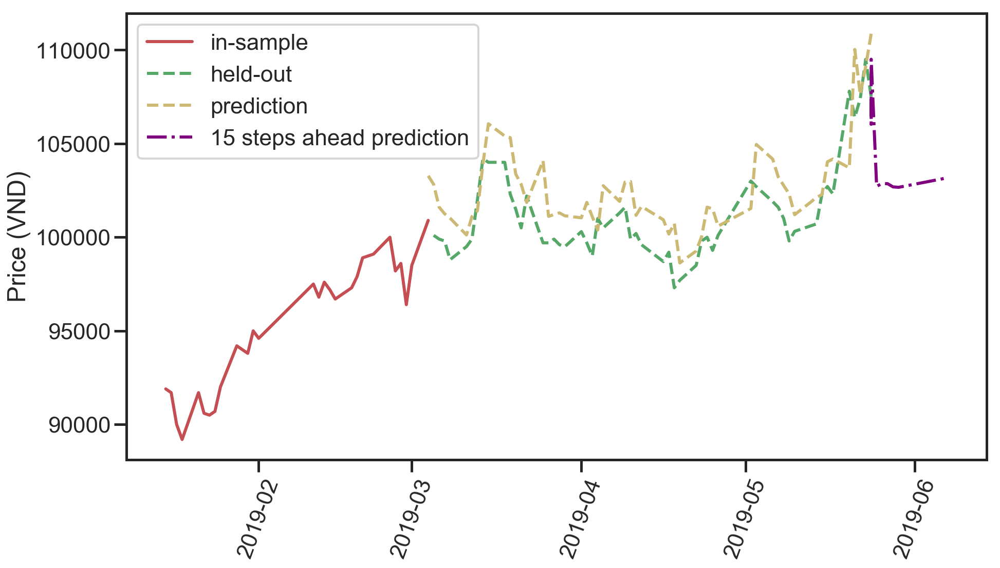

(1, 7, 1)
Testing result: {'mse': 6463708.285000605, 'rmse': 2542.38240337692, 'mae': 2335.4709563861034, 'mape': 2.3158073820702056, 'lags': 1, 'hidden layers': (7, 1)}


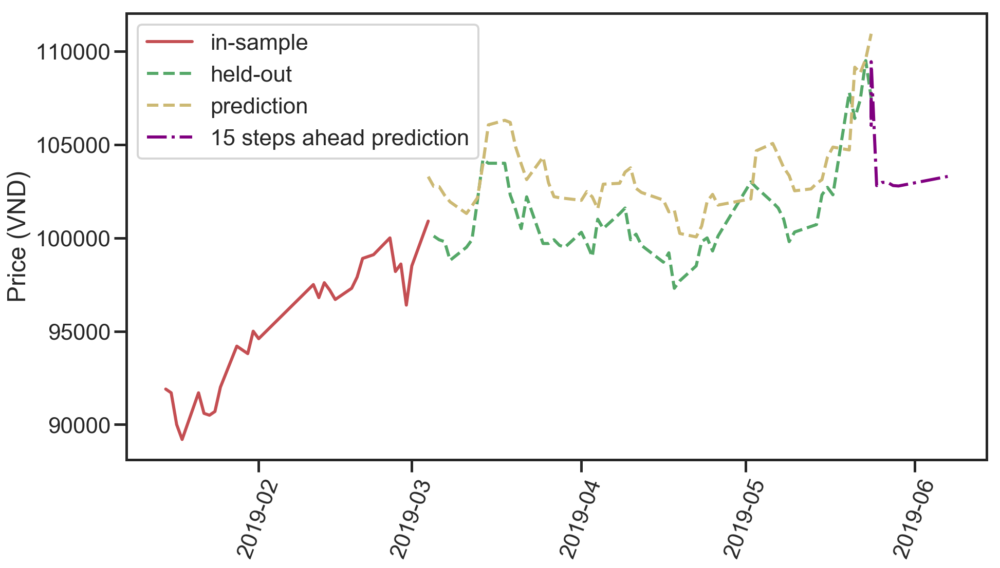

(1, 7, 2)
Testing result: {'mse': 45002939.61777543, 'rmse': 6708.423035093675, 'mae': 6494.616290602009, 'mape': 6.443586006662616, 'lags': 1, 'hidden layers': (7, 2)}


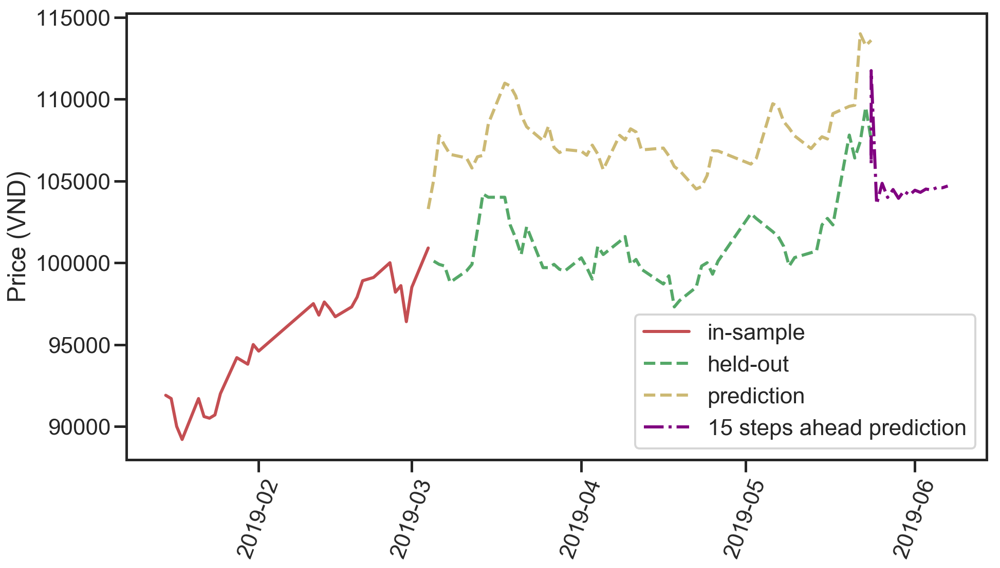

(1, 7, 2)
Testing result: {'mse': 45002939.61777543, 'rmse': 6708.423035093675, 'mae': 6494.616290602009, 'mape': 6.443586006662616, 'lags': 1, 'hidden layers': (7, 2)}


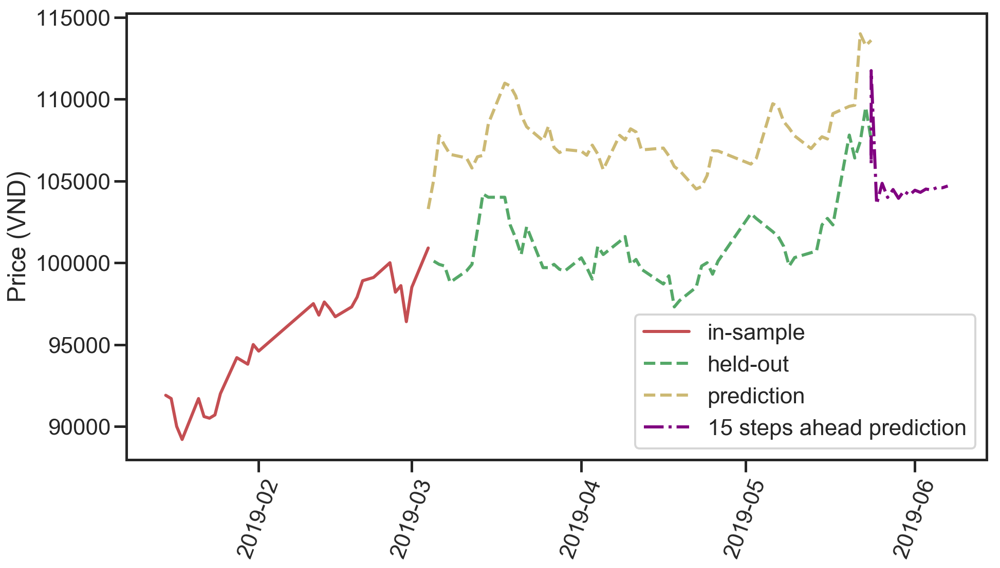

(1, 7, 3)
Testing result: {'mse': 6406960.576093787, 'rmse': 2531.1974589300194, 'mae': 2313.611549984454, 'mape': 2.2926410657339416, 'lags': 1, 'hidden layers': (7, 3)}


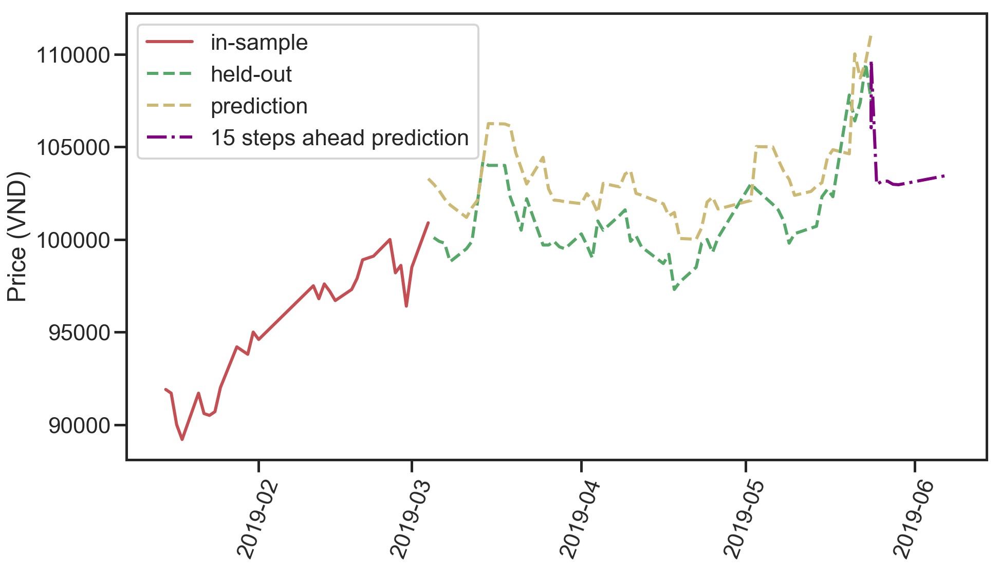

(1, 7, 3)
Testing result: {'mse': 6406960.576093787, 'rmse': 2531.1974589300194, 'mae': 2313.611549984454, 'mape': 2.2926410657339416, 'lags': 1, 'hidden layers': (7, 3)}


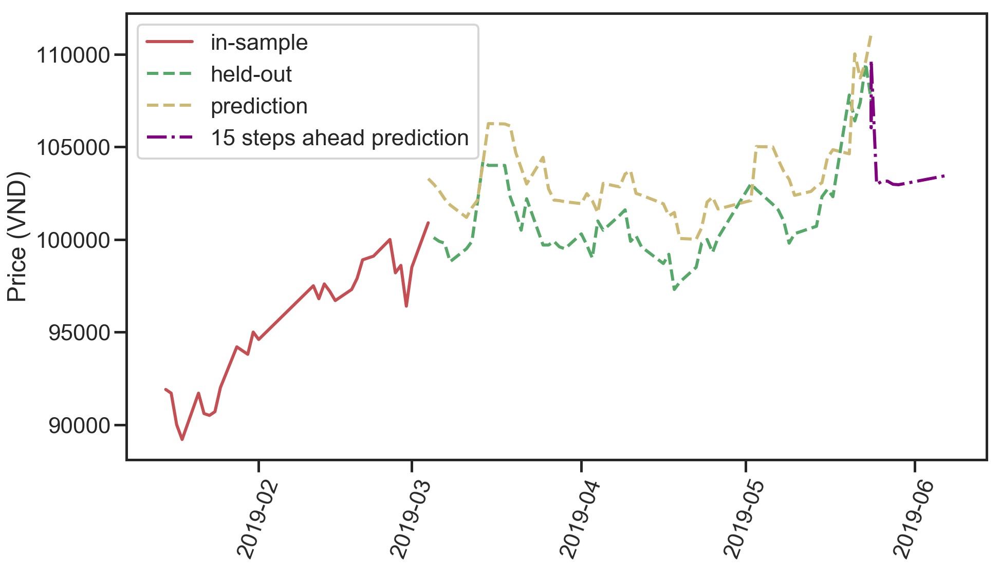

(2, 3, 1)
Testing result: {'mse': 32907918.442586448, 'rmse': 5736.542376953774, 'mae': 5575.134207774567, 'mape': 5.494807117347513, 'lags': 2, 'hidden layers': (3, 1)}


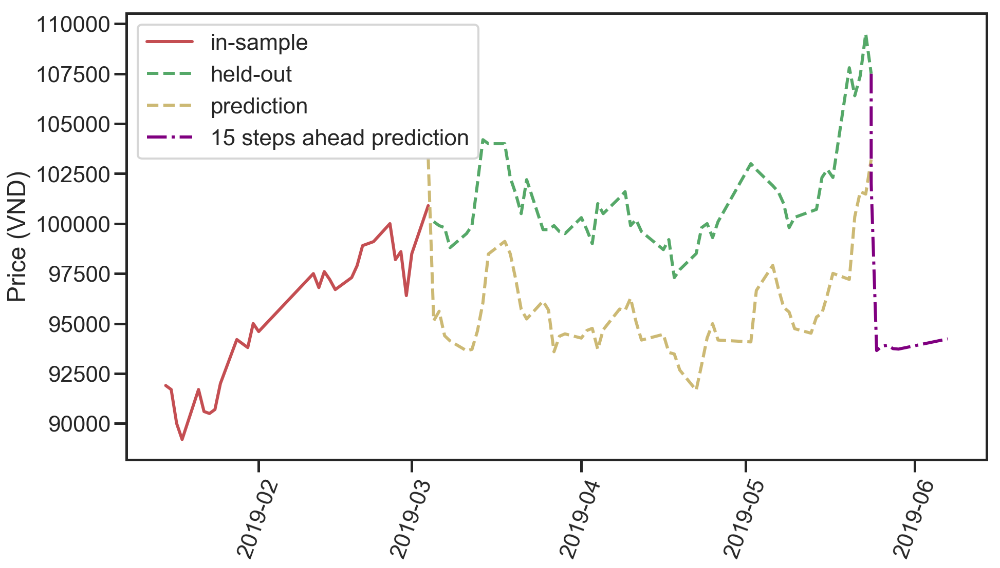

(2, 3, 2)
Testing result: {'mse': 3281632.6403893884, 'rmse': 1811.5277089764286, 'mae': 1498.944530494328, 'mape': 1.4844956267993021, 'lags': 2, 'hidden layers': (3, 2)}


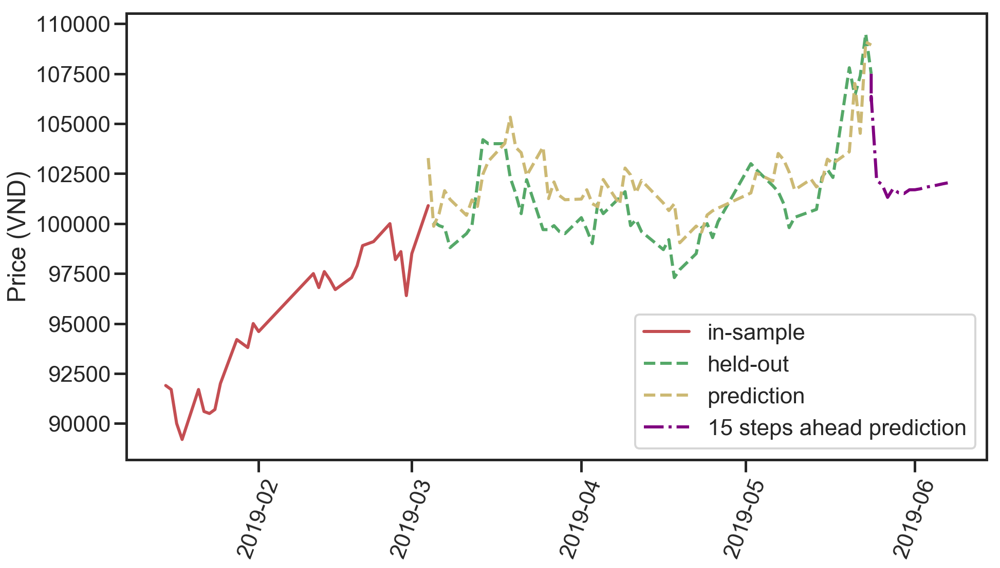

(2, 3, 2)
Testing result: {'mse': 3281632.6403893884, 'rmse': 1811.5277089764286, 'mae': 1498.944530494328, 'mape': 1.4844956267993021, 'lags': 2, 'hidden layers': (3, 2)}


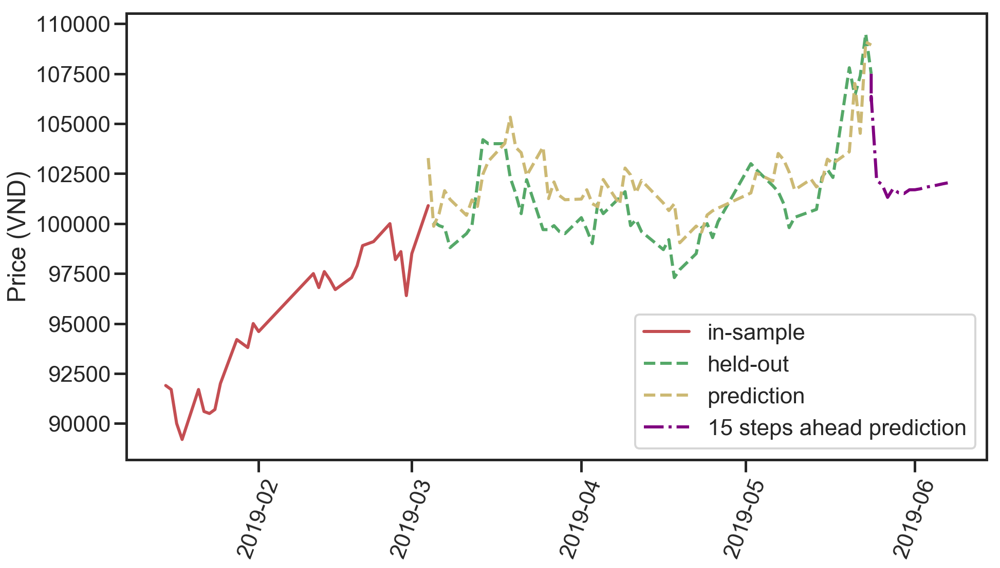

(2, 3, 3)
Testing result: {'mse': 11264702.85305701, 'rmse': 3356.2930225260443, 'mae': 3112.7756164596613, 'mape': 3.0931324053643108, 'lags': 2, 'hidden layers': (3, 3)}


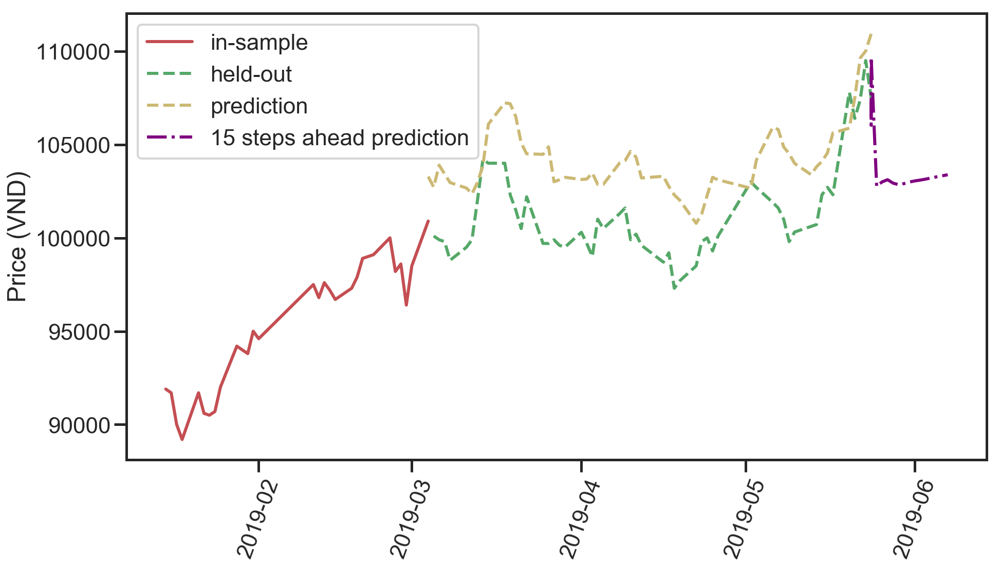

(2, 3, 3)
Testing result: {'mse': 11264702.85305701, 'rmse': 3356.2930225260443, 'mae': 3112.7756164596613, 'mape': 3.0931324053643108, 'lags': 2, 'hidden layers': (3, 3)}


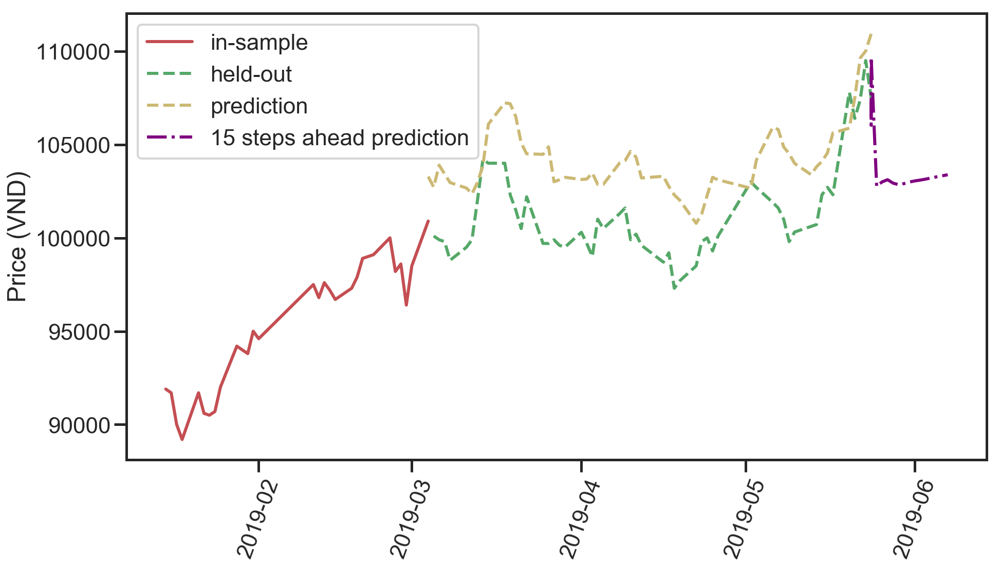

(2, 4, 1)
Testing result: {'mse': 7710269.5719206305, 'rmse': 2776.7372169365667, 'mae': 2398.5171962504583, 'mape': 2.363824127747694, 'lags': 2, 'hidden layers': (4, 1)}


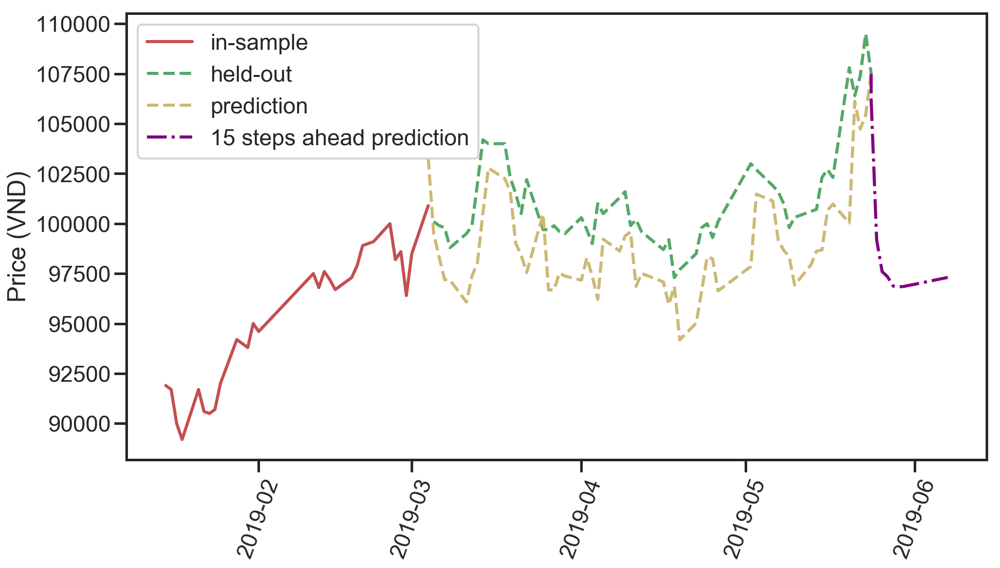

(2, 4, 2)
Testing result: {'mse': 25658055.9885399, 'rmse': 5065.3781683641255, 'mae': 4770.598685988823, 'mape': 4.7387077181774675, 'lags': 2, 'hidden layers': (4, 2)}


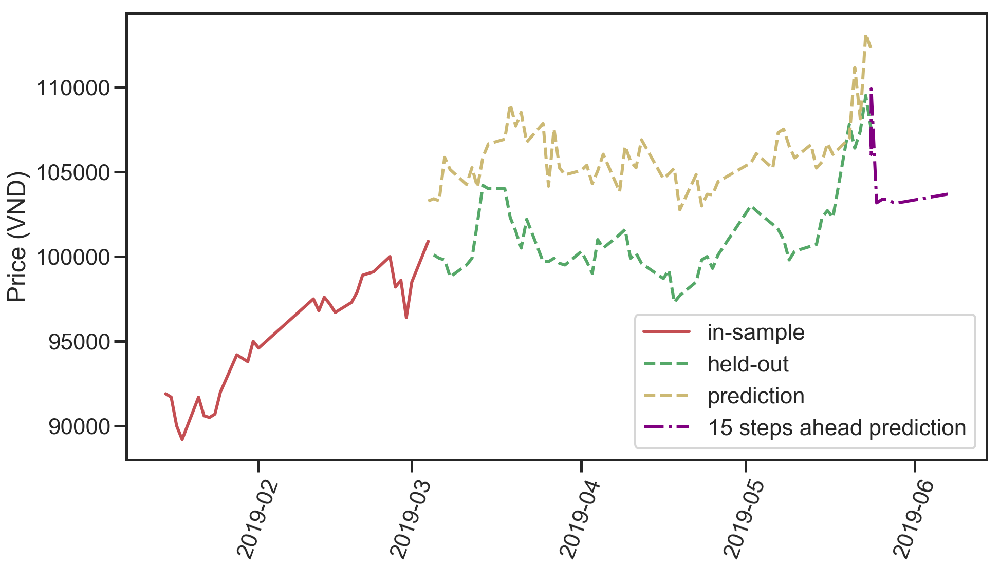

(2, 4, 2)
Testing result: {'mse': 25658055.9885399, 'rmse': 5065.3781683641255, 'mae': 4770.598685988823, 'mape': 4.7387077181774675, 'lags': 2, 'hidden layers': (4, 2)}


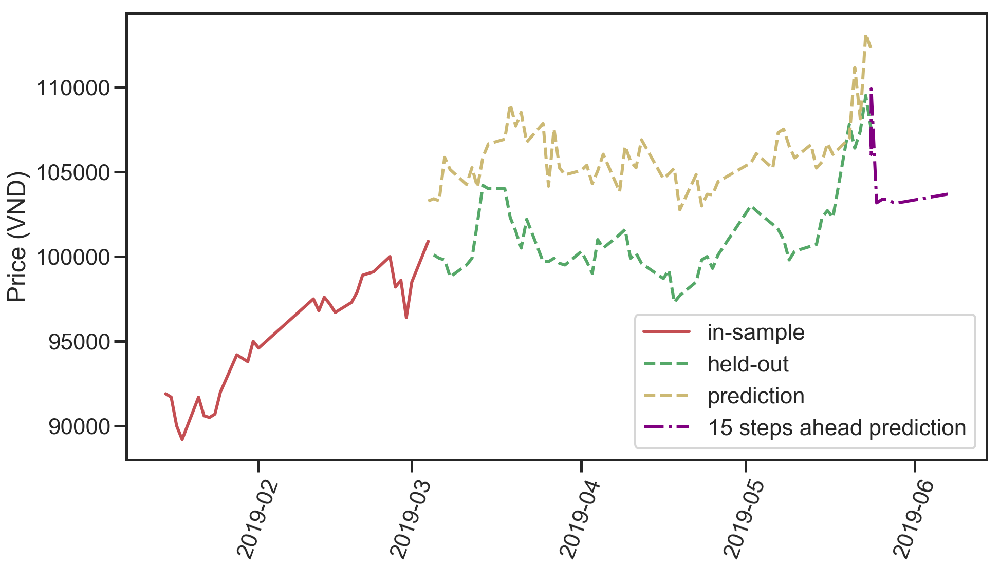

(2, 4, 3)
Testing result: {'mse': 19979630.048900064, 'rmse': 4469.857945047031, 'mae': 4246.547920247241, 'mape': 4.187407615703891, 'lags': 2, 'hidden layers': (4, 3)}


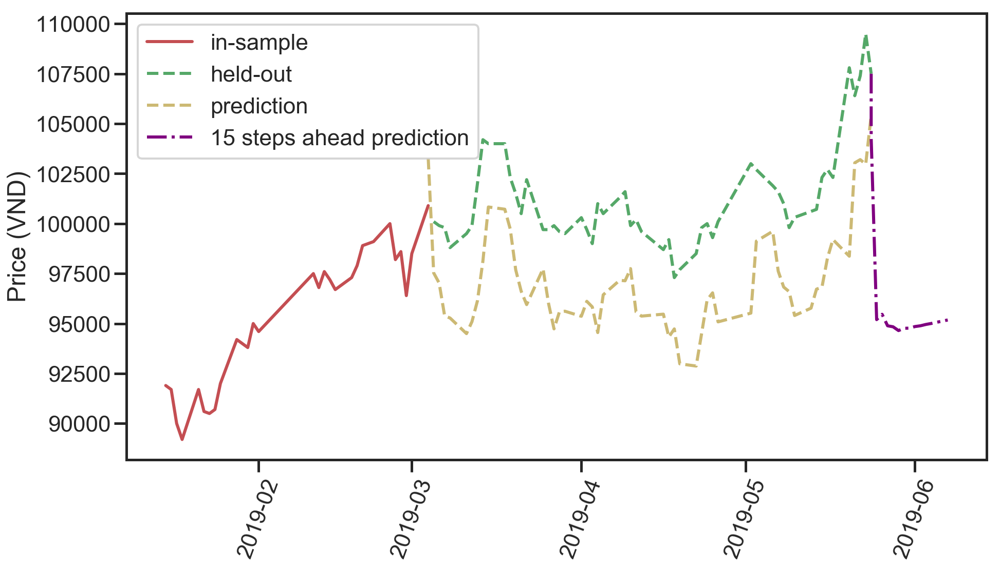

(2, 4, 3)
Testing result: {'mse': 19979630.048900064, 'rmse': 4469.857945047031, 'mae': 4246.547920247241, 'mape': 4.187407615703891, 'lags': 2, 'hidden layers': (4, 3)}


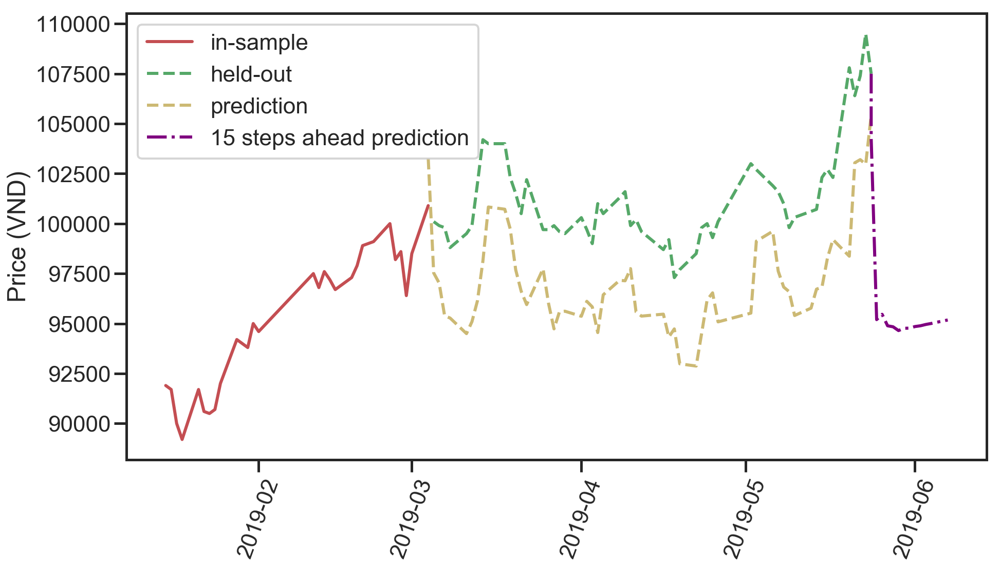

(2, 5, 1)
Testing result: {'mse': 5255382.088778743, 'rmse': 2292.46201468612, 'mae': 2009.037888533527, 'mape': 1.9893874681538002, 'lags': 2, 'hidden layers': (5, 1)}


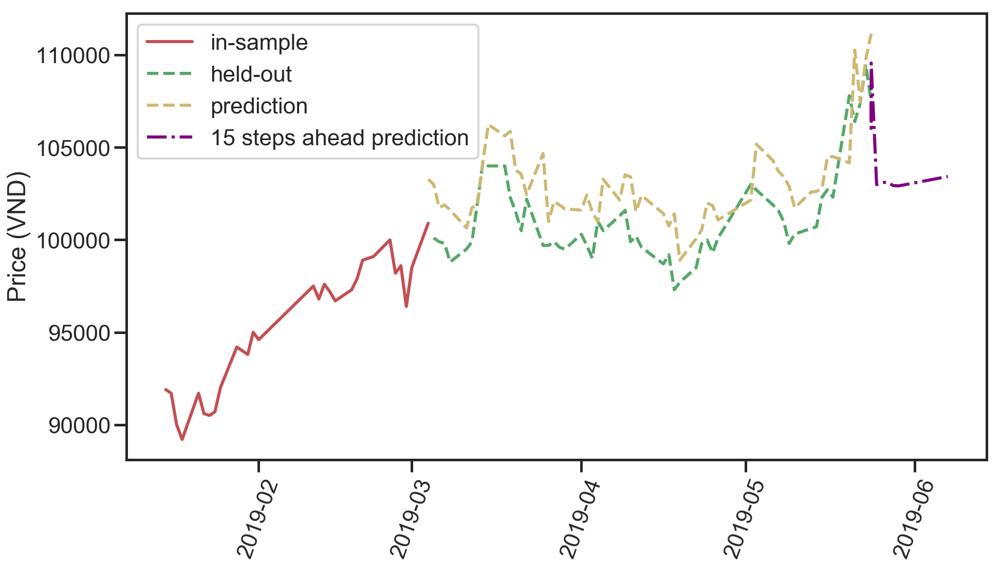

(2, 5, 2)
Testing result: {'mse': 7626750.276234417, 'rmse': 2761.65716124113, 'mae': 2542.781038576489, 'mape': 2.5210221129262114, 'lags': 2, 'hidden layers': (5, 2)}


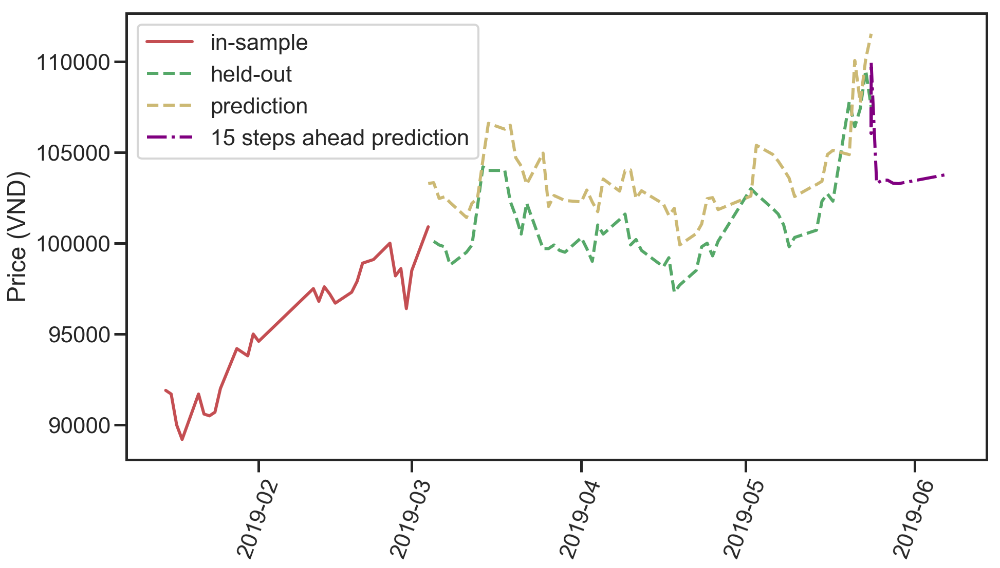

(2, 5, 2)
Testing result: {'mse': 7626750.276234417, 'rmse': 2761.65716124113, 'mae': 2542.781038576489, 'mape': 2.5210221129262114, 'lags': 2, 'hidden layers': (5, 2)}


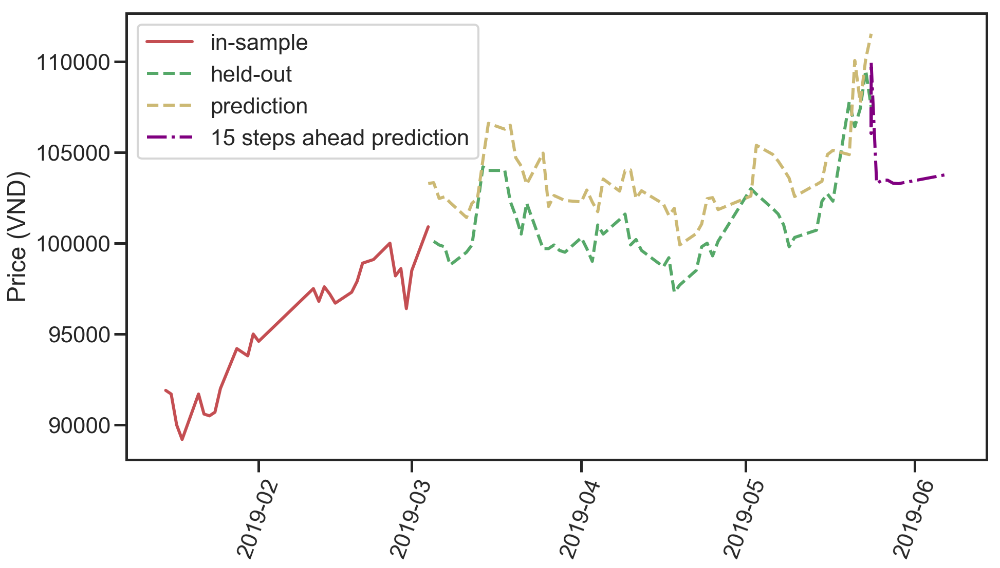

(2, 5, 3)
Testing result: {'mse': 6679201.56871387, 'rmse': 2584.4151308785263, 'mae': 2377.4491469758314, 'mape': 2.3565073092188316, 'lags': 2, 'hidden layers': (5, 3)}


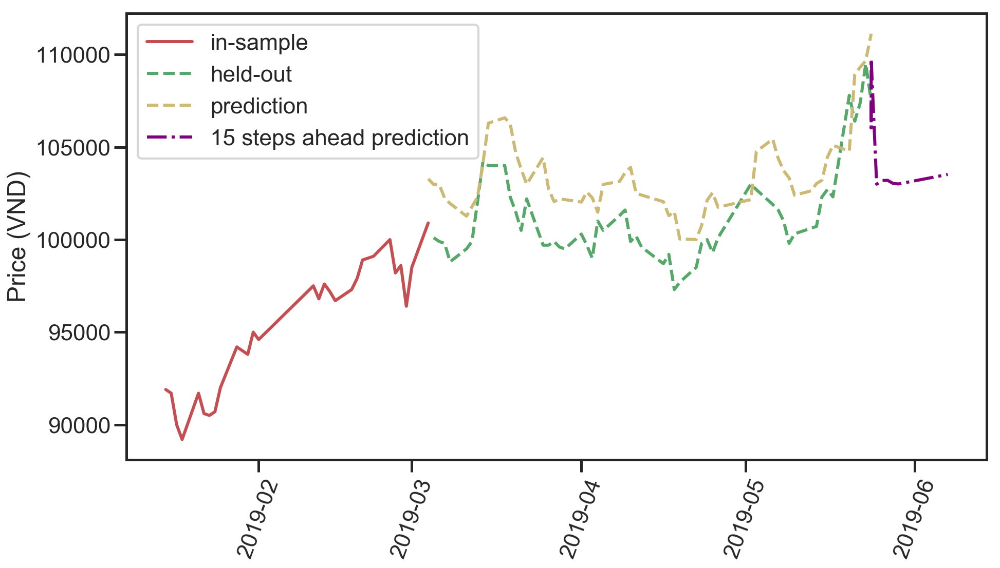

(2, 5, 3)
Testing result: {'mse': 6679201.56871387, 'rmse': 2584.4151308785263, 'mae': 2377.4491469758314, 'mape': 2.3565073092188316, 'lags': 2, 'hidden layers': (5, 3)}


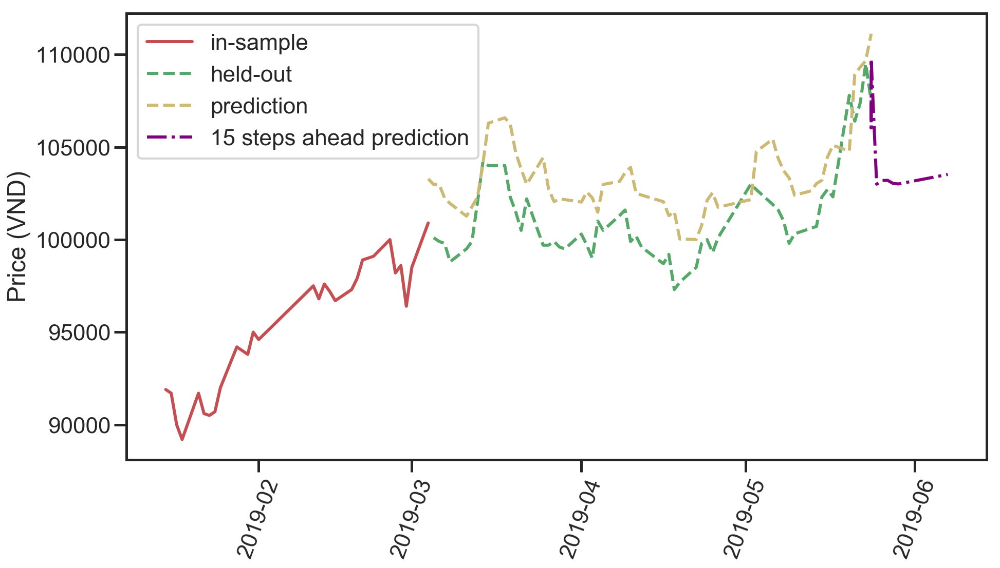

(2, 6, 1)
Testing result: {'mse': 3014170.9492843584, 'rmse': 1736.1367887595604, 'mae': 1506.7275267328223, 'mape': 1.4871320625288427, 'lags': 2, 'hidden layers': (6, 1)}


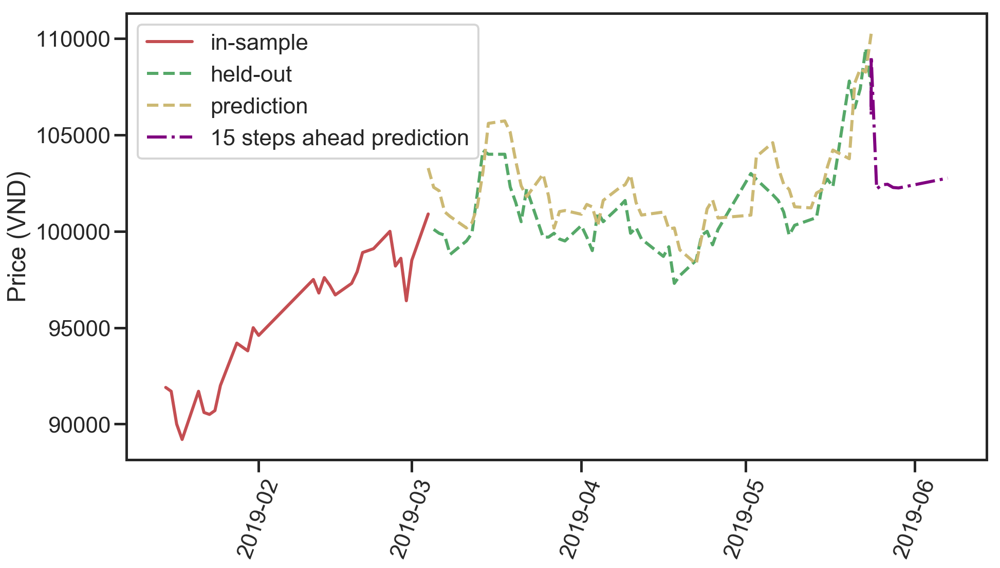

(2, 6, 2)
Testing result: {'mse': 4043170.324124454, 'rmse': 2010.7636171674815, 'mae': 1619.682643841781, 'mape': 1.5965798912371403, 'lags': 2, 'hidden layers': (6, 2)}


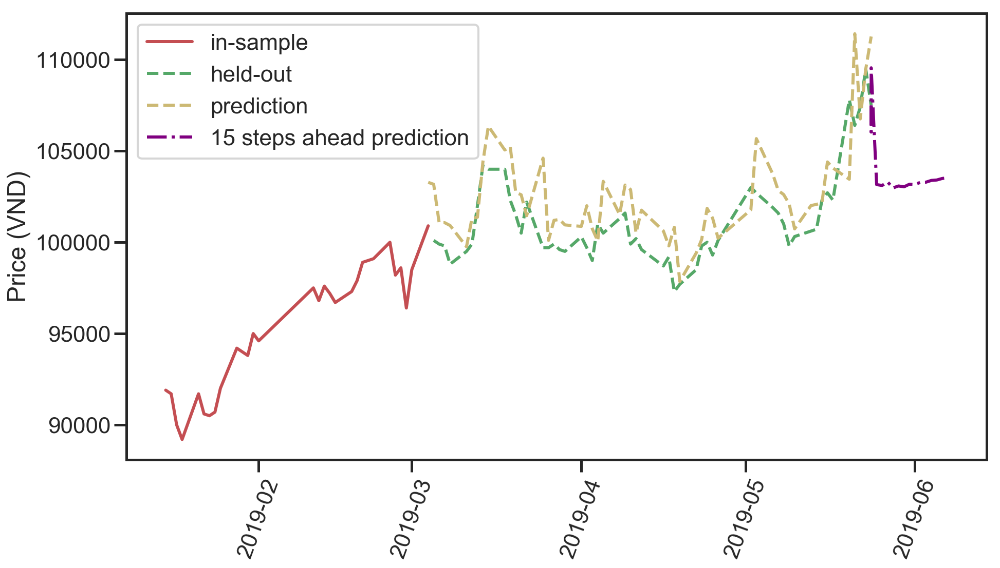

(2, 6, 2)
Testing result: {'mse': 4043170.324124454, 'rmse': 2010.7636171674815, 'mae': 1619.682643841781, 'mape': 1.5965798912371403, 'lags': 2, 'hidden layers': (6, 2)}


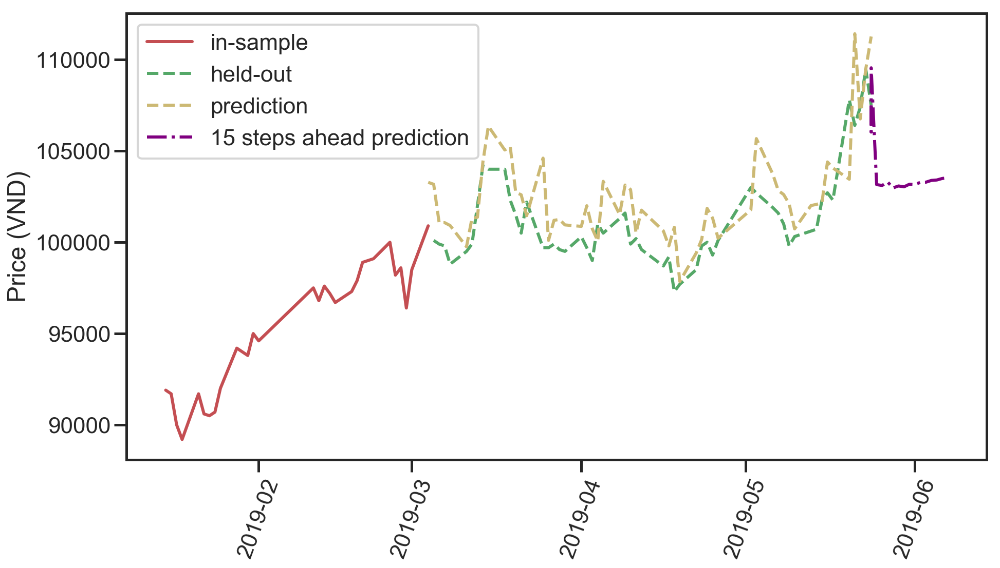

(2, 6, 3)
Testing result: {'mse': 3830762.645781428, 'rmse': 1957.2334162744687, 'mae': 1718.073618517151, 'mape': 1.6962359148600443, 'lags': 2, 'hidden layers': (6, 3)}


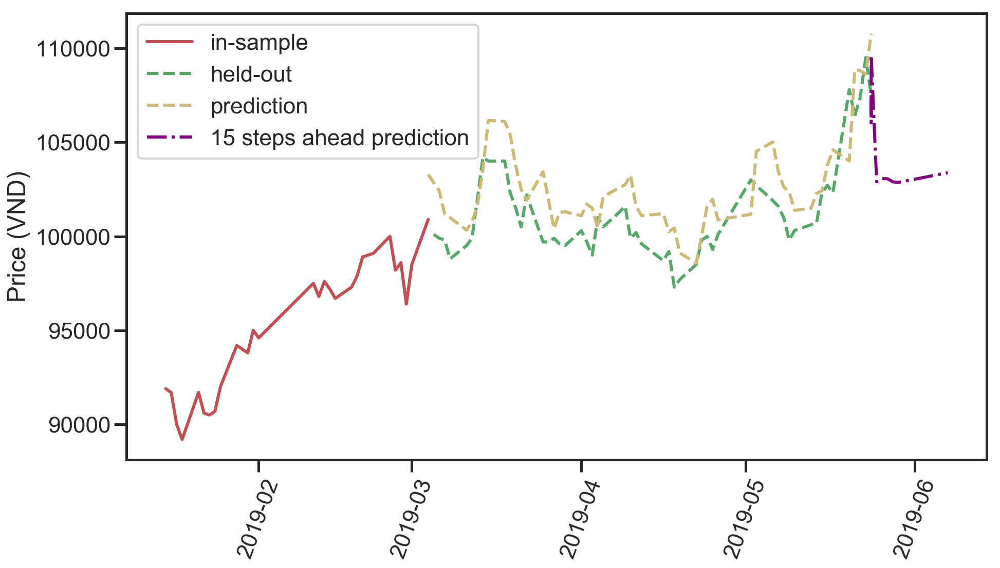

(2, 6, 3)
Testing result: {'mse': 3830762.645781428, 'rmse': 1957.2334162744687, 'mae': 1718.073618517151, 'mape': 1.6962359148600443, 'lags': 2, 'hidden layers': (6, 3)}


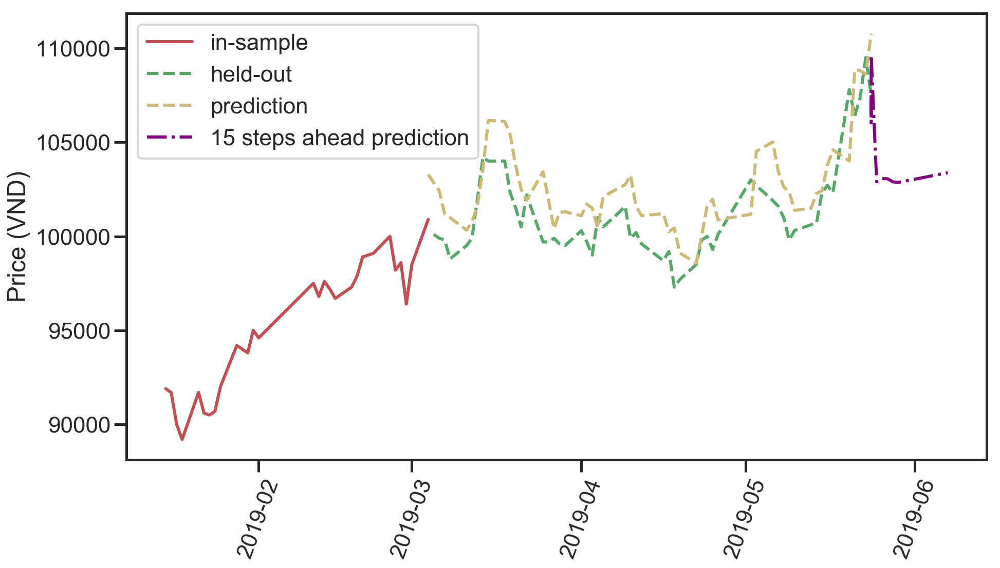

(2, 7, 1)
Testing result: {'mse': 34330863.003432766, 'rmse': 5859.254475053355, 'mae': 5492.415670305981, 'mape': 5.43340886604489, 'lags': 2, 'hidden layers': (7, 1)}


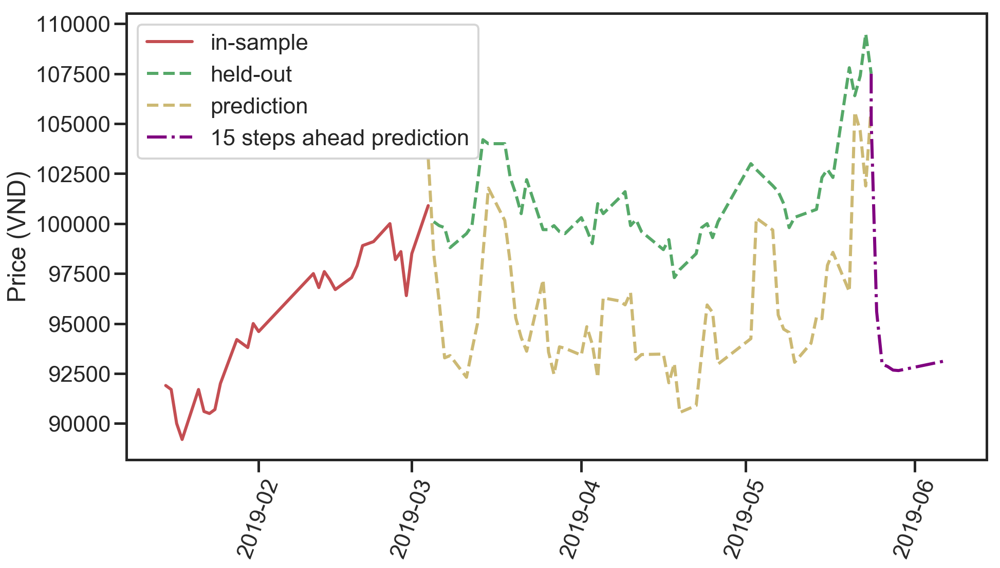

(2, 7, 2)
Testing result: {'mse': 3747260.0597468624, 'rmse': 1935.7840943005142, 'mae': 1615.972493449928, 'mape': 1.5897451966272402, 'lags': 2, 'hidden layers': (7, 2)}


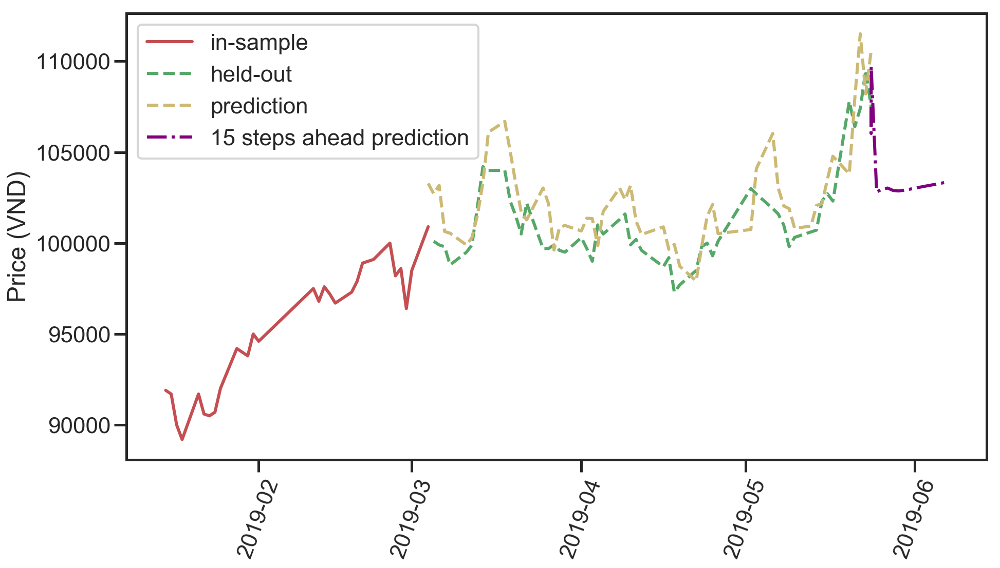

(2, 7, 2)
Testing result: {'mse': 3747260.0597468624, 'rmse': 1935.7840943005142, 'mae': 1615.972493449928, 'mape': 1.5897451966272402, 'lags': 2, 'hidden layers': (7, 2)}


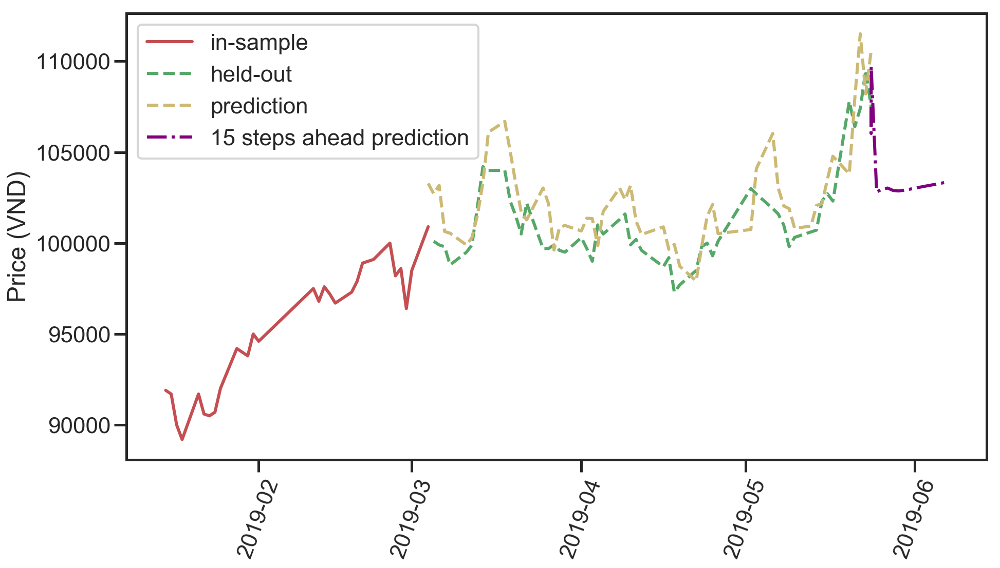

(2, 7, 3)
Testing result: {'mse': 5936447.950462696, 'rmse': 2436.482700628653, 'mae': 2198.3255673749527, 'mape': 2.1804079881897733, 'lags': 2, 'hidden layers': (7, 3)}


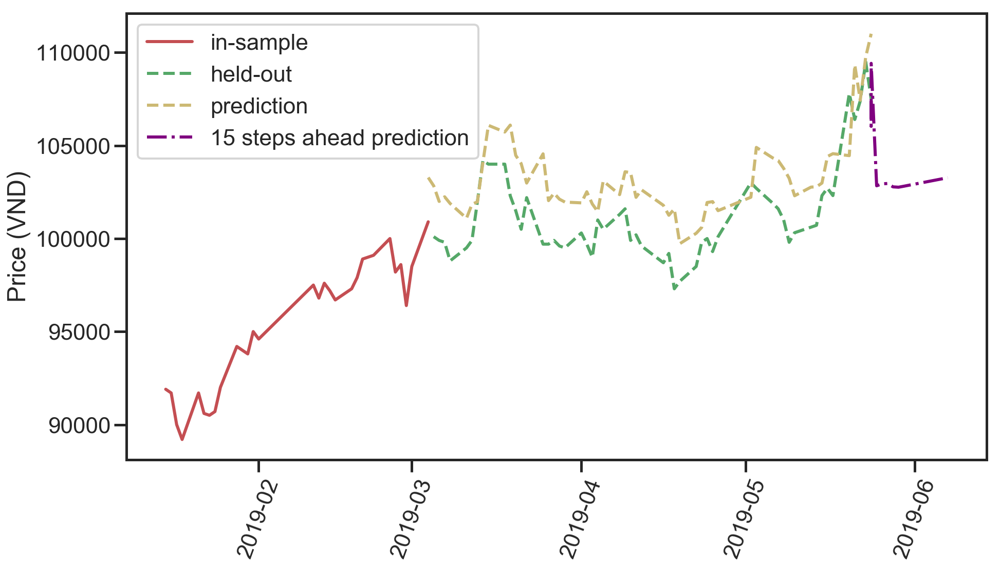

(2, 7, 3)
Testing result: {'mse': 5936447.950462696, 'rmse': 2436.482700628653, 'mae': 2198.3255673749527, 'mape': 2.1804079881897733, 'lags': 2, 'hidden layers': (7, 3)}


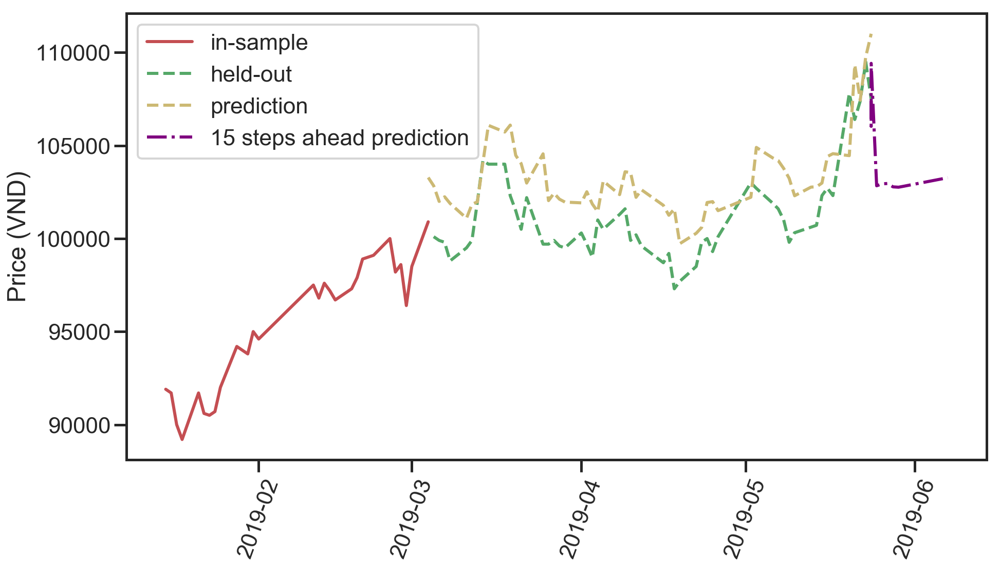

(3, 3, 1)
Testing result: {'mse': 9383035.192825116, 'rmse': 3063.174038938225, 'mae': 2862.404442012691, 'mape': 2.84076769243321, 'lags': 3, 'hidden layers': (3, 1)}


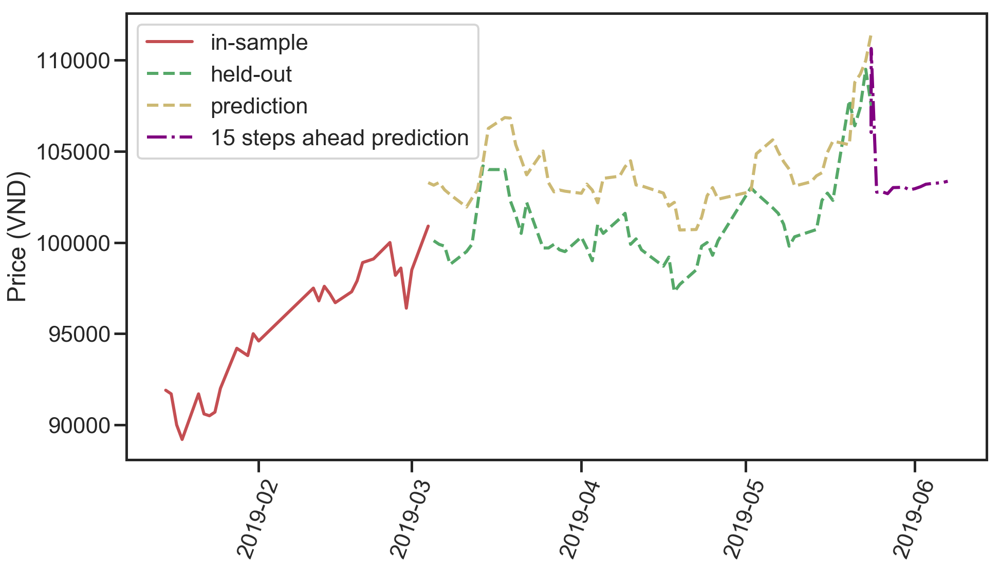

(3, 3, 2)
Testing result: {'mse': 5180532.760131317, 'rmse': 2276.0783730204275, 'mae': 1793.2344957269233, 'mape': 1.7544897897854401, 'lags': 3, 'hidden layers': (3, 2)}


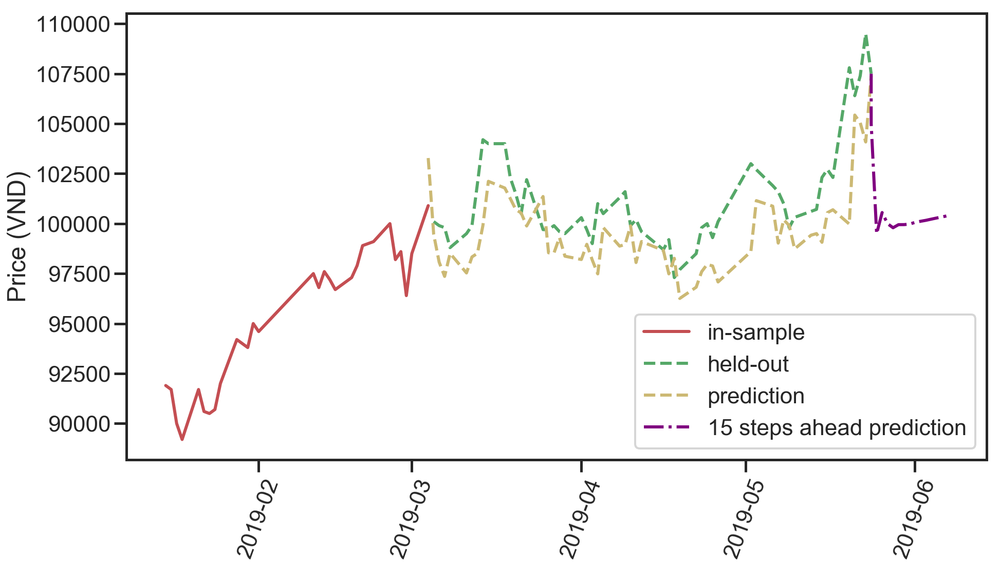

(3, 3, 2)
Testing result: {'mse': 5180532.760131317, 'rmse': 2276.0783730204275, 'mae': 1793.2344957269233, 'mape': 1.7544897897854401, 'lags': 3, 'hidden layers': (3, 2)}


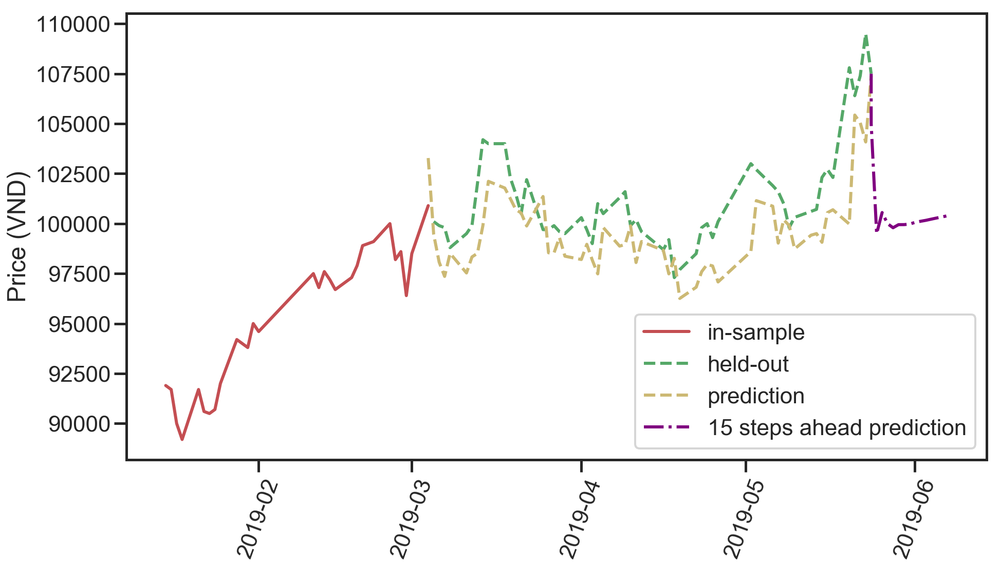

(3, 3, 3)
Testing result: {'mse': 5565910.908632966, 'rmse': 2359.2182833796805, 'mae': 1956.2655287314844, 'mape': 1.9219462448995421, 'lags': 3, 'hidden layers': (3, 3)}


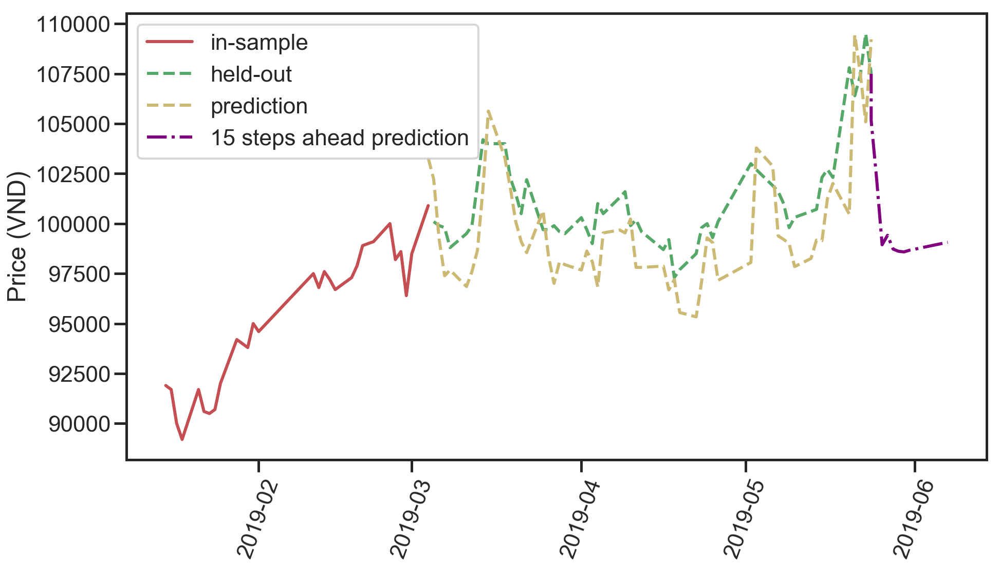

(3, 3, 3)
Testing result: {'mse': 5565910.908632966, 'rmse': 2359.2182833796805, 'mae': 1956.2655287314844, 'mape': 1.9219462448995421, 'lags': 3, 'hidden layers': (3, 3)}


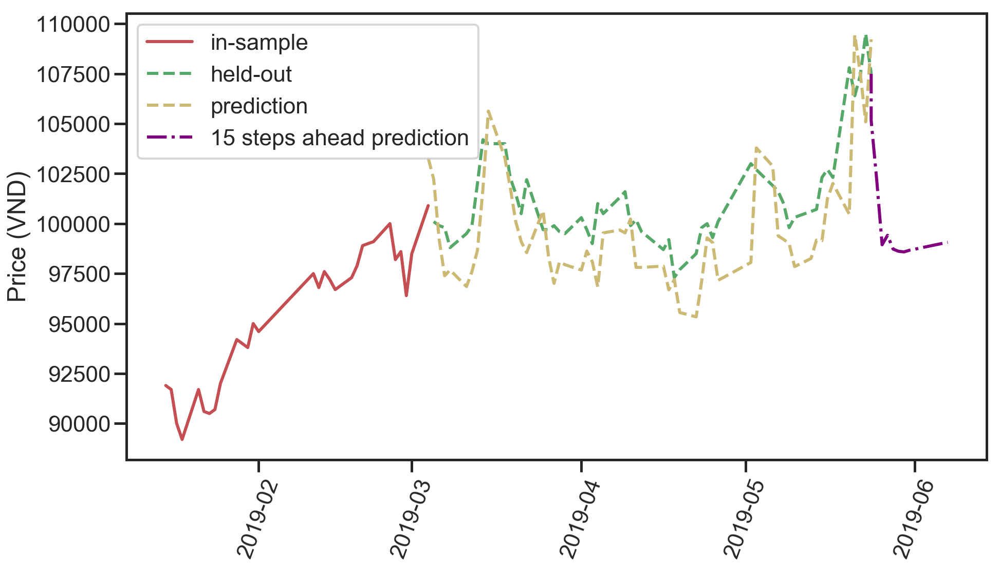

(3, 4, 1)
Testing result: {'mse': 4133167.41029453, 'rmse': 2033.0192842898784, 'mae': 1610.844698207104, 'mape': 1.5831334186791057, 'lags': 3, 'hidden layers': (4, 1)}


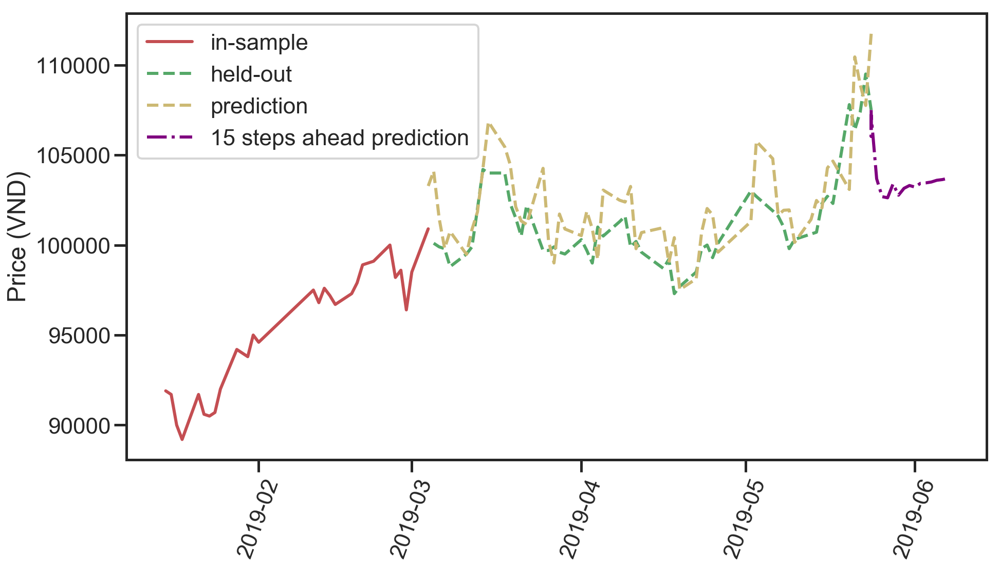

(3, 4, 2)
Testing result: {'mse': 4499351.018290543, 'rmse': 2121.1673715882353, 'mae': 1740.9293894905147, 'mape': 1.7118242248283424, 'lags': 3, 'hidden layers': (4, 2)}


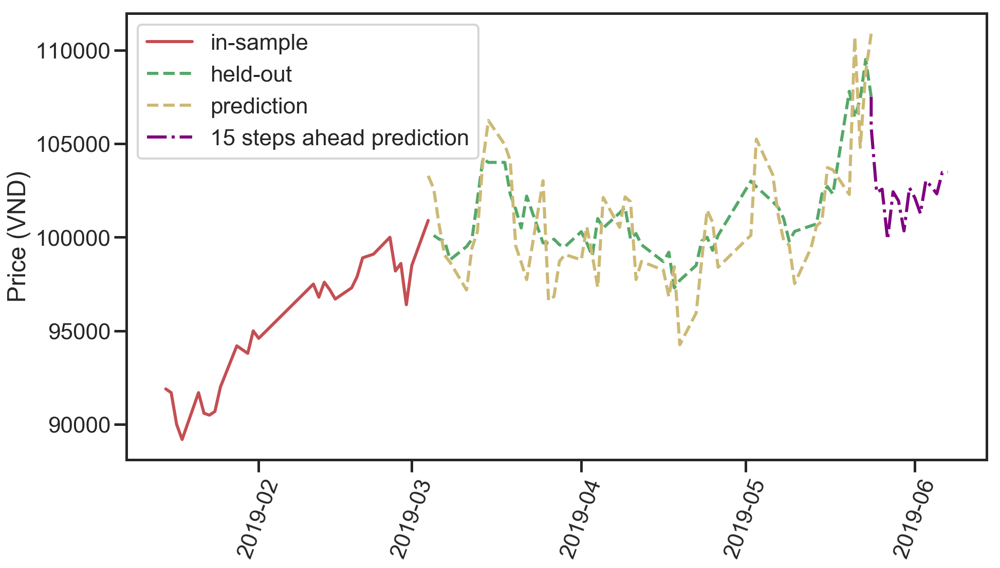

(3, 4, 2)
Testing result: {'mse': 4499351.018290543, 'rmse': 2121.1673715882353, 'mae': 1740.9293894905147, 'mape': 1.7118242248283424, 'lags': 3, 'hidden layers': (4, 2)}


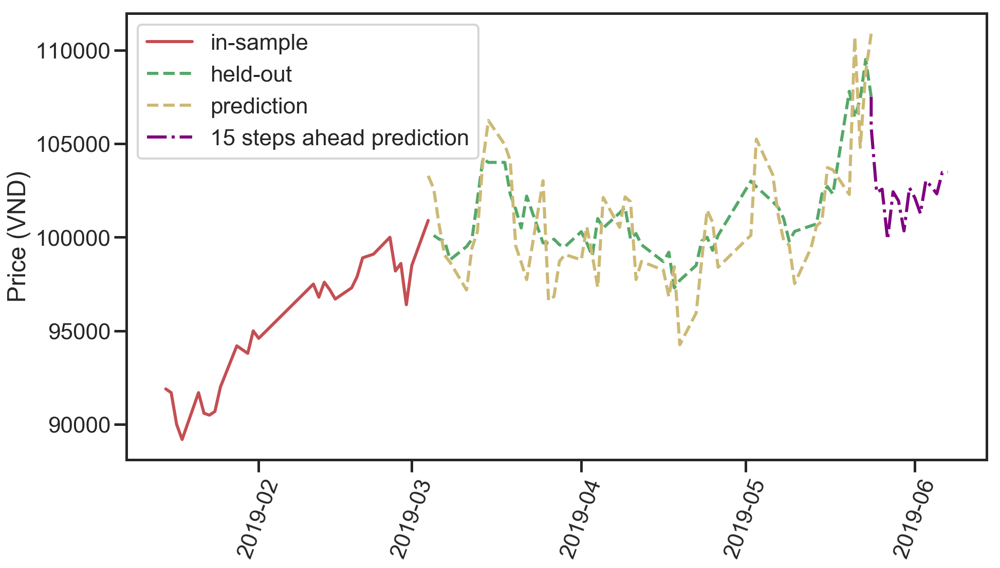

(3, 4, 3)
Testing result: {'mse': 15400226.12291506, 'rmse': 3924.312184691103, 'mae': 3665.592780935428, 'mape': 3.641553150421225, 'lags': 3, 'hidden layers': (4, 3)}


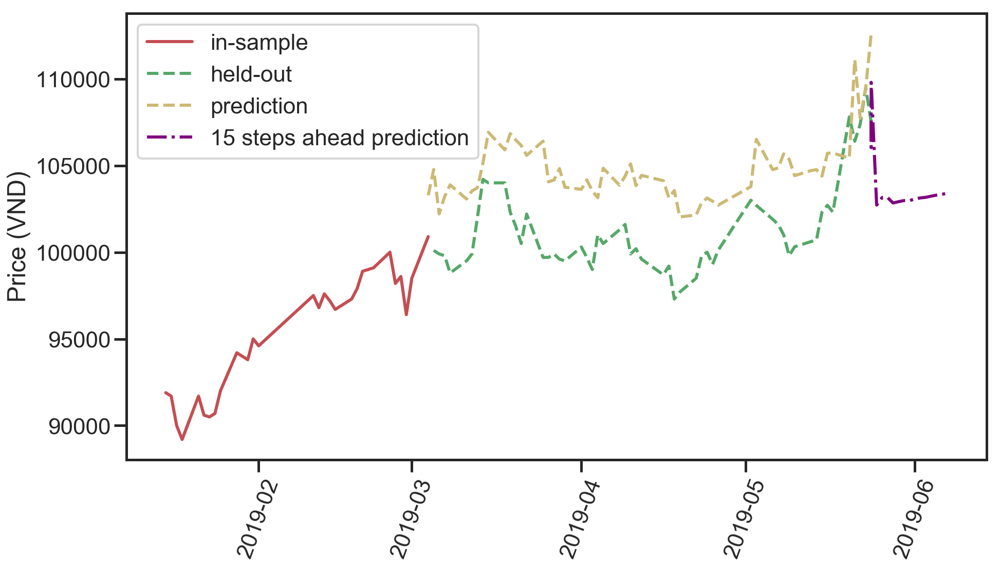

(3, 4, 3)
Testing result: {'mse': 15400226.12291506, 'rmse': 3924.312184691103, 'mae': 3665.592780935428, 'mape': 3.641553150421225, 'lags': 3, 'hidden layers': (4, 3)}


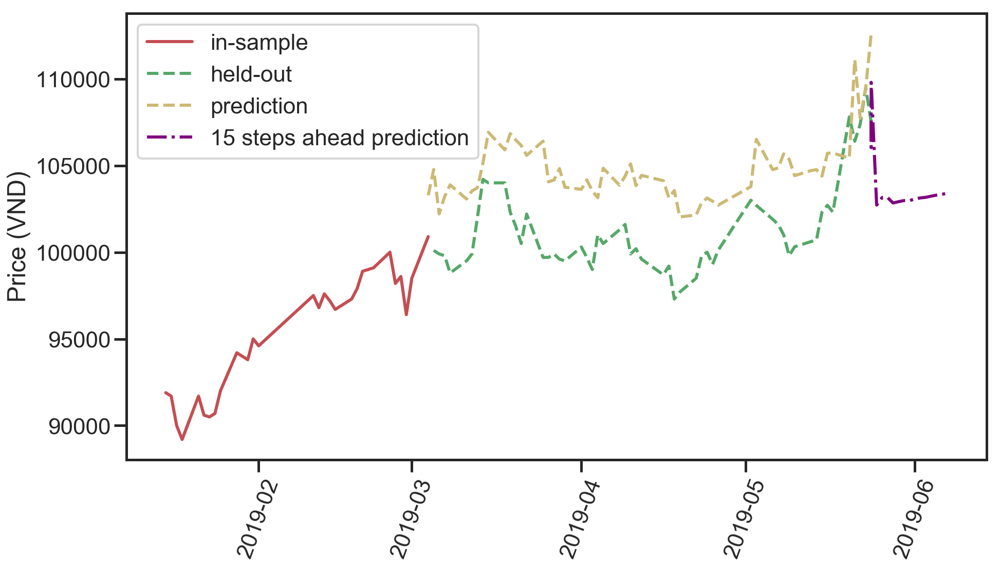

(3, 5, 1)
Testing result: {'mse': 25776332.681576103, 'rmse': 5077.039755760841, 'mae': 4539.567711711463, 'mape': 4.495753215335756, 'lags': 3, 'hidden layers': (5, 1)}


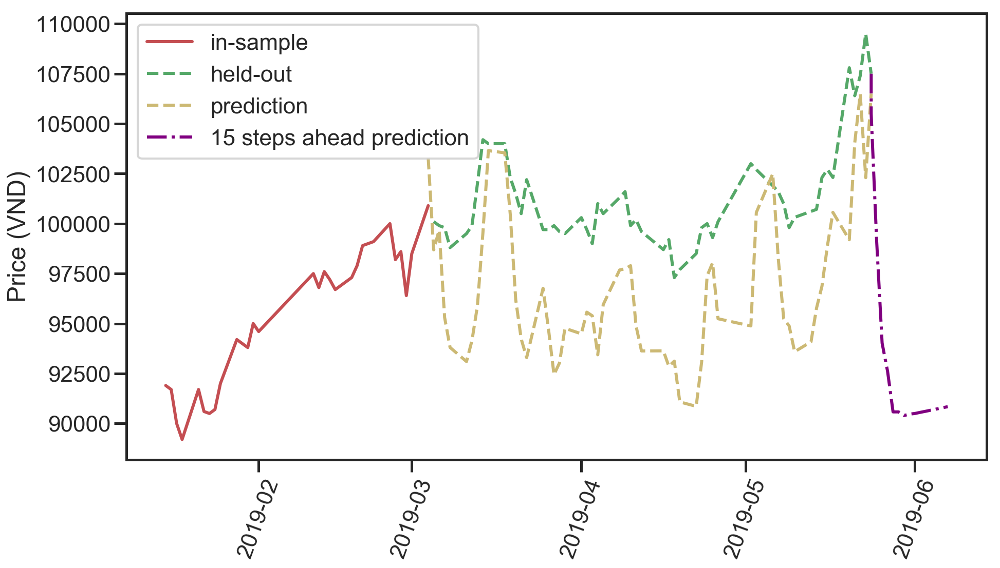

(3, 5, 2)
Testing result: {'mse': 8031207.272976474, 'rmse': 2833.9384737457644, 'mae': 2615.403755873522, 'mape': 2.5930620981320525, 'lags': 3, 'hidden layers': (5, 2)}


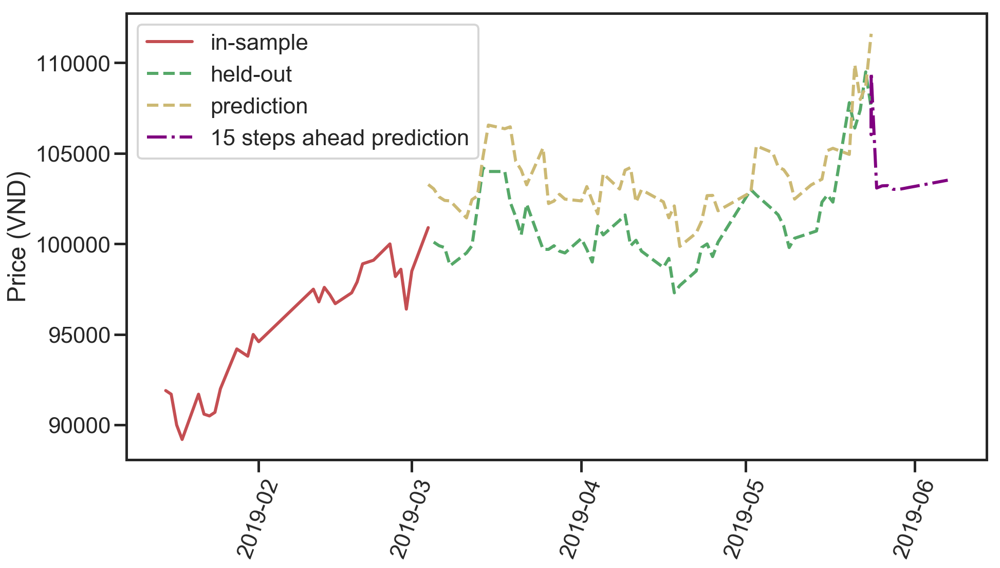

(3, 5, 2)
Testing result: {'mse': 8031207.272976474, 'rmse': 2833.9384737457644, 'mae': 2615.403755873522, 'mape': 2.5930620981320525, 'lags': 3, 'hidden layers': (5, 2)}


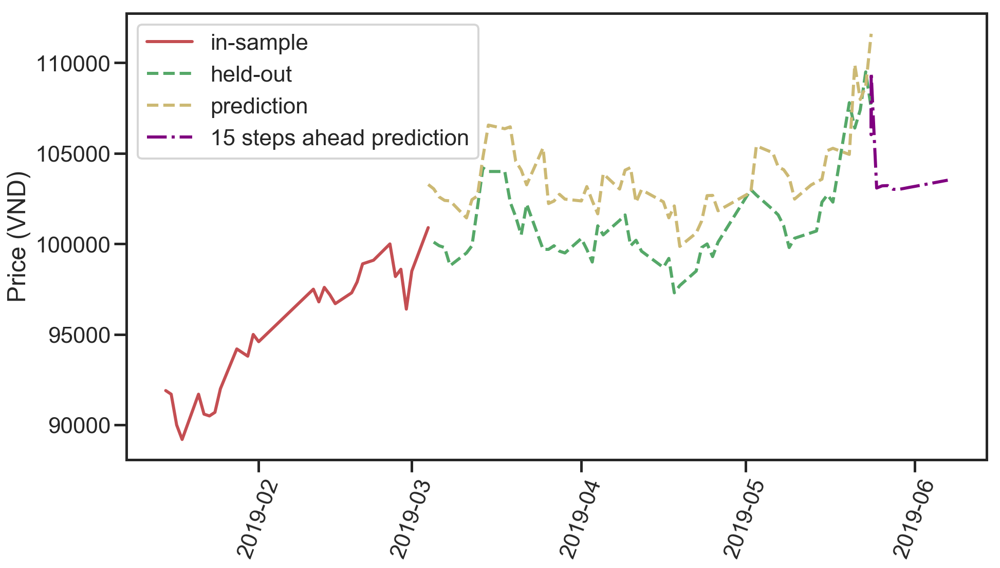

(3, 5, 3)
Testing result: {'mse': 20865205.350490484, 'rmse': 4567.84471610961, 'mae': 4351.781194628388, 'mape': 4.31401041092272, 'lags': 3, 'hidden layers': (5, 3)}


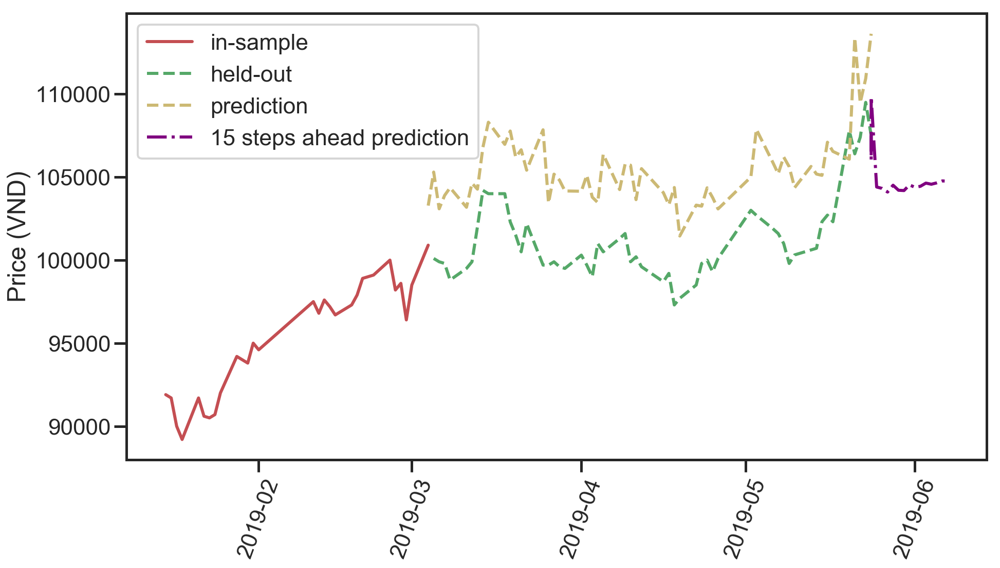

(3, 5, 3)
Testing result: {'mse': 20865205.350490484, 'rmse': 4567.84471610961, 'mae': 4351.781194628388, 'mape': 4.31401041092272, 'lags': 3, 'hidden layers': (5, 3)}


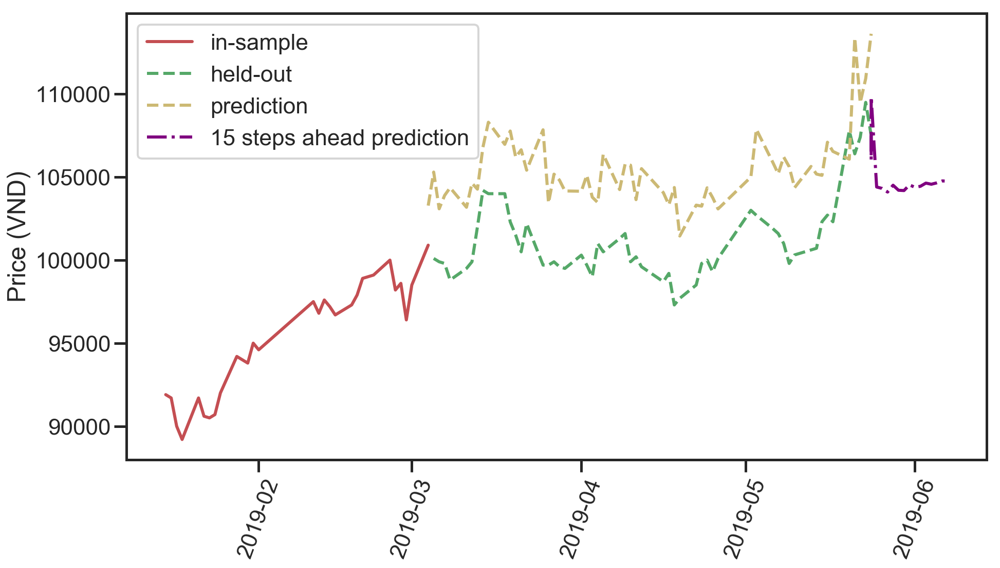

(3, 6, 1)
Testing result: {'mse': 57164192.064275436, 'rmse': 7560.700500897747, 'mae': 7443.737163977385, 'mape': 7.372802040322285, 'lags': 3, 'hidden layers': (6, 1)}


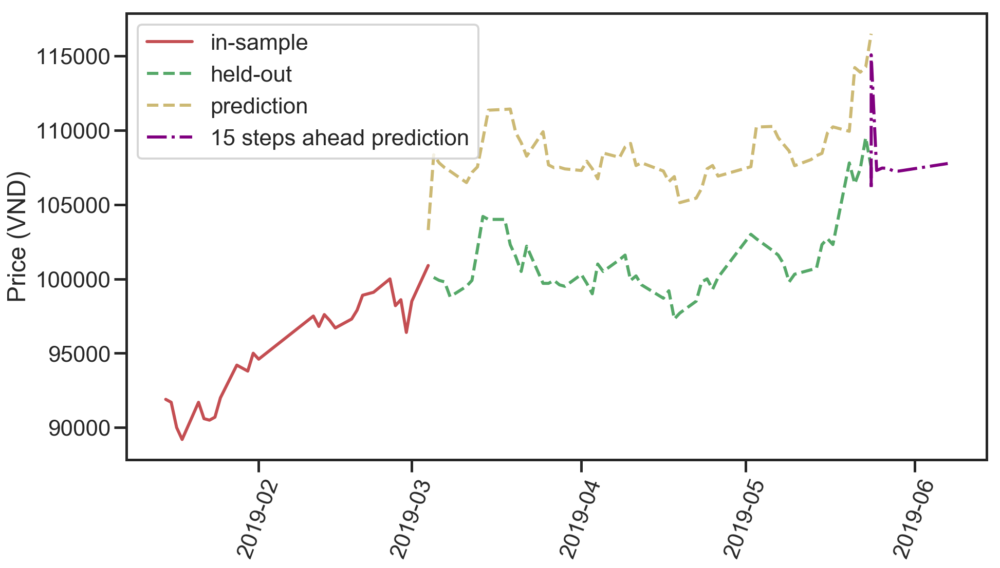

(3, 6, 2)
Testing result: {'mse': 33272201.902236257, 'rmse': 5768.206125151584, 'mae': 5567.4897293083495, 'mape': 5.521550107045316, 'lags': 3, 'hidden layers': (6, 2)}


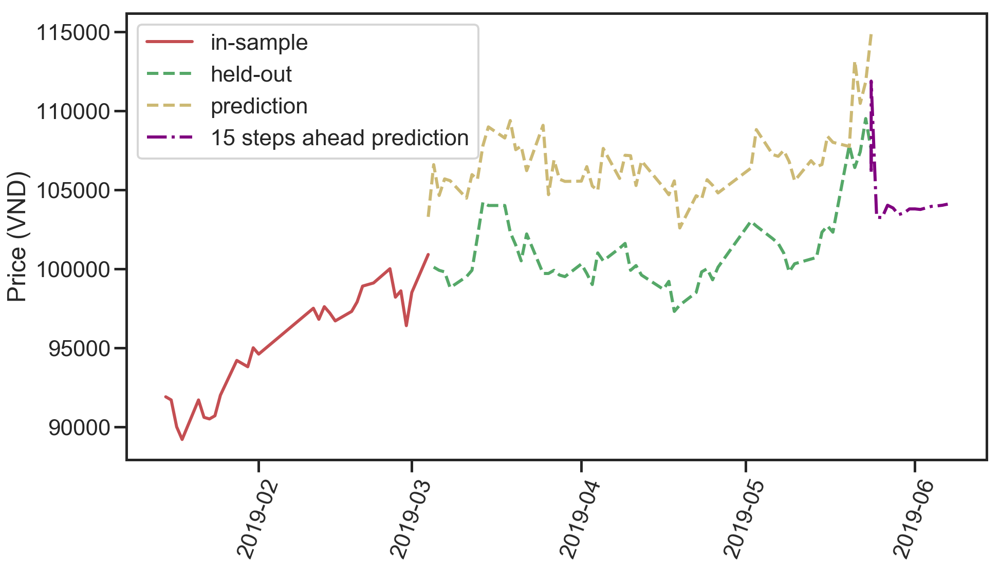

(3, 6, 2)
Testing result: {'mse': 33272201.902236257, 'rmse': 5768.206125151584, 'mae': 5567.4897293083495, 'mape': 5.521550107045316, 'lags': 3, 'hidden layers': (6, 2)}


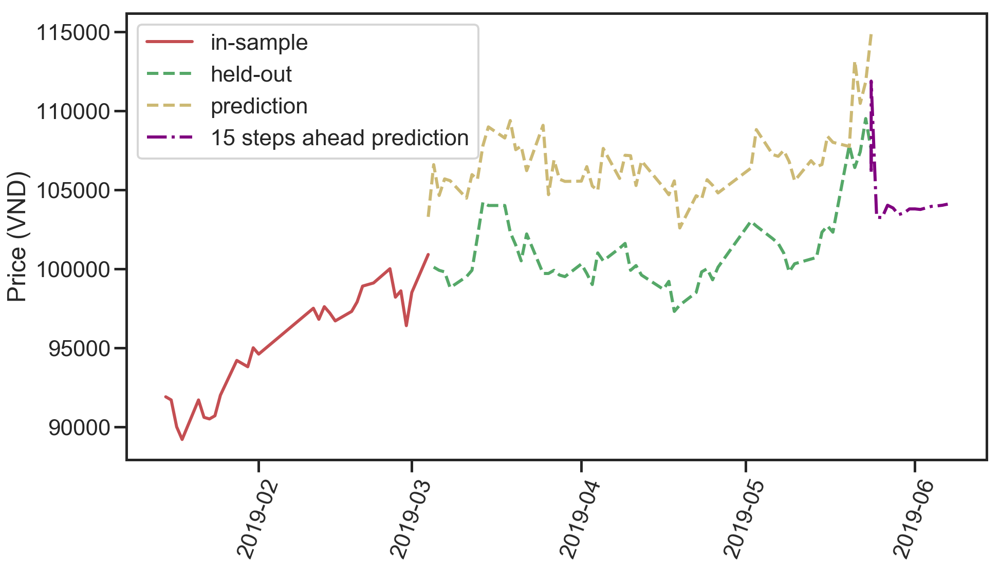

(3, 6, 3)
Testing result: {'mse': 10067977.412697783, 'rmse': 3173.0076288433, 'mae': 2942.5426415654324, 'mape': 2.92375599411644, 'lags': 3, 'hidden layers': (6, 3)}


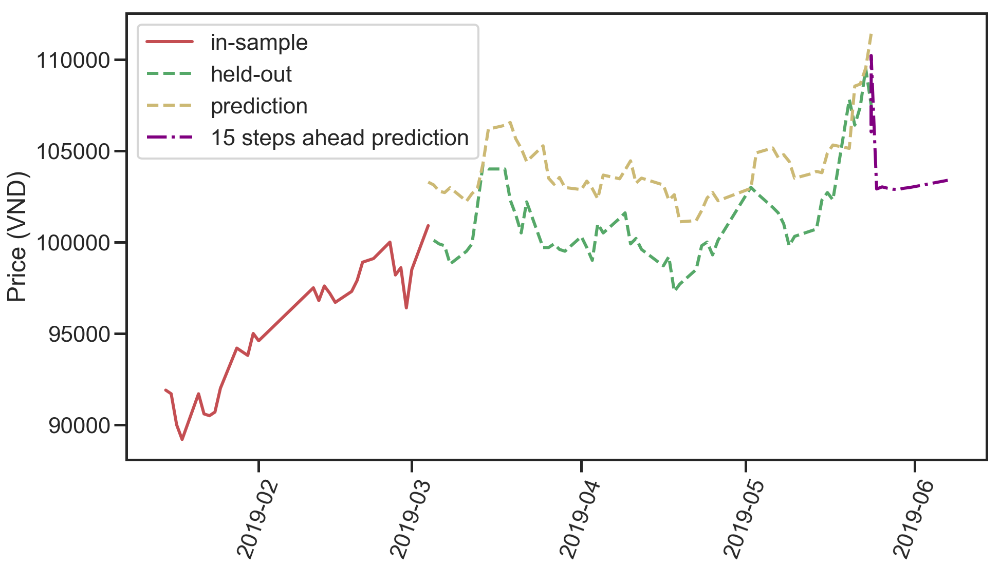

(3, 6, 3)
Testing result: {'mse': 10067977.412697783, 'rmse': 3173.0076288433, 'mae': 2942.5426415654324, 'mape': 2.92375599411644, 'lags': 3, 'hidden layers': (6, 3)}


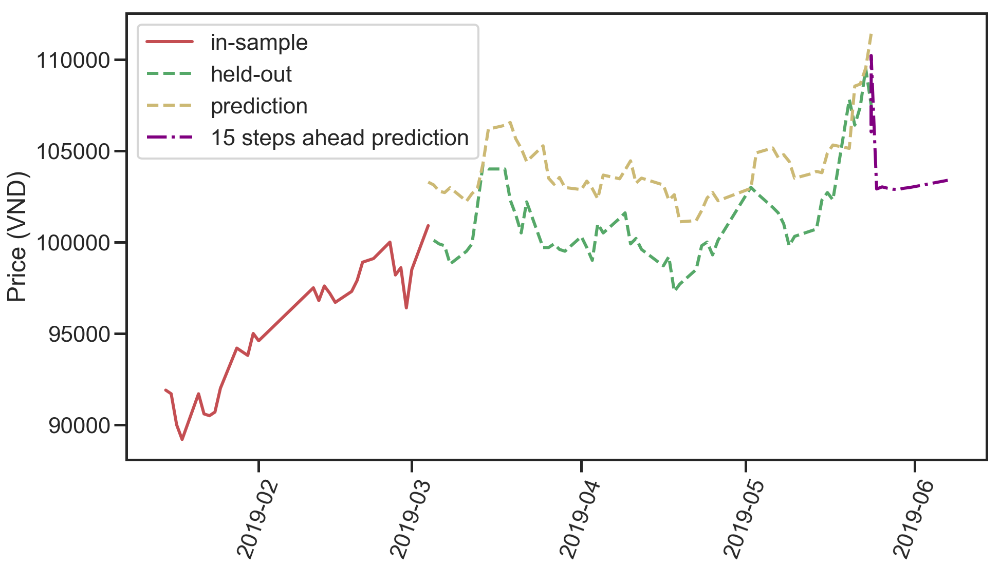

(3, 7, 1)
Testing result: {'mse': 7527533.244536389, 'rmse': 2743.635042154184, 'mae': 2537.6766674662335, 'mape': 2.514591650556835, 'lags': 3, 'hidden layers': (7, 1)}


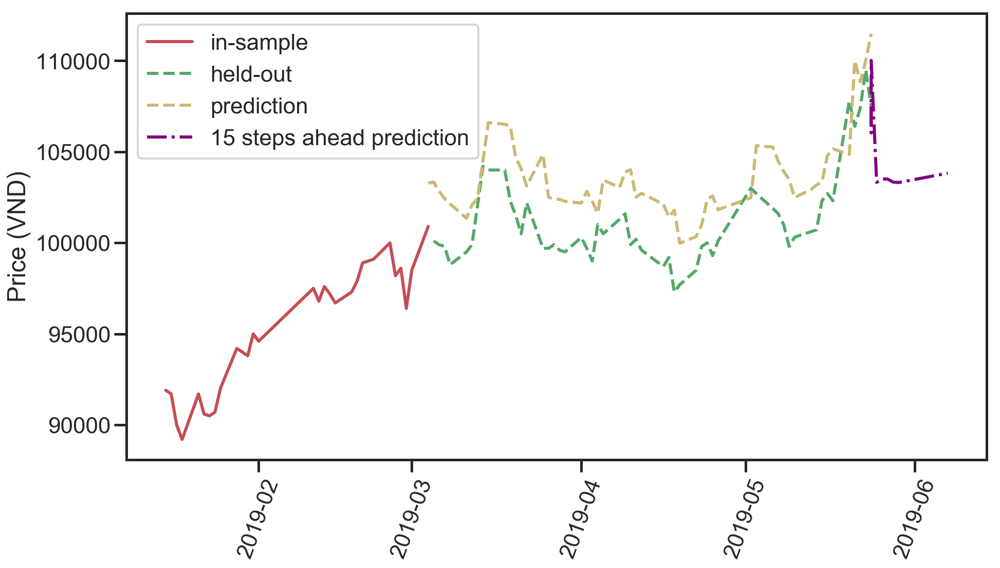

(3, 7, 2)
Testing result: {'mse': 12245104.01725604, 'rmse': 3499.300503994483, 'mae': 3162.195971421186, 'mape': 3.1371427708793873, 'lags': 3, 'hidden layers': (7, 2)}


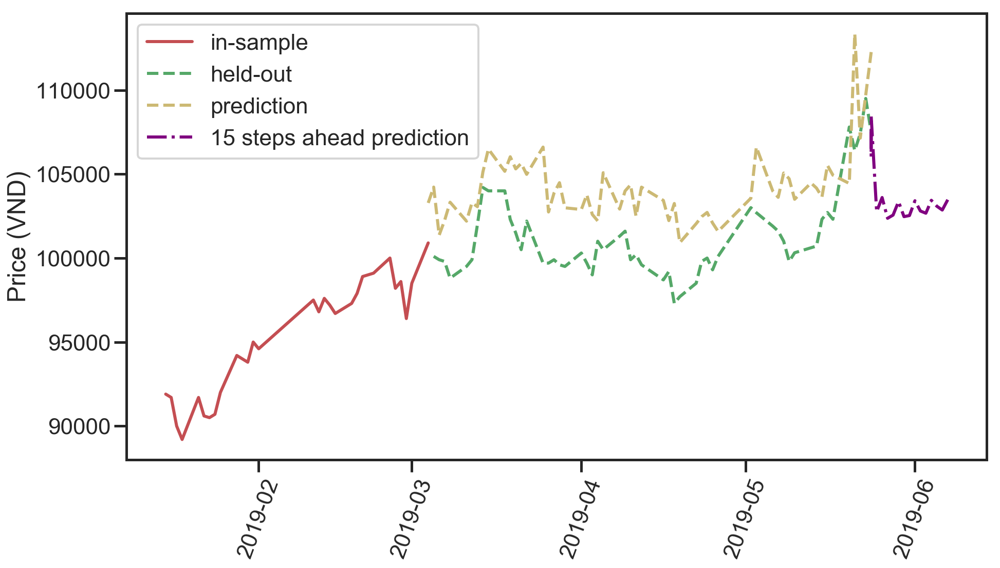

(3, 7, 2)
Testing result: {'mse': 12245104.01725604, 'rmse': 3499.300503994483, 'mae': 3162.195971421186, 'mape': 3.1371427708793873, 'lags': 3, 'hidden layers': (7, 2)}


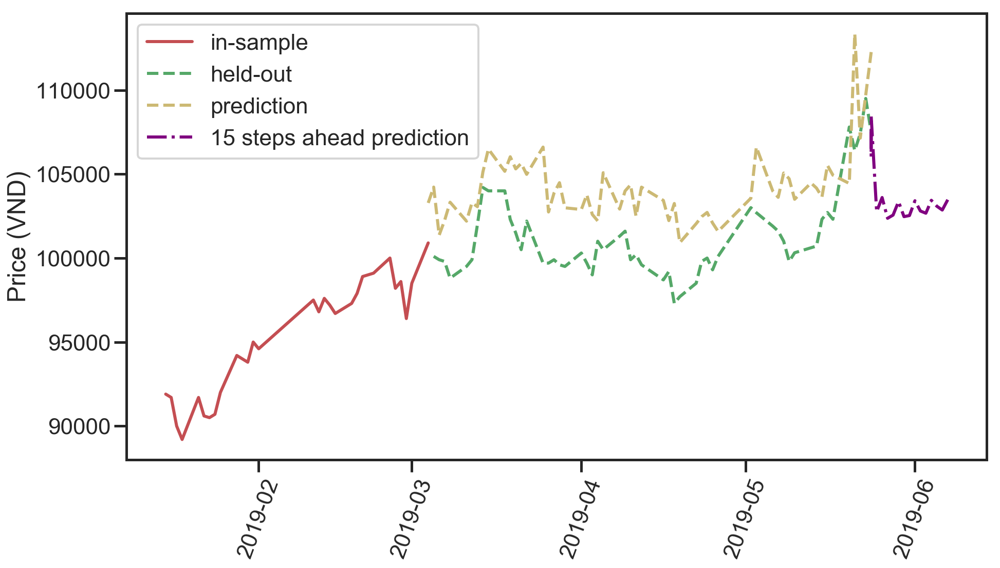

(3, 7, 3)
Testing result: {'mse': 4124691.095997245, 'rmse': 2030.9335528266909, 'mae': 1786.3428253605844, 'mape': 1.768435693813394, 'lags': 3, 'hidden layers': (7, 3)}


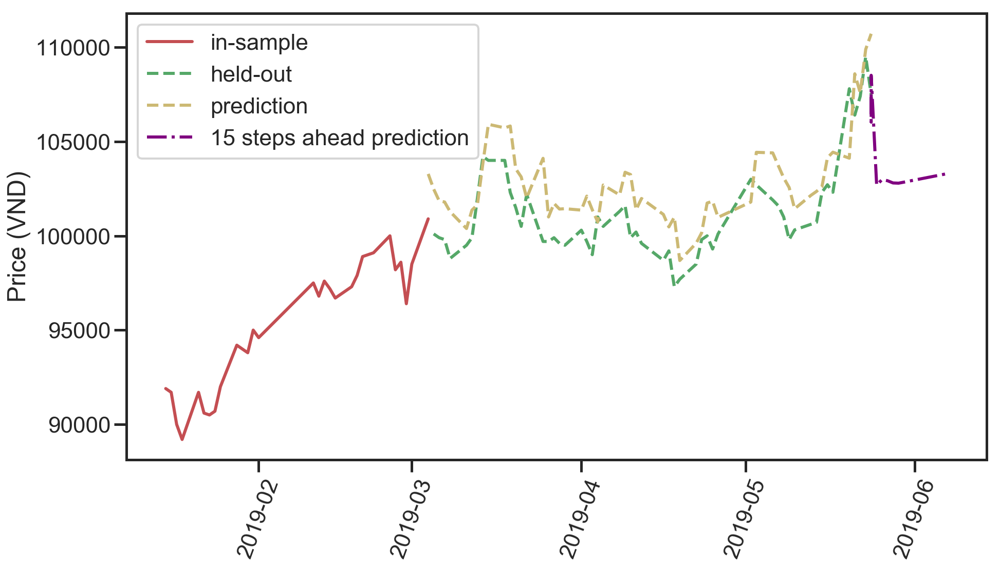

(3, 7, 3)
Testing result: {'mse': 4124691.095997245, 'rmse': 2030.9335528266909, 'mae': 1786.3428253605844, 'mape': 1.768435693813394, 'lags': 3, 'hidden layers': (7, 3)}


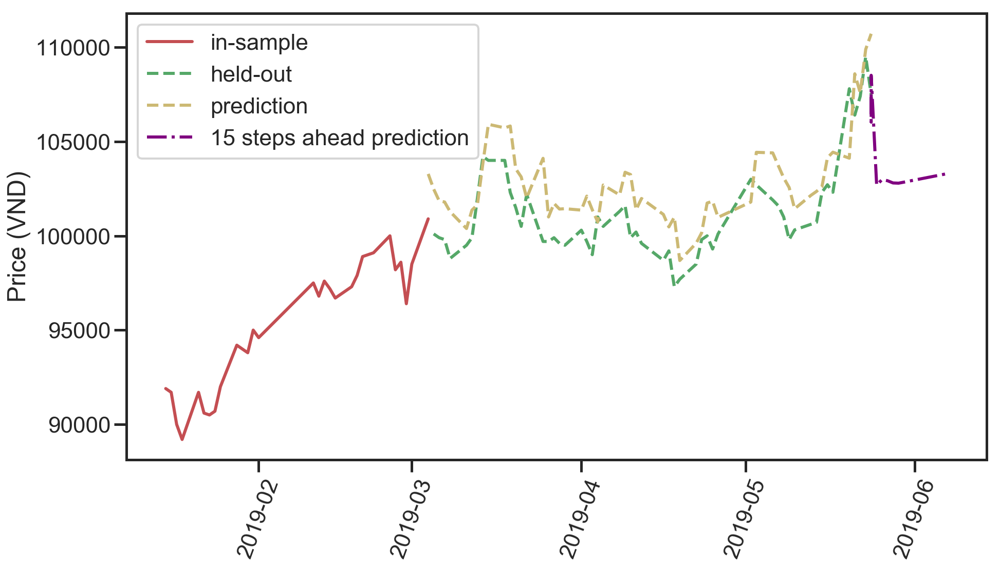

In [47]:
lags = range(1,4)
hl = range(3,8)
lst_ann_param = gen_ann(lags, hl)
order = (1,0,5)
lst_result = []
print(ticket)
for ann_param in lst_ann_param:
    print(ann_param)
    result = run_model_with_parameters(train, test, model_selection='Hybrid', order=order,
                                       lag=ann_param[0], hidden_layers=ann_param[1:])
    time.sleep(1)
    if result['status']:
        _result = result['test_evaluation']
        _result['lags'] = ann_param[0]
        _result['hidden layers'] = ann_param[1:]
        lst_result.append(_result)
        print('Testing result:', result['test_evaluation'])
        validation = result['model'].validate(test)
        predict_ahead = result['model'].predict_multi_step_ahead(start=test.index[-1], steps=15)
        fig, ax1 = plt.subplots(nrows=1, ncols=1, figsize=(15, 8))
        ax1.plot(train[-30:], label='in-sample', color='r', linestyle='-')
        ax1.plot(test, label='held-out', color='g', linestyle='--')
        ax1.plot(validation, label='predicted held-out', color='y', linestyle='--')
        ax1.plot(predict_ahead, label='15 steps ahead prediction', color='purple', linestyle='-.')
        plt.xticks(rotation=70)
        plt.ylabel('Price (VND)')
        plt.legend(['in-sample','held-out', 'prediction', '15 steps ahead prediction'])
#         plt.title('Model evaluation of ' + ticket)
        plt.show()
    else:
        print('None')

In [48]:
df_result = pd.DataFrame(data=lst_result)
df_result = df_result.drop_duplicates(['lags','hidden layers'], keep='first')
df_result = df_result.set_index(['lags', 'hidden layers'])
lst_metric = ['mae','mape','mse','rmse']
df_result = df_result[lst_metric].round(3)
df_result.to_csv('pnj_hybrid_result.csv', index=True)
df_result

mae    mape            mse       rmse
lags hidden layers                                             
1    (3, 1)        2428.92500 2.40700  6954875.29300 2637.21000
     (3, 2)        2625.55700 2.60500  7996172.61400 2827.75000
     (3, 3)        1927.53900 1.90500  4986832.70700 2233.12200
     (4, 1)        4309.22400 4.24900 20558899.57300 4534.19200
     (4, 2)        2430.95400 2.41000  6977066.70700 2641.41400
     (4, 3)        1396.41200 1.37300  3183248.59000 1784.16600
     (5, 1)        2513.40300 2.49300  7356837.76700 2712.34900
     (5, 2)        2533.65900 2.51200  7524859.43300 2743.14800
     (5, 3)        2841.04700 2.82100  9306704.52800 3050.68900
     (6, 1)        4432.33600 4.40400 22463648.20600 4739.58300
     (6, 2)        2308.39000 2.27300  7671775.75500 2769.79700
     (6, 3)        1662.99100 1.64300  3761552.64700 1939.47200
     (7, 1)        2335.47100 2.31600  6463708.28500 2542.38200
     (7, 2)        6494.61600 6.44400 45002939.61800 6708.42300
     (7, 3)        2313.61200 2.29300  6406960.57600 2531.19700
2    (3, 1)        5575.13400 5.49500 32907918.44300 5736.54200
     (3, 2)        1498.94500 1.48400  3281632.64000 1811.52800
     (3, 3)        3112.77600 3.09300 11264702.85300 3356.29300
     (4, 1)        2398.51700 2.36400  7710269.57200 2776.73700
     (4, 2)        4770.59900 4.73900 25658055.98900 5065.37800
     (4, 3)        4246.54800 4.18700 19979630.04900 4469.85800
     (5, 1)        2009.03800 1.98900  5255382.08900 2292.46200
     (5, 2)        2542.78100 2.52100  7626750.27600 2761.65700
     (5, 3)        2377.44900 2.35700  6679201.56900 2584.41500
     (6, 1)        1506.72800 1.48700  3014170.94900 1736.13700
     (6, 2)        1619.68300 1.59700  4043170.32400 2010.76400
     (6, 3)        1718.07400 1.69600  3830762.64600 1957.23300
     (7, 1)        5492.41600 5.43300 34330863.00300 5859.25400
     (7, 2)        1615.97200 1.59000  3747260.06000 1935.78400
     (7, 3)        2198.32600 2.18000  5936447.95000 2436.48300
3    (3, 1)        2862.40400 2.84100  9383035.19300 3063.17400
     (3, 2)        1793.23400 1.75400  5180532.76000 2276.07800
     (3, 3)        1956.26600 1.92200  5565910.90900 2359.21800
     (4, 1)        1610.84500 1.58300  4133167.41000 2033.01900
     (4, 2)        1740.92900 1.71200  4499351.01800 2121.16700
     (4, 3)        3665.59300 3.64200 15400226.12300 3924.31200
     (5, 1)        4539.56800 4.49600 25776332.68200 5077.04000
     (5, 2)        2615.40400 2.59300  8031207.27300 2833.93800
     (5, 3)        4351.78100 4.31400 20865205.35000 4567.84500
     (6, 1)        7443.73700 7.37300 57164192.06400 7560.70100
     (6, 2)        5567.49000 5.52200 33272201.90200 5768.20600
     (6, 3)        2942.54300 2.92400 10067977.41300 3173.00800
     (7, 1)        2537.67700 2.51500  7527533.24500 2743.63500
     (7, 2)        3162.19600 3.13700 12245104.01700 3499.30100
     (7, 3)        1786.34300 1.76800  4124691.09600 2030.93400

In [18]:
# mbb = df[df.ticket == 'MBB']['close']

# # split data
# mbb = mbb.sort_index()
# size = len(mbb)
# train_start = int(start_train * size)
# train_end = int(end_train * size)
# train, test = mbb[train_start:train_end], mbb[train_end:]

Run model LSTM
Training drift...
Done.
Training volatility...
Done.
DPM
Testing result: {'mse': 106337.40766807474, 'rmse': 326.09416993879967, 'mae': 241.4408218359678, 'mape': 1.2838447424355404}


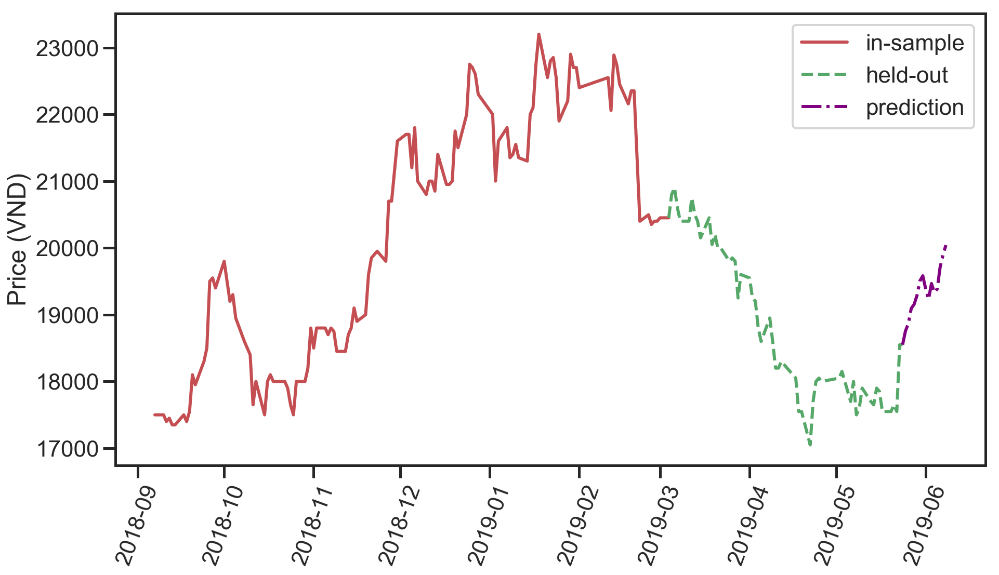

In [15]:
result = run_model_with_parameters(train, test, model_selection='LSTM_GBM', window_size=10, lag=10)
print(ticket)
validation = result['model'].validate(test)
insample_prediction = result['model'].get_insample_prediction()
predict_ahead = result['model'].predict_multi_step_ahead(start=test.index[-1], steps=15)
time.sleep(1)

df_drift = result['drift_validation']
df_volatility = result['volatility_validation']

# print('Training result:', result['train_evaluation'])
print('Testing result:', result['test_evaluation'])

fig, ax1 = plt.subplots(nrows=1, ncols=1, figsize=(15, 8))
ax1.plot(train[-120:], label='in-sample', color='r', linestyle='-')
ax1.plot(train[-1:].append(test), label='held-out', color='g', linestyle='--')
# ax1.plot(validation, label='predicted held-out', color='y', linestyle='--')
ax1.plot(predict_ahead, label='15 steps ahead prediction', color='purple', linestyle='-.')
plt.xticks(rotation=70)
plt.ylabel('Price (VND)')
plt.legend(['in-sample','held-out', 'prediction','15 steps ahead prediction'])
# plt.title('Model evaluation of ' + ticket)
plt.show()

{'mse': 3.0146959716171343e-05, 'rmse': 0.005490624710920548, 'mae': 0.0048653325167667535, 'mape': 437.97344812016246}


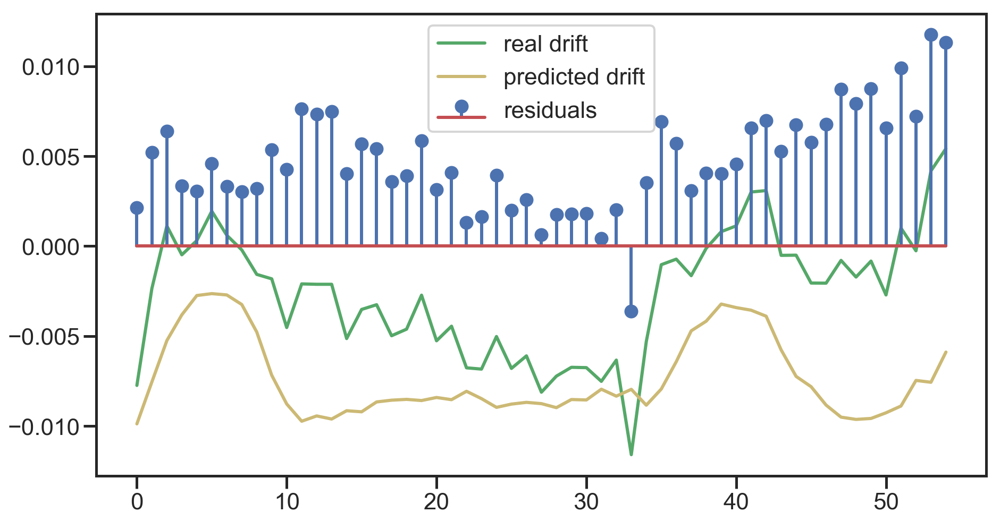

In [66]:
result_drift = evaluation(df_drift)
print(result_drift)
plt.figure(figsize=(15, 8))
plt.plot(df_drift['y'], color='g')
plt.plot(df_drift['yhat'], color='y')
plt.stem(df_drift['y'] - df_drift['yhat'])
plt.legend(['real drift', 'predicted drift', 'residuals'])
# plt.title('Drift evaluation')
plt.show()

{'mse': 1.2164966763285824e-05, 'rmse': 0.003487831240654545, 'mae': 0.00264415873225578, 'mape': 19.13042917354867}


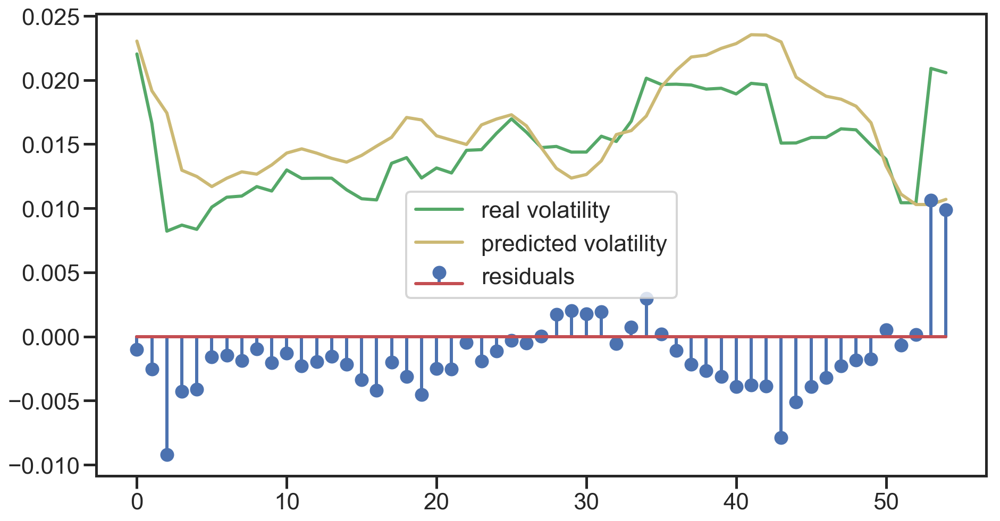

In [67]:
result_volatility = evaluation(df_volatility)
print(result_volatility)
plt.figure(figsize=(15, 8))
plt.plot(df_volatility['y'], color='g')
plt.plot(df_volatility['yhat'], color='y')
plt.stem(df_volatility['y'] - df_volatility['yhat'])
plt.legend(['real volatility', 'predicted volatility', 'residuals'])
# plt.title('Volatility evaluation')
plt.show()